# Setup

In [ ]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
random_seed = 1998
#np.random.seed(0)

# Remove warnings (was becoming a problem when getting a cuDNN warning whenever training a new network)
! pip install silence-tensorflow
from silence_tensorflow import silence_tensorflow
silence_tensorflow()

# Importing Data

In [ ]:
data = pd.read_csv("/content/drive/Shared drives/Usable Passwords COMPS/Online Dataset Testing/DSL-StrongPasswordData.csv")
data = data[data.columns[:-3]] # Removing the return key from the recorded input (I think this might be too variable and we should not require a return key for the password. e.g. the person clicks "submit" button)
data = data[data.columns[:-1]] # Removing last hold key because no corresponding UD time
columns_to_drop = [i for i in data.columns if "DD." in i]
columns_to_keep = data.columns.drop(columns_to_drop)
data = data[columns_to_keep]
individuals = data["subject"].unique()

survey_data = pd.read_csv("/content/drive/Shareddrives/Usable Passwords COMPS/SurveyData/Survey_A.csv")
survey_data = survey_data[survey_data.columns[:-1]] # Removing last hold key because no corresponding UD time

# Plotting Digraph Distributions

plotting distributions


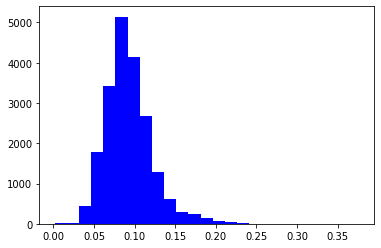

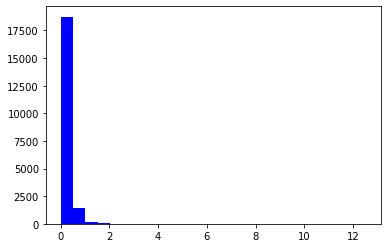

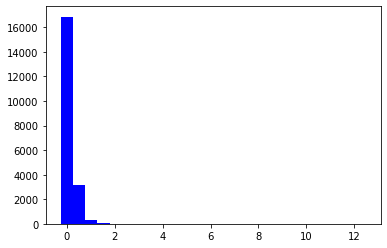

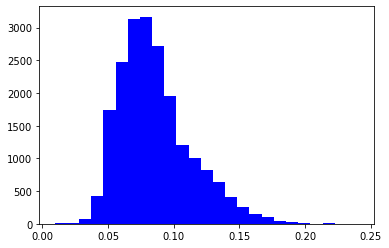

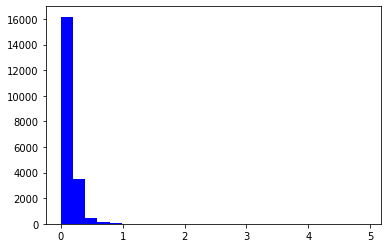

...

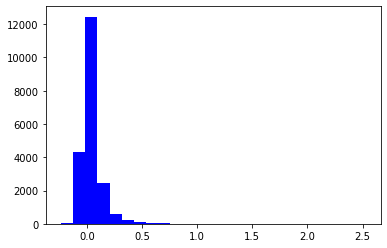

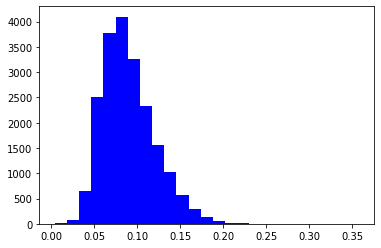

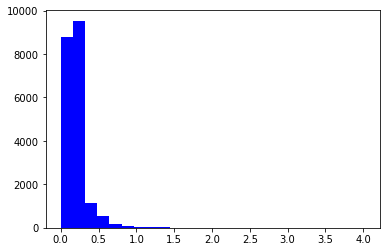

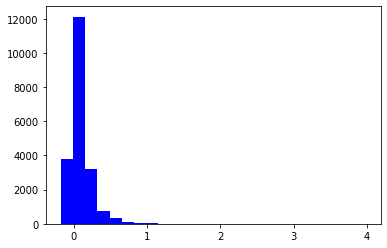

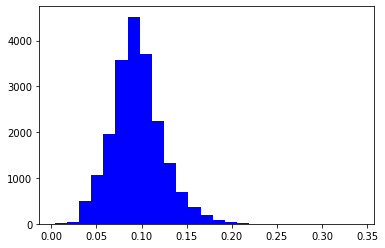







plotting log scaled distributions


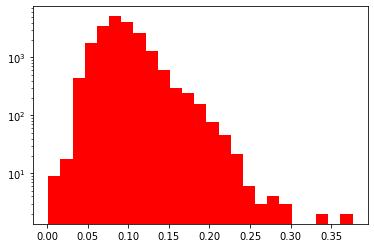

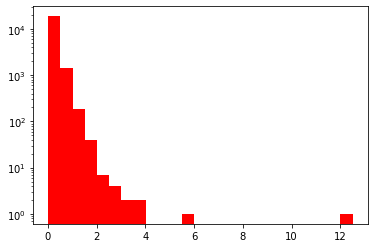

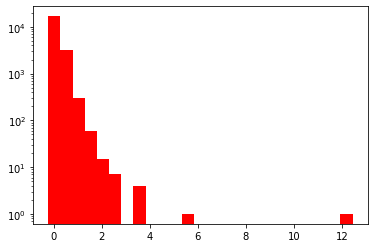

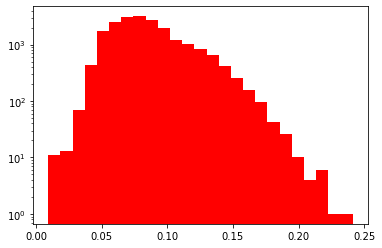

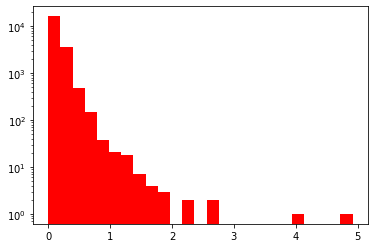

...

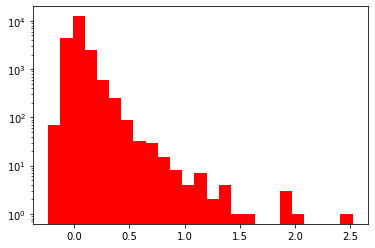

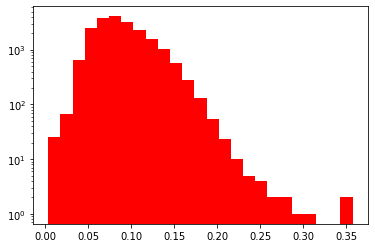

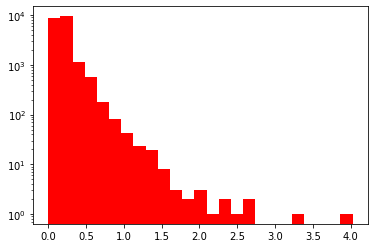

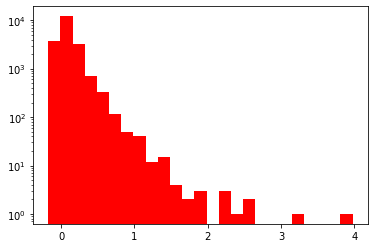

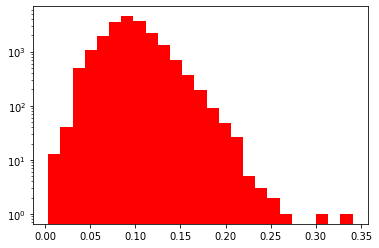

In [ ]:
print("plotting distributions")
for digraph in data.columns[3:]:
  instances = data[digraph]
  plt.hist(instances, bins=25, color="blue")
  plt.show()

print("\n" * 5)
print("plotting log scaled distributions")
for digraph in data.columns[3:]:
  instances = data[digraph]
  plt.hist(instances, bins=25, log=True, color="red")
  plt.show()

# RNN Functions

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten, Lambda
from keras.utils import np_utils, to_categorical
from sklearn.metrics import classification_report, confusion_matrix
import tensorflow as tf

from keras.datasets import imdb
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM, GRU
from keras.layers.embeddings import Embedding
from keras.preprocessing import sequence
from sklearn.metrics import classification_report, confusion_matrix
# fix random seed for reproducibility
np.random.seed(7)

In [ ]:
def assign_names_to_numbers(df):
  count = 0
  name_list = list(set(df))
  name_list.sort()
  for i in name_list:
    indexes = (df == i)
    df.loc[indexes] = count
    count += 1
  return df

In [ ]:
def concat_and_randomize_data(df_list):
  df_list = pd.concat(df_list)
  df_list = df_list.sample(frac=1, random_state = random_seed)
  df_list.reset_index(inplace=True, drop=True)
  return df_list

In [ ]:
def binary_classification(df, loo_user):
  for i in list(set(df)):
    indexes = (df == i)
    if i == loo_user:
      df.loc[indexes] = 1
    else:
      df.loc[indexes] = 0
  return df

In [ ]:
# Use a normal distribution between the min and max ranges possible for each digraph to generate random attacks
def generate_potential_attacks(digraph_database, digraph_progression, num_samples):
  # create a avg-stdv value dictionary to determine normal distribution of all known digraph values
  digraph_length_dict = {}
  for digraph in digraph_progression.columns:
    digraph_length_dict[digraph] = [digraph_database[digraph].mean(), digraph_database[digraph].std()]

  random_sample_dict = {}
  random_sample_dict["subject"] = ["fake" for i in range(num_samples)]
  random_sample_dict["sessionIndex"] = [1 for i in range(num_samples)]
  random_sample_dict["rep"] = [1 for i in range(num_samples)]
  for digraph in digraph_progression.columns:
    n_random_samples = np.random.normal(loc=digraph_length_dict[digraph][0], scale=digraph_length_dict[digraph][1], size=num_samples) # mean, stdv, output_size
    random_sample_dict[digraph] = n_random_samples

  return pd.DataFrame(random_sample_dict)

In [ ]:
from scipy.stats import lognorm
# Use a log-normal distribution between the min and max ranges possible for each digraph to generate random attacks
def generate_lognormal_attacks(digraph_database, digraph_progression, num_samples, verbose=False, user_id="fake"):
  # create a avg-stdv value dictionary to determine normal distribution of all known digraph values
  digraph_length_dict = {}
  for digraph in digraph_progression.columns:
    digraph_length_dict[digraph] = lognorm.fit(digraph_database[digraph]) #shape, loc, scale

  random_sample_dict = {}
  random_sample_dict["subject"] = [user_id for i in range(num_samples)]
  random_sample_dict["sessionIndex"] = [1 for i in range(num_samples)]
  random_sample_dict["rep"] = [1 for i in range(num_samples)]
  for digraph in digraph_progression.columns:
    rand_generated_digraph = lognorm(digraph_length_dict[digraph][0],digraph_length_dict[digraph][1],digraph_length_dict[digraph][2]).rvs(size=num_samples) # sample
    random_sample_dict[digraph] = rand_generated_digraph
    
    if verbose:
      plt.hist(digraph_database[digraph], bins=25, label="real digraph distribution")
      plt.hist(rand_generated_digraph, bins=25, label="generated digraph distribution")
      plt.legend()
      plt.title(digraph)
      plt.show()

  return pd.DataFrame(random_sample_dict)

In [ ]:
matrix_representation_dictionary = {'a':0, 'b':1, 'c':2,
                                    'd':3, 'e':4, 'f':5,
                                    'g':6, 'h':7, 'i':8,
                                    'j':9, 'k':10, 'l':11,
                                    'm':12, 'n':13, 'o':14,
                                    'p':15, 'q':16, 'r':17,
                                    's':18, 't':19, 'u':20,
                                    'v':21, 'w':22, 'x':23,
                                    'y':26, 'z':25, 'period': 26,
                                    'five': 27}
def reshape_to(time_array, keystroke_list):
  first_encoding = [0 for i in range(len(matrix_representation_dictionary))]
  second_encoding = [0 for i in range(len(matrix_representation_dictionary) * len(matrix_representation_dictionary))]
  hold_keystroke = keystroke_list[0].split(".")
  if "Shift" in hold_keystroke:
    hold_keystroke.remove("Shift")
  flight_time_keystroke = keystroke_list[1].split(".")
  if "Shift" in flight_time_keystroke:
    flight_time_keystroke.remove("Shift")
  first_encoding[matrix_representation_dictionary[hold_keystroke[1]]] = time_array[0]
  second_encoding[matrix_representation_dictionary[flight_time_keystroke[1]] * len(matrix_representation_dictionary) + matrix_representation_dictionary[flight_time_keystroke[2]]] = time_array[1]
  return np.array(first_encoding + second_encoding)

In [ ]:
def convert_to_matrix_representation(X_train): 
  output_array = np.empty([len(X_train), 9, 812])
  keystrokes = X_train.columns
  X_train = X_train.to_numpy().reshape((len(X_train), 9, 2))
  for sample in range(len(X_train)):
    for i in range(0, len(keystrokes), 2):
      output_array[sample, int(i/2)] = reshape_to(X_train[sample, int(i/2)], [keystrokes[i],keystrokes[i+1]])
  return output_array

In [ ]:
# fit and evaluate a model
def generate_model(trainX, trainy):#, testX, testy):
  verbose, epochs, batch_size = 1, 200, 32
  n_timesteps, n_features, n_outputs = trainX.shape[1], trainX.shape[2], trainy.shape[1]
  model = Sequential()
  model.add(LSTM(25, input_shape=(9,2)))
  model.add(Dropout(0.3))
  model.add(Dense(100, activation='relu'))
  model.add(Dense(n_outputs, activation='softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  # fit network
  model.fit(trainX, trainy, epochs=epochs, validation_split=0.2, batch_size=batch_size, verbose=verbose)
  model.summary()
  return model

# LSTM with early stopping

In [ ]:
from keras.layers import BatchNormalization

# fit and evaluate an LSTM model
def generate_lstm_model(trainX, trainy, verbose=0):
  epochs, batch_size = 100, 64
  n_outputs = trainy.shape[1]
  callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
  model = Sequential()
  model.add(BatchNormalization(name="normalization_layer")) # each input becomes relative to other inputs of given batch
  model.add(LSTM(75, input_shape=(9,812), dropout = 0.3, recurrent_dropout=0.3, name="lstm_layer"))
  model.add(Dropout(0.3))
  model.add(Dense(150, activation='relu', name="dense_intermediate"))
  model.add(Dropout(0.3))
  model.add(Dense(n_outputs, activation='softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  # fit network
  history = model.fit(trainX, trainy, epochs=epochs, validation_split=0.2, batch_size=batch_size, callbacks=[callback], verbose=verbose)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  if verbose == 1:
    model.summary()
  return model

In [ ]:
# Learning better noise to add in each column
def find_column_stdvs(df, sigma_factor):
  sigma_dict = {}
  for column in df.columns[3:]:
    sigma_dict[column] = df[column].std() / sigma_factor
  return sigma_dict

In [ ]:
from sklearn.manifold import TSNE
import umap

def plot_embeddings(results, labels):
  # TSNE
  tsne = TSNE()
  tsne_results = tsne.fit_transform(results)

  tsne_1 = tsne_results[:,0]
  tsne_2 = tsne_results[:,1]
  plt.figure(figsize=(10,6))
  plt.scatter(tsne_1, tsne_2, c = labels, cmap = "Set1")
  plt.title("TSNE of all users")
  plt.show()

In [ ]:
def test_lstm_on_user(loo_user, threshold_progression, human_attacks=True, verbose=0):
  initial_train_data = []
  loo_retrain_data = []
  loo_test_data = []

  num_samples_to_train_on = 10
  non_loo_users = individuals[individuals != loo_user]
  # randomize non_loo_users order
  random.shuffle(non_loo_users)
  train_non_loo_users = non_loo_users[:int(len(non_loo_users)/2)]
  test_non_loo_users = non_loo_users[int(len(non_loo_users)/2):]

  for user in individuals:
    if user == loo_user:
      data_randomized_user = data.loc[data["subject"] == user]
      data_randomized_user.reset_index(inplace=True, drop=True)
      true_retrain_data = data_randomized_user.loc[:num_samples_to_train_on - 1]
      loo_retrain_data.append(true_retrain_data)
      sigma_factor = 100
      sigma_dict = find_column_stdvs(true_retrain_data, sigma_factor)
      for i in range(999):
        # Adding noise when upsampling
        # creating a noise with the same dimension as the dataset (2,2) 
        upsampled = true_retrain_data.copy()
        for column in true_retrain_data.columns[3:]:
          noise = np.random.normal(0, sigma_dict[column], [len(upsampled)]) 
          upsampled[column] = upsampled[column] + noise
        loo_retrain_data.append(upsampled)

      if not human_attacks:
        # Addding randomly generated data
        loo_retrain_data.append(generate_lognormal_attacks(data[data.columns[3:]], true_retrain_data[true_retrain_data.columns[3:]], 1000*10))

      loo_test_data.append(data_randomized_user.loc[num_samples_to_train_on:].sample(frac=1, random_state = random_seed))
    if user in train_non_loo_users:
      data_randomized_user = data.loc[data["subject"] == user].sample(frac=1, random_state = random_seed)
      data_randomized_user.reset_index(inplace=True, drop=True)
      initial_train_data.append(data_randomized_user)
      if human_attacks:
        loo_retrain_data.append(data_randomized_user)
    if user in test_non_loo_users:
      data_randomized_user = data.loc[data["subject"] == user].sample(frac=1, random_state = random_seed)
      data_randomized_user.reset_index(inplace=True, drop=True)
      loo_test_data.append(data_randomized_user)

  # plotting train vs true user
  data_subset = data[(data["subject"].isin(train_non_loo_users)) | (data["subject"] == loo_user)].sample(frac=1, random_state = random_seed).copy()
  labels = (data_subset["subject"] == loo_user) * 1
  plot_embeddings(data_subset[data_subset.columns[3:]], labels)

  # plotting test vs true user
  data_subset = data[(data["subject"].isin(test_non_loo_users)) | (data["subject"] == loo_user)].sample(frac=1, random_state = random_seed).copy()
  labels = (data_subset["subject"] == loo_user) * 1
  plot_embeddings(data_subset[data_subset.columns[3:]], labels)

  initial_train_data = concat_and_randomize_data(initial_train_data)
  print(initial_train_data.shape)

  loo_retrain_data = concat_and_randomize_data(loo_retrain_data)
  print(loo_retrain_data.shape)

  loo_test_data = concat_and_randomize_data(loo_test_data)
  print(loo_test_data.shape)

  X_train = initial_train_data[initial_train_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train)
  Y_train_encoded = assign_names_to_numbers(initial_train_data["subject"].copy())
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  print("X_train.shape", X_train.shape)
  print("Y_train_encoded.shape", Y_train_encoded.shape)

  model = generate_lstm_model(X_train, Y_train_encoded, verbose)

  # At this point, we have a trained model for known users

  X_train = loo_retrain_data[loo_retrain_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train) 
  Y_train_encoded = binary_classification(loo_retrain_data["subject"].copy(), loo_user)
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  new_model_layers = model.layers[:-1]
  for layer in new_model_layers:
    layer.trainable = False
  new_model = Sequential(new_model_layers)
  new_model.add(Dense(2, activation='softmax'))

  new_model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

  new_model.fit(X_train, Y_train_encoded, 
            batch_size=64, epochs=10, verbose=verbose)
  if verbose == 1:
    new_model.summary()

  # We have now retrained the model for the new user against fake attempts

  X_test = loo_test_data[loo_test_data.columns[3:]]
  X_test = convert_to_matrix_representation(X_test) 
  Y_test_encoded = binary_classification(loo_test_data["subject"].copy(), loo_user)
  Y_test_encoded = Y_test_encoded.to_numpy()
  Y_test_encoded = to_categorical(Y_test_encoded)

  reals = np.argmax(Y_test_encoded, axis=1)
  predictions = new_model.predict(X_test)

  TAR_progression = []
  FAR_progression = []
  for threshold in threshold_progression:
    prediction_values = np.array([1 if predictions[i][1] > threshold else 0 for i in range(len(predictions))])

    # This is formatted as:
    # (true - rows, predicted - columns)
    # [[FR  FA]
    # [TR  TA]]
    
    conf_matrix = confusion_matrix(reals, prediction_values)
    TAR_progression.append(conf_matrix[1][1] / sum(conf_matrix[1]))
    FAR_progression.append(conf_matrix[0][1] / sum(conf_matrix[0]))
  return np.array(TAR_progression), np.array(FAR_progression)

s002


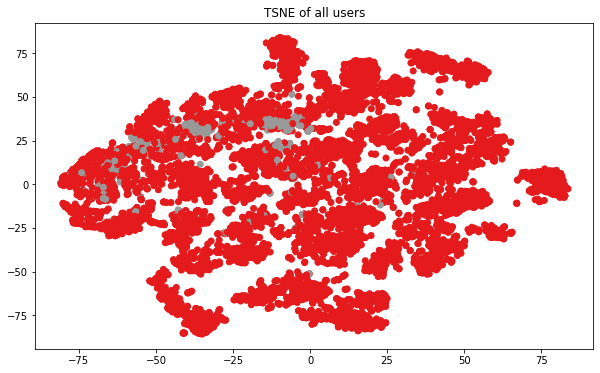

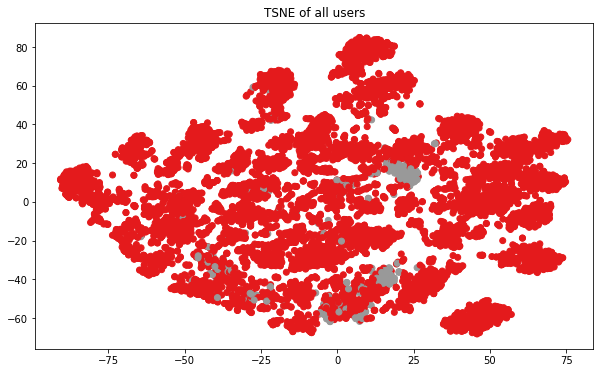

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


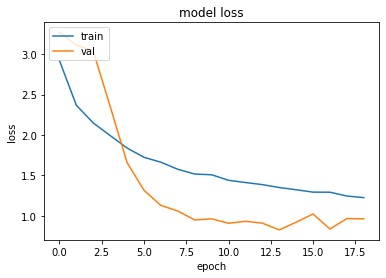

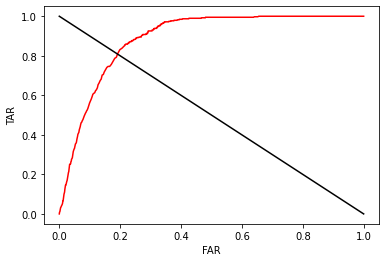

s003


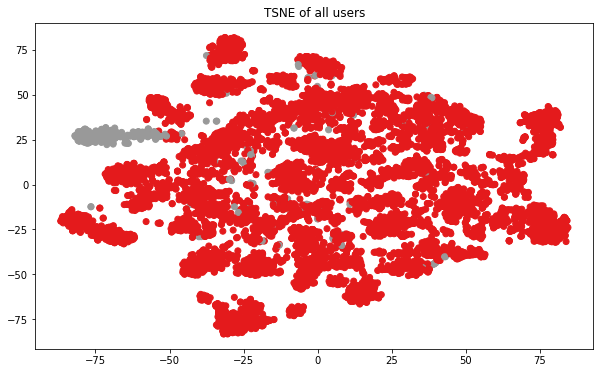

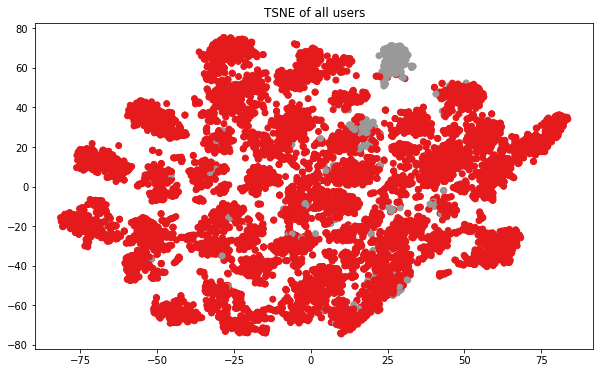

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


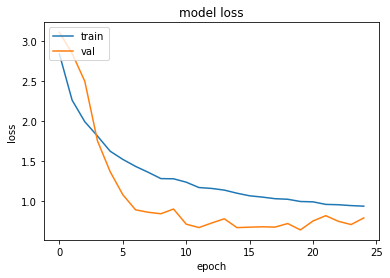

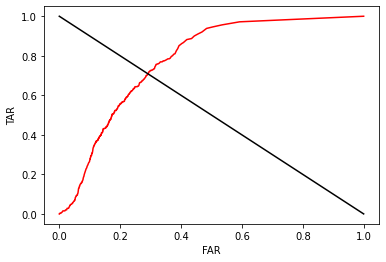

s004


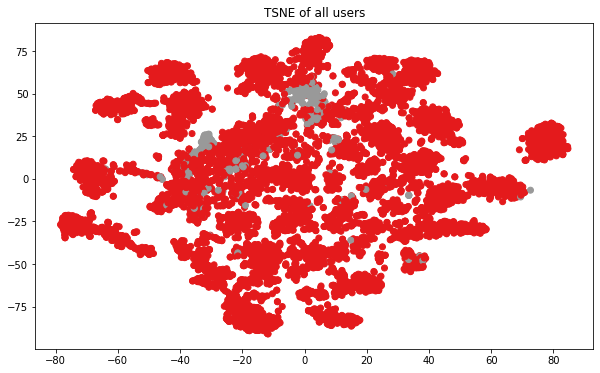

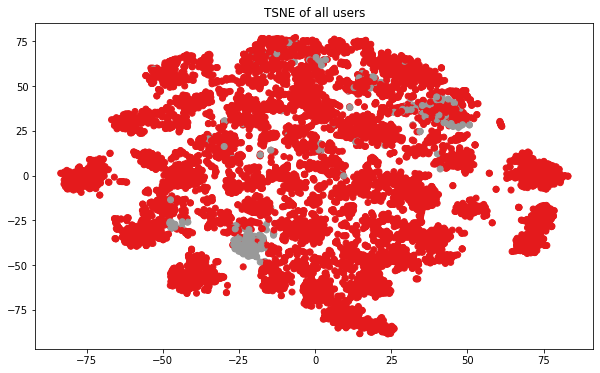

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


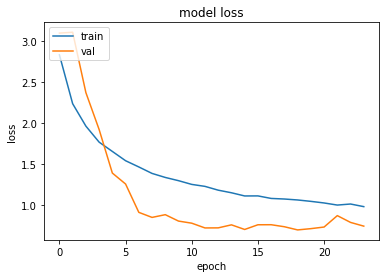

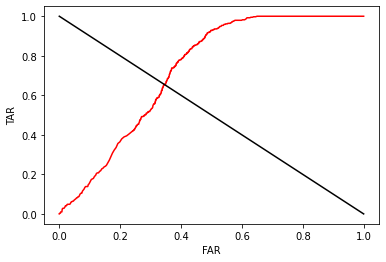

s005


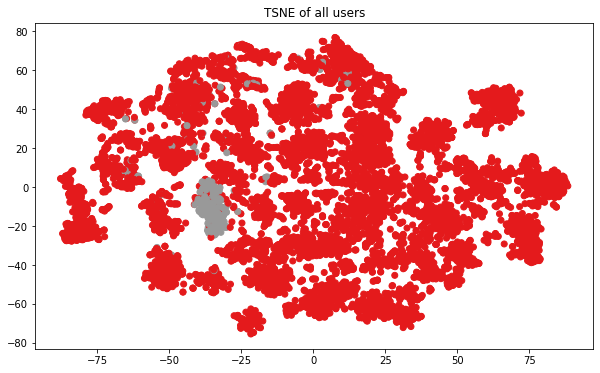

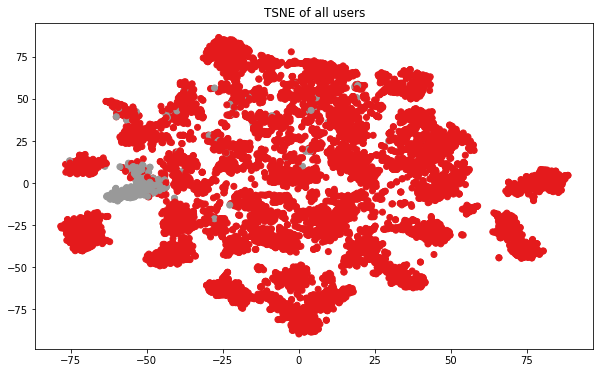

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


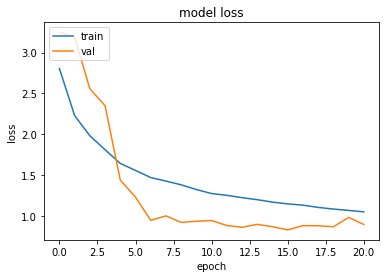

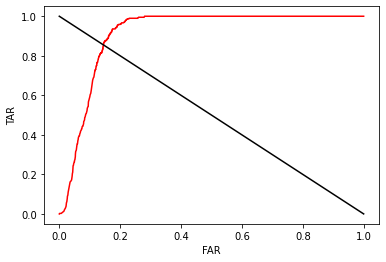

s007


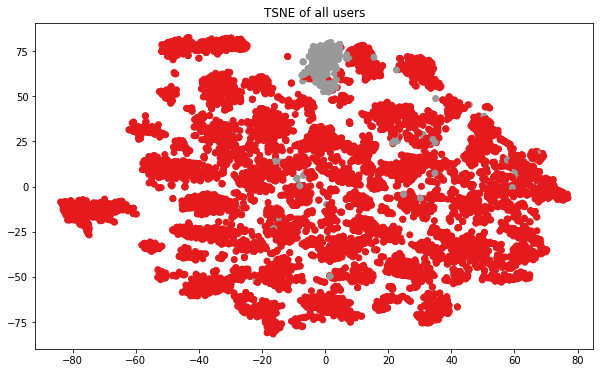

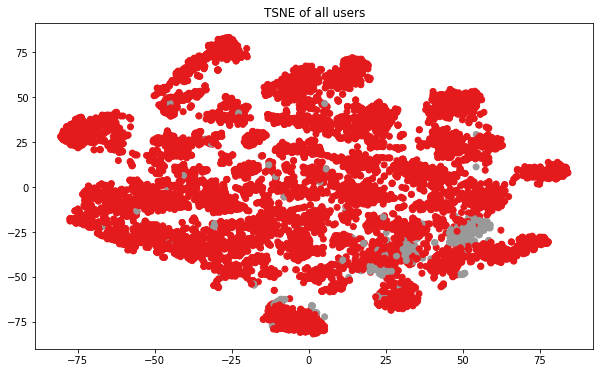

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


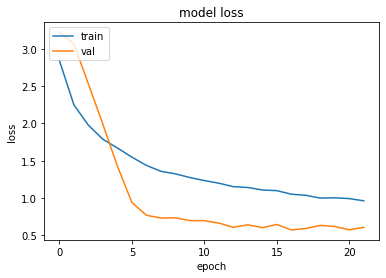

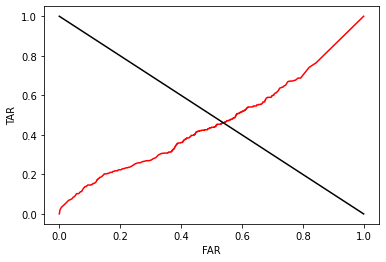

s008


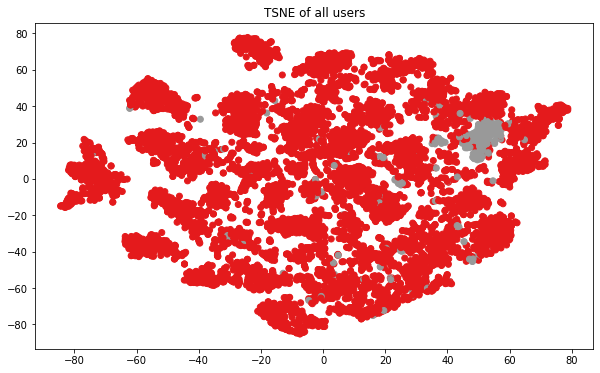

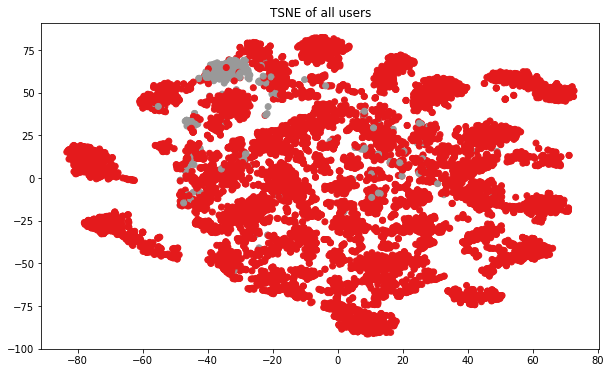

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


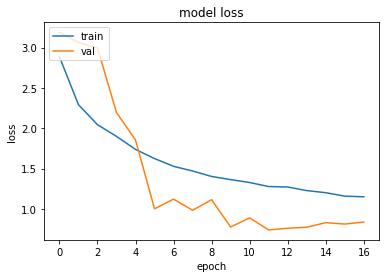

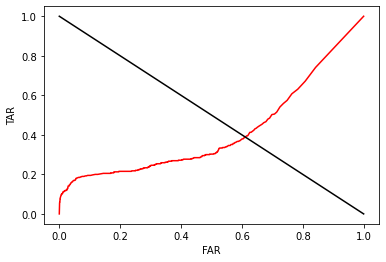

s010


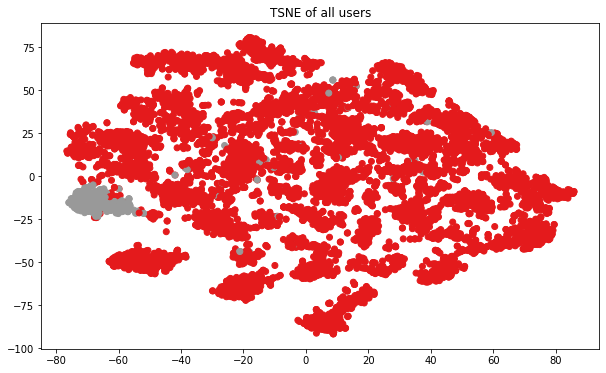

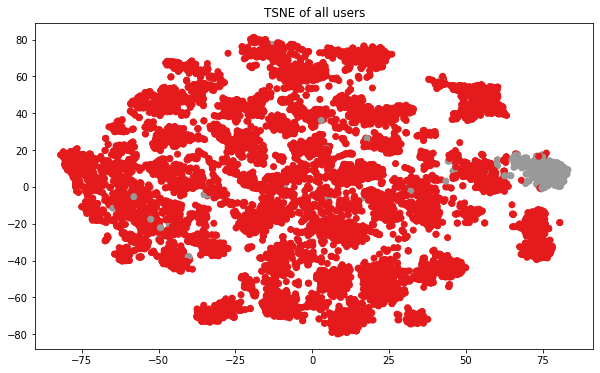

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


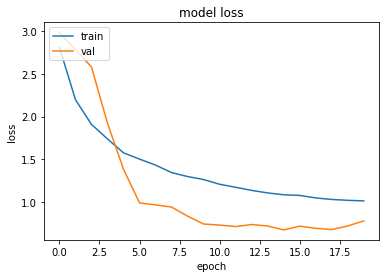

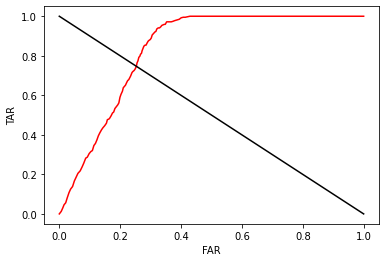

s011


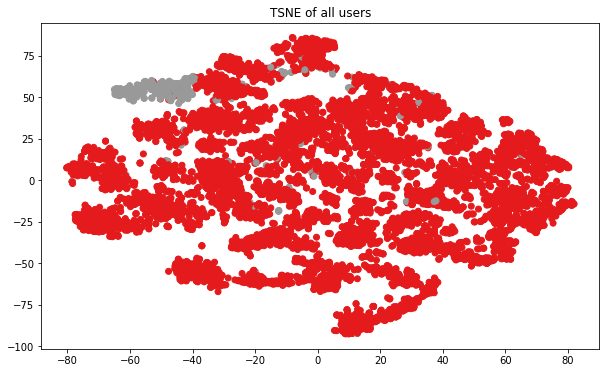

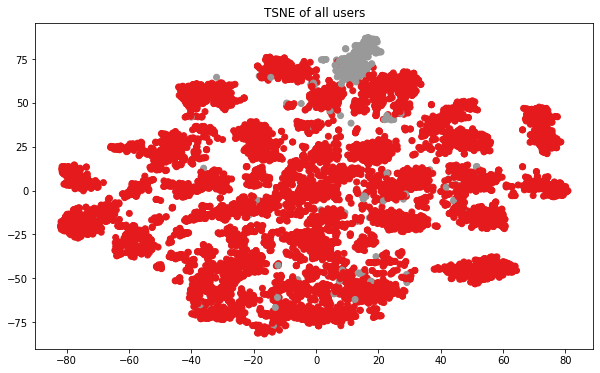

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


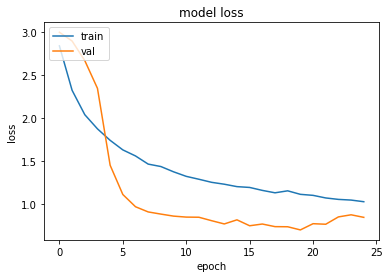

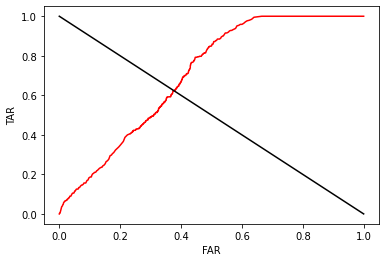

s012


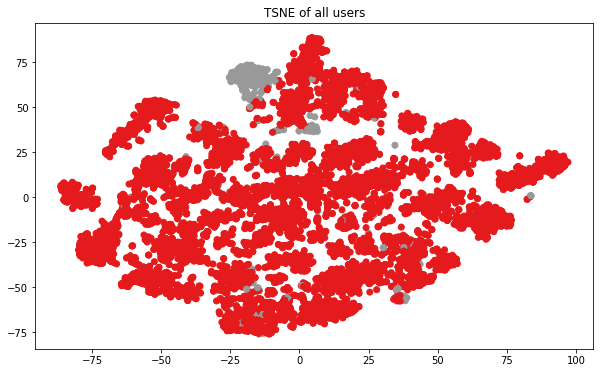

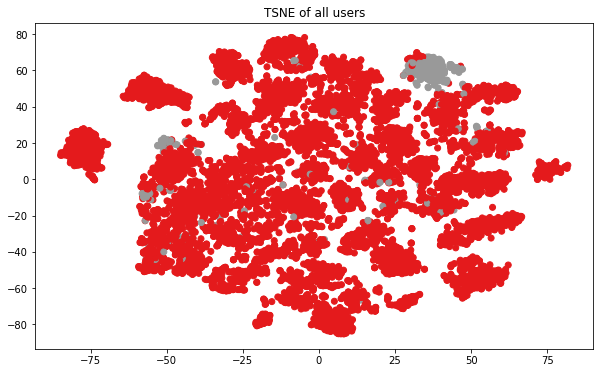

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


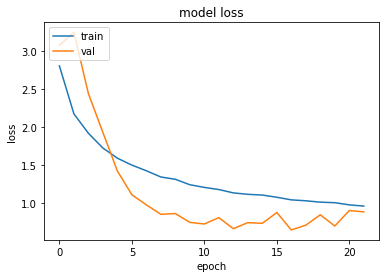

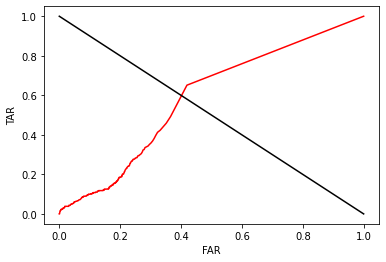

s013


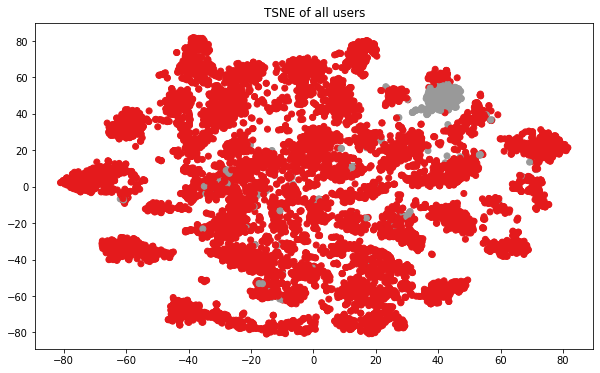

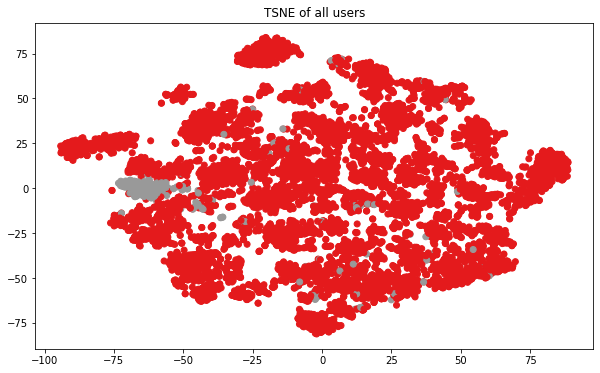

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


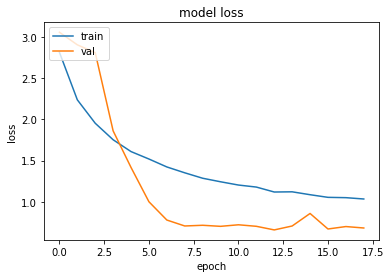

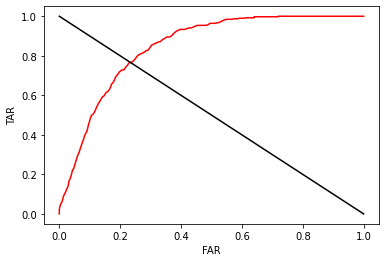

s015


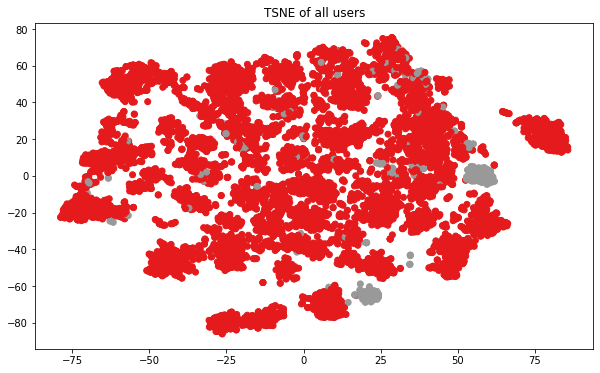

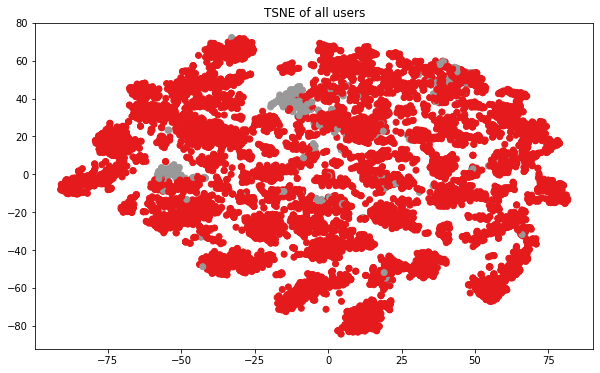

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


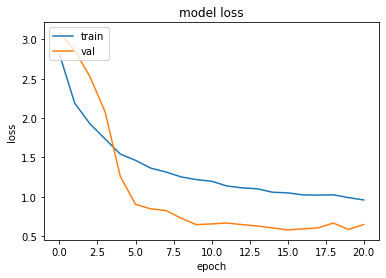

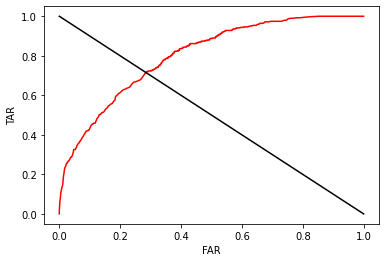

s016


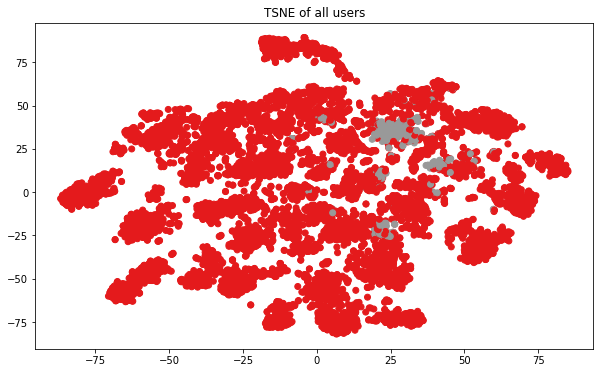

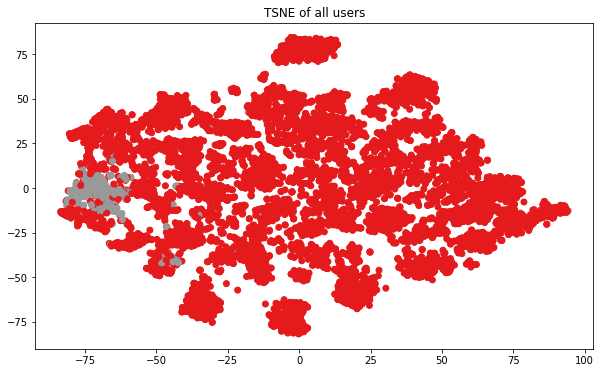

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


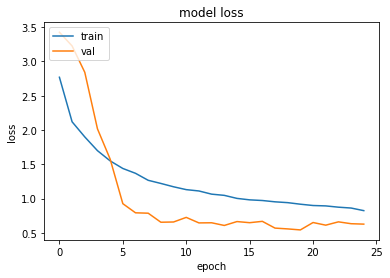

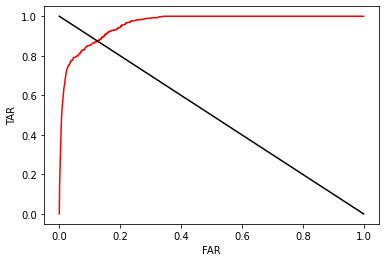

s017


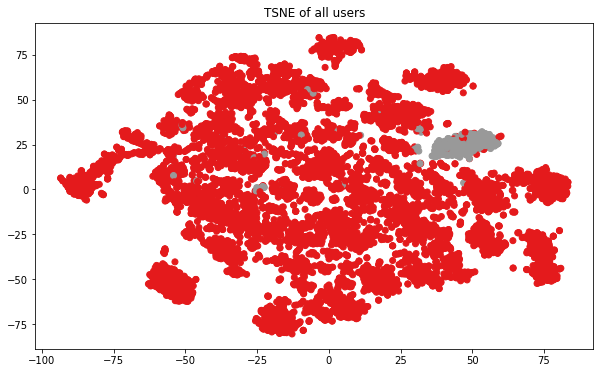

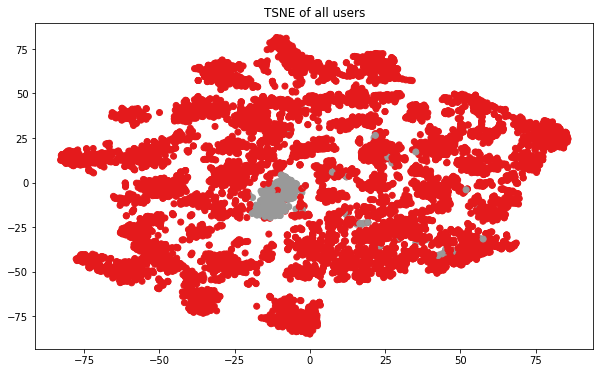

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


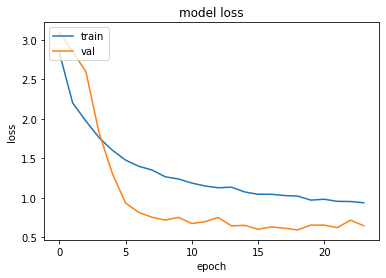

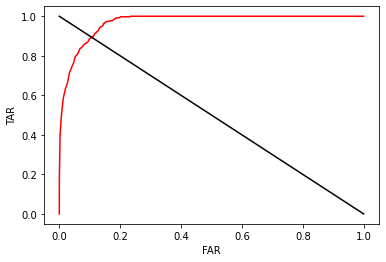

s018


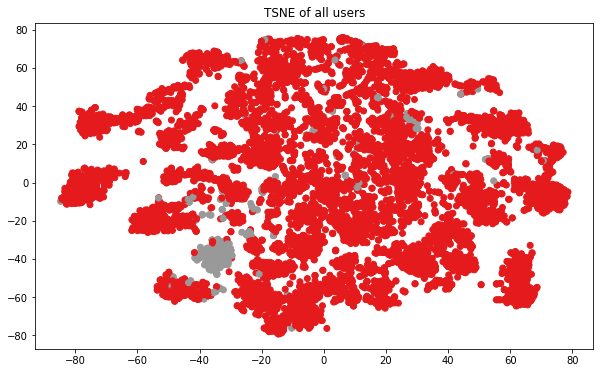

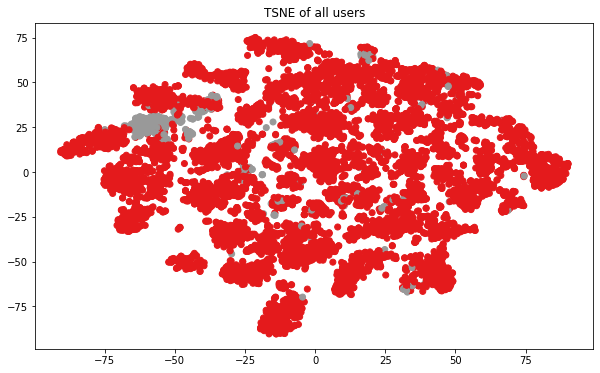

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


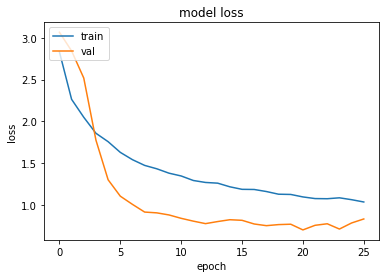

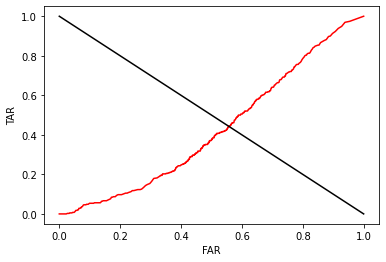

s019


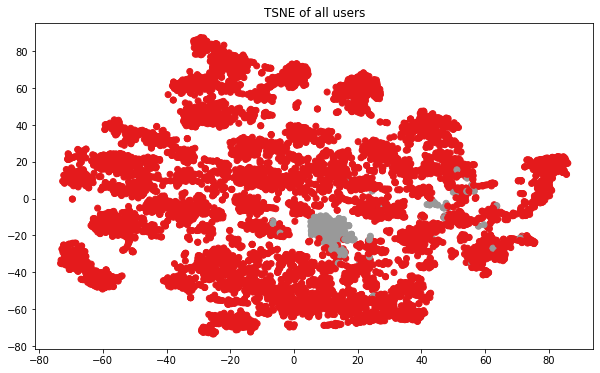

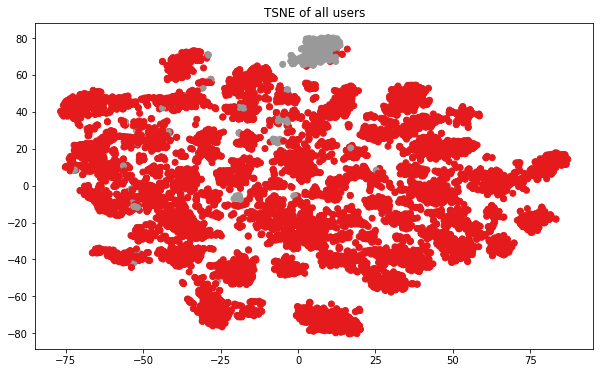

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


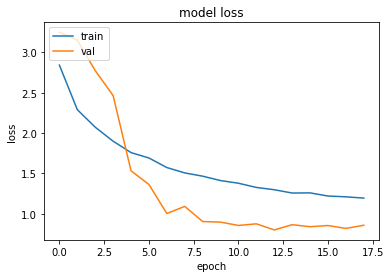

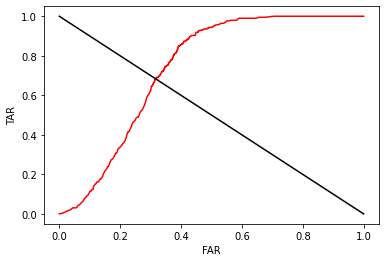

s020


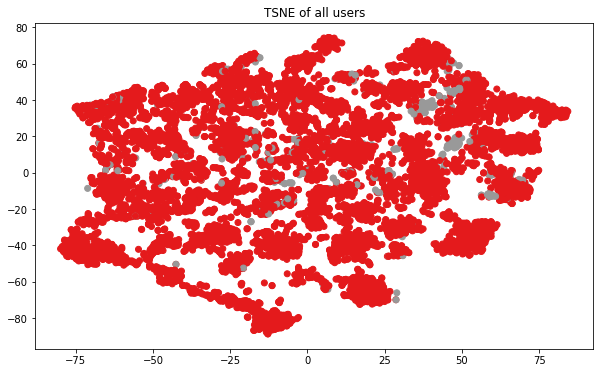

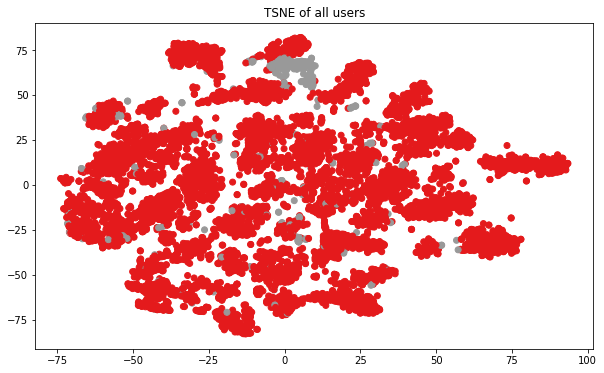

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


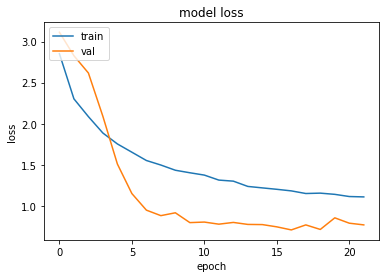

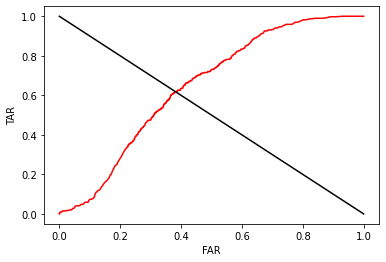

s021


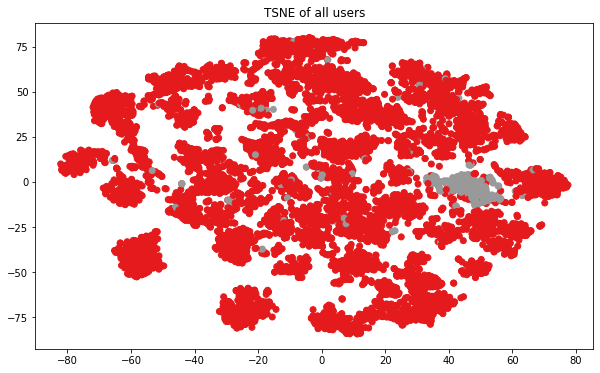

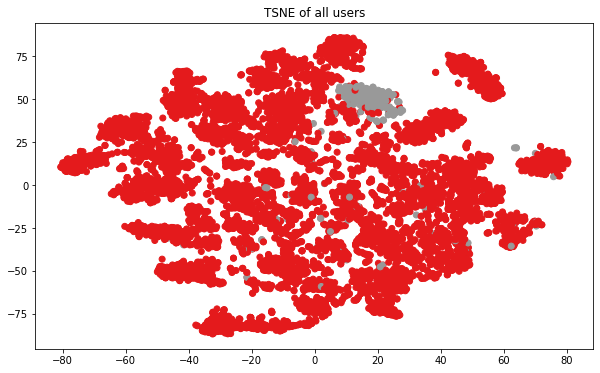

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


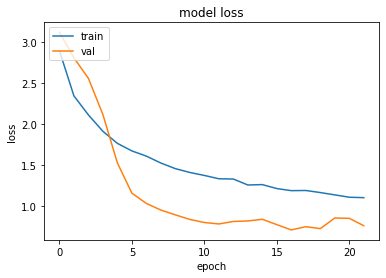

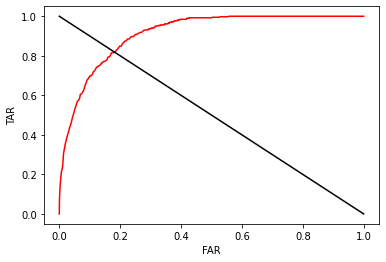

s022


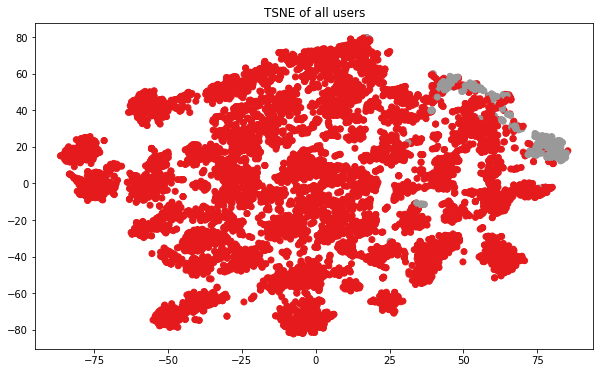

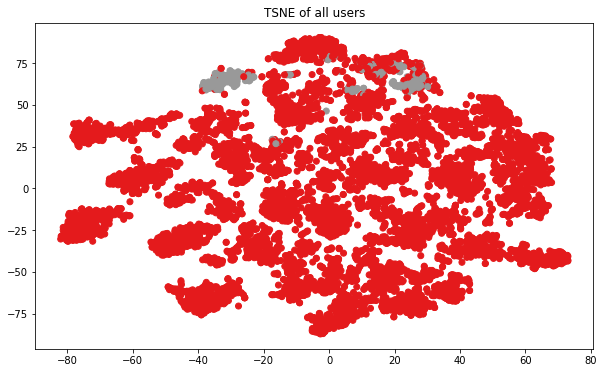

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


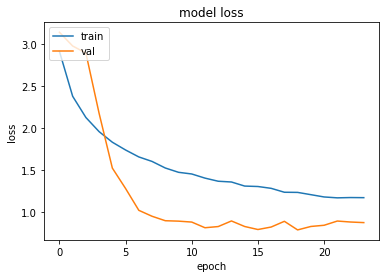

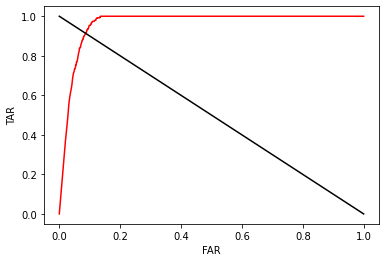

s024


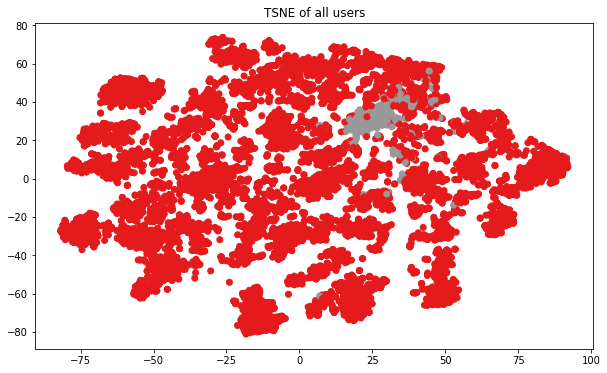

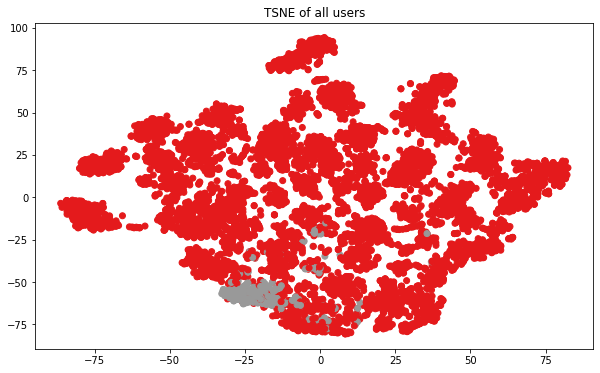

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


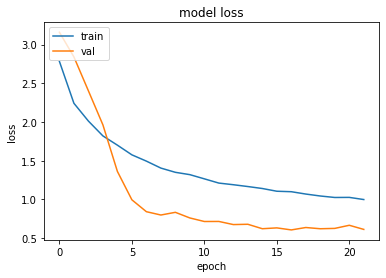

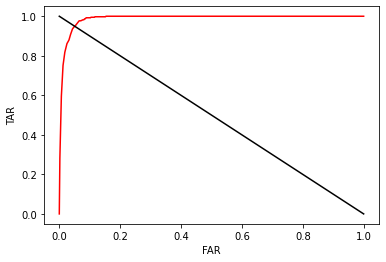

s025


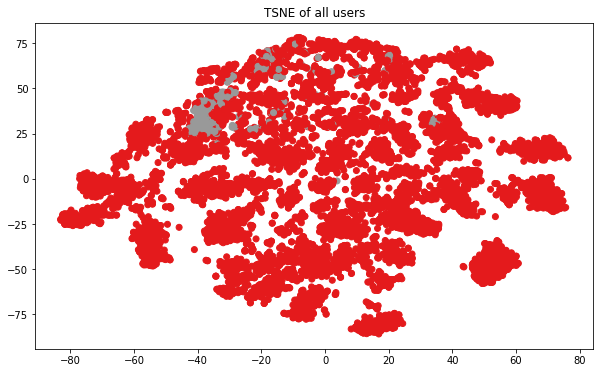

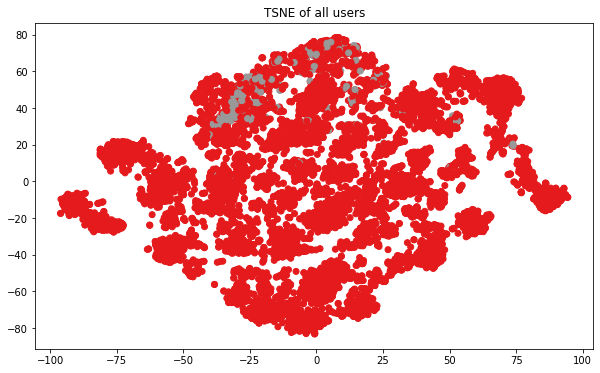

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


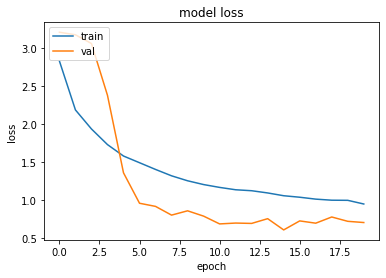

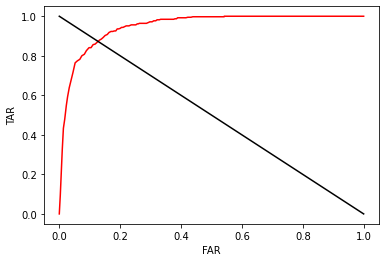

s026


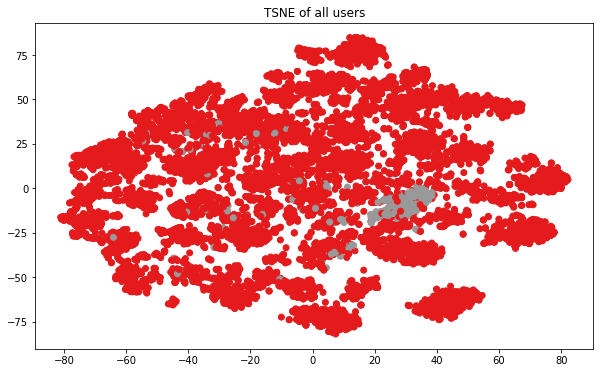

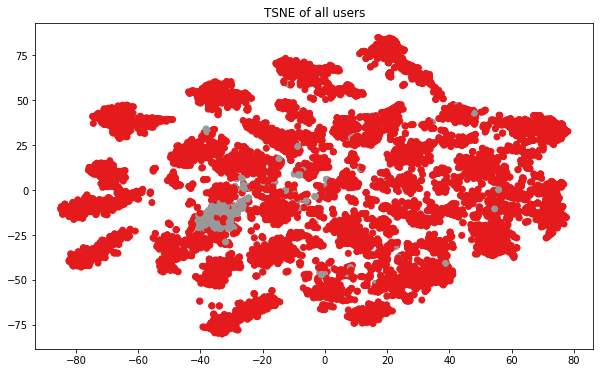

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


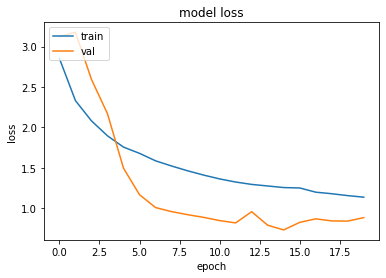

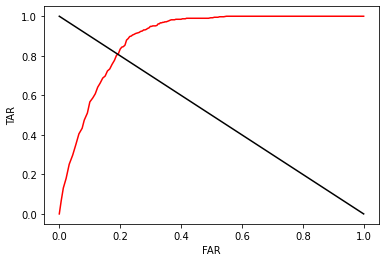

s027


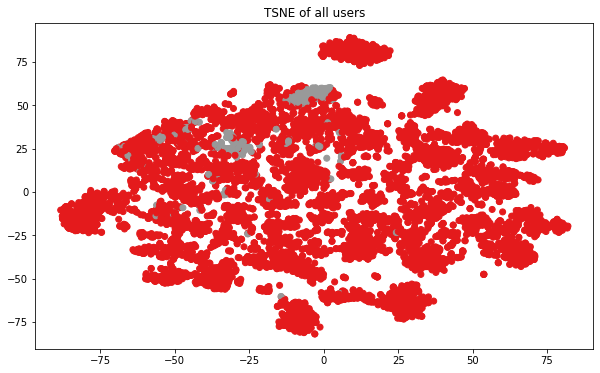

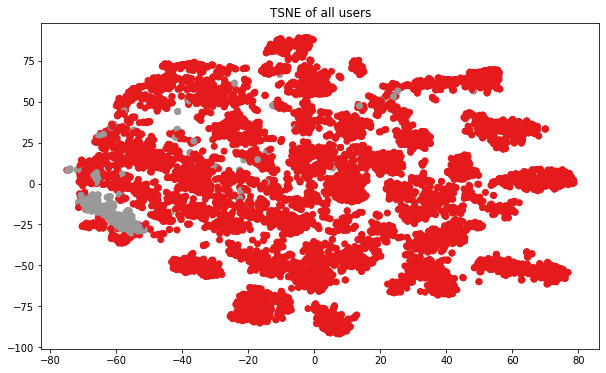

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


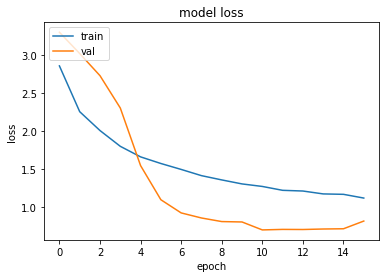

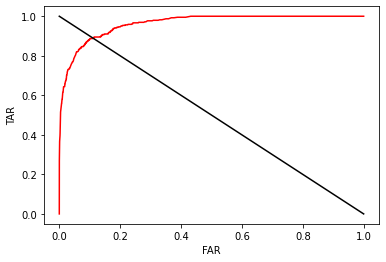

s028


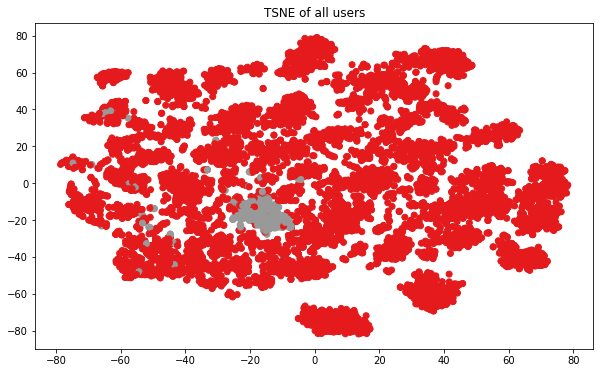

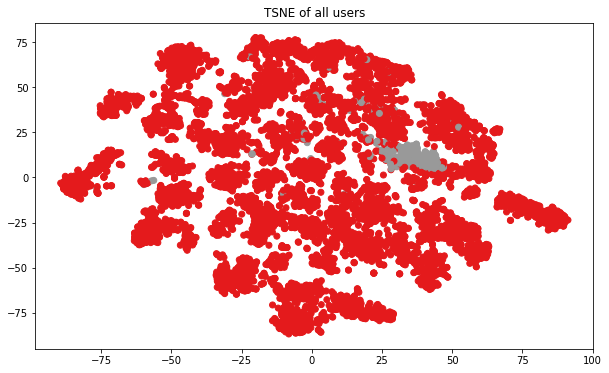

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


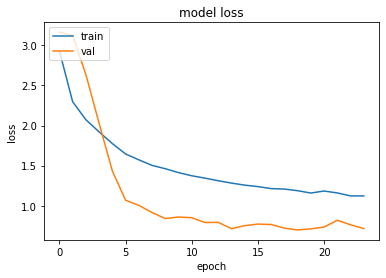

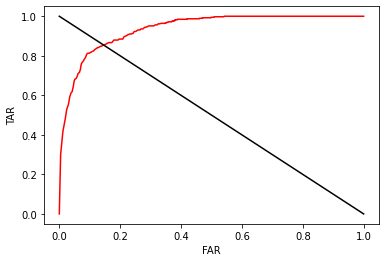

s029


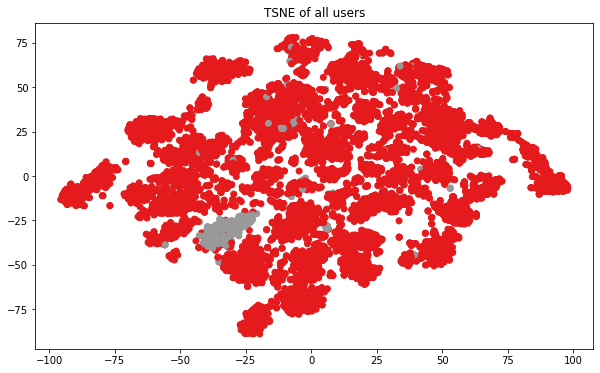

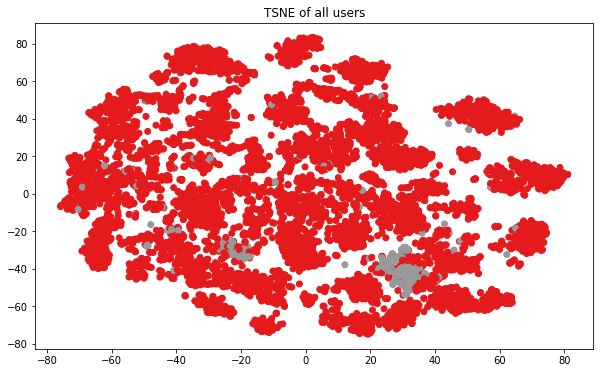

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


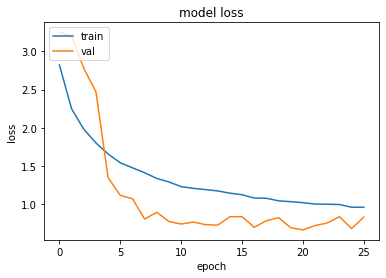

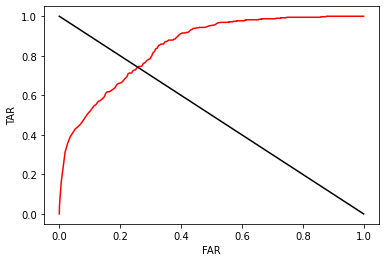

s030


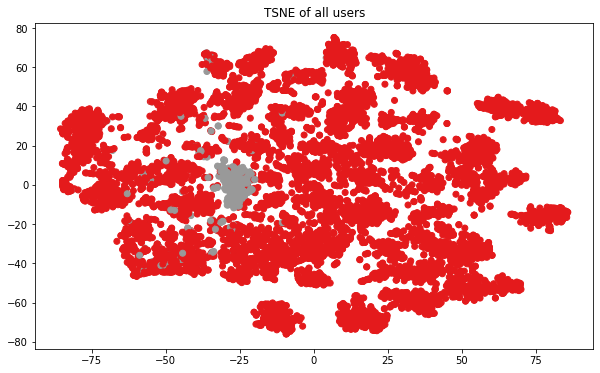

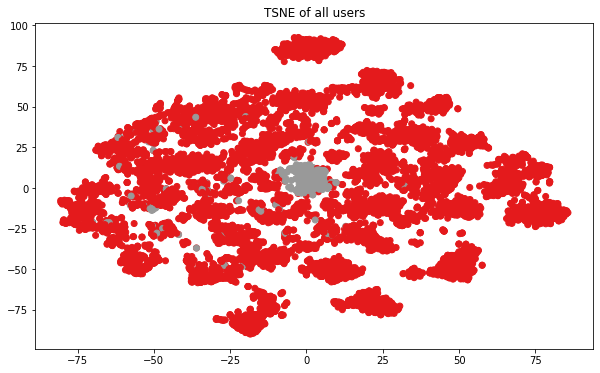

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


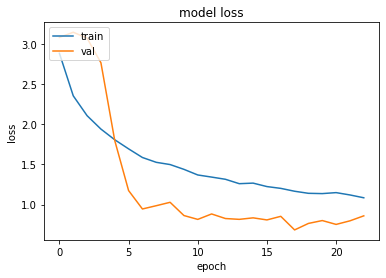

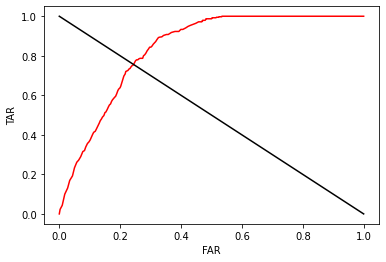

s031


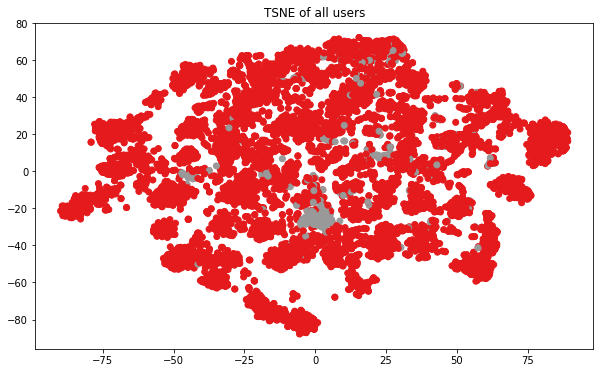

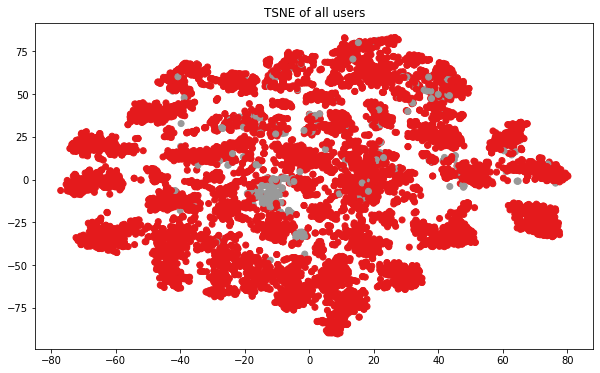

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


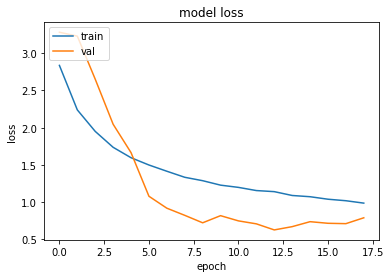

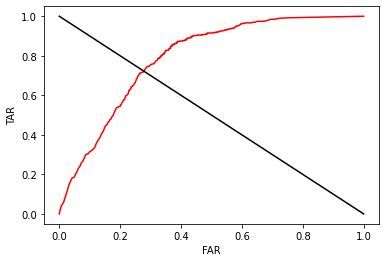

s032


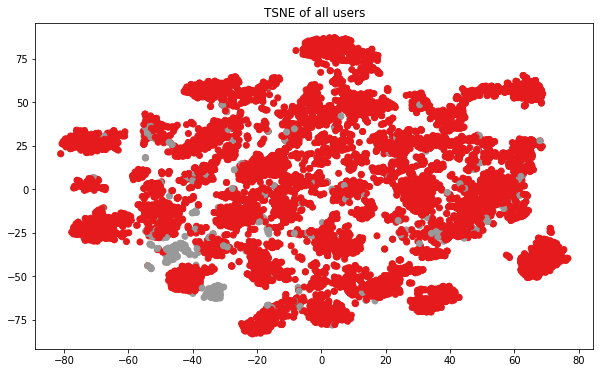

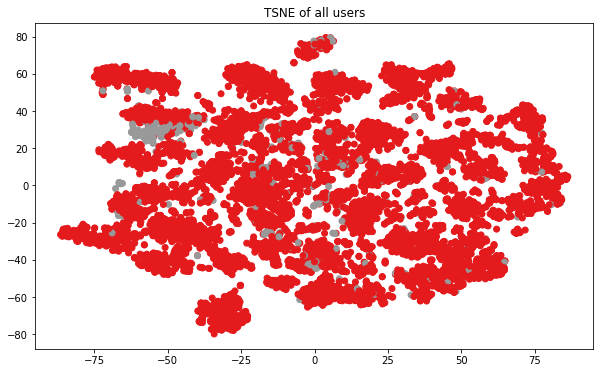

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


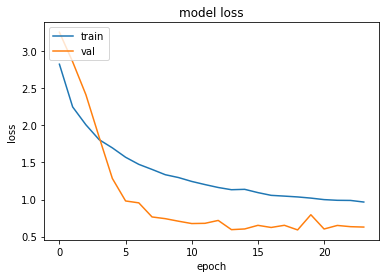

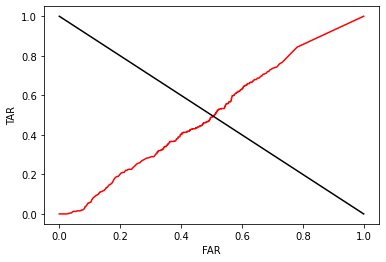

s033


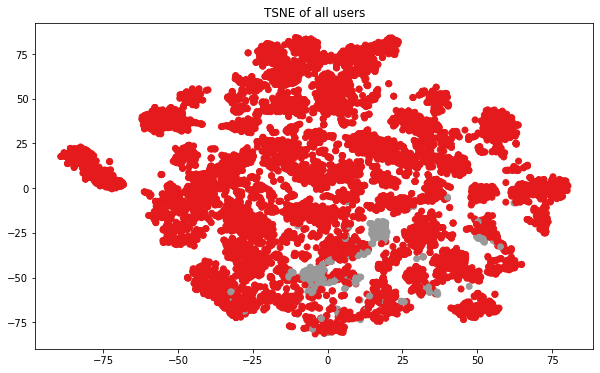

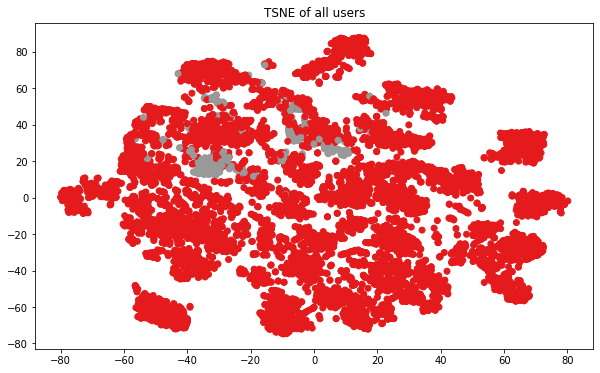

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


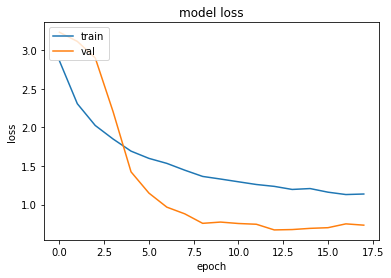

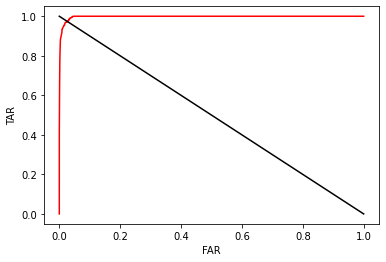

s034


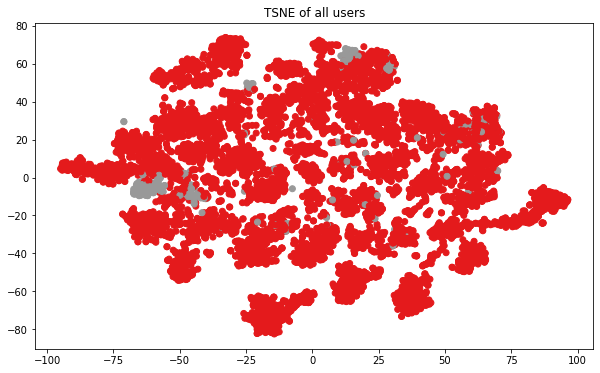

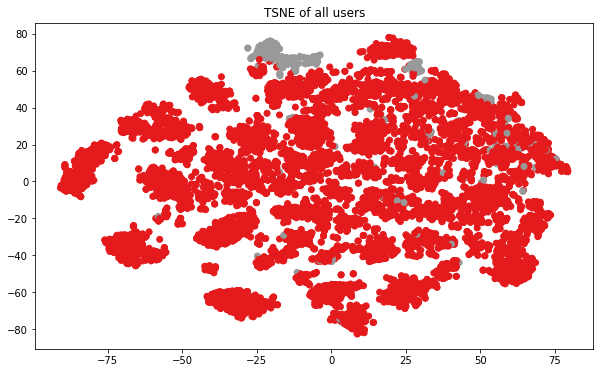

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


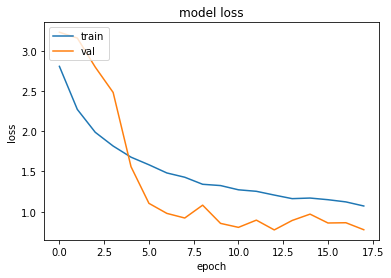

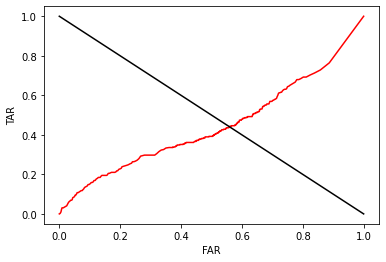

s035


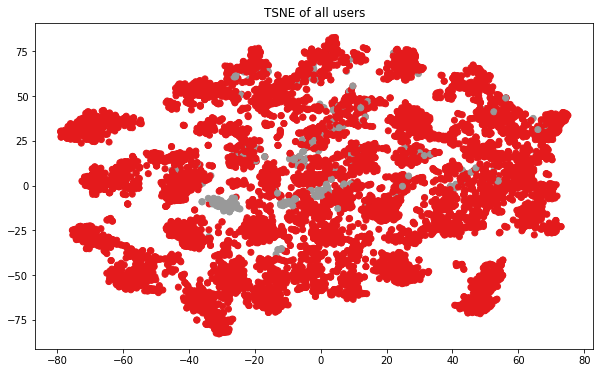

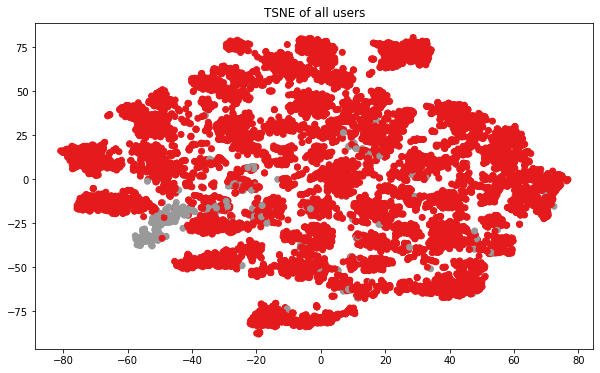

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


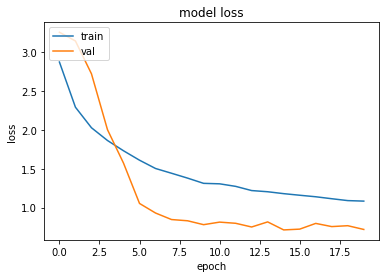

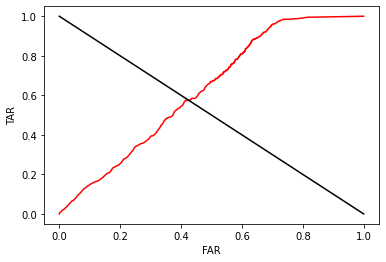

s036


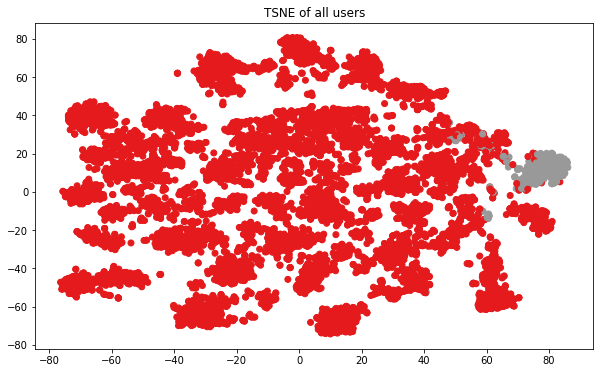

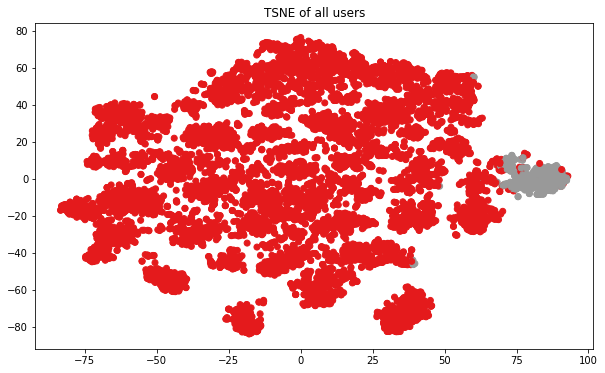

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


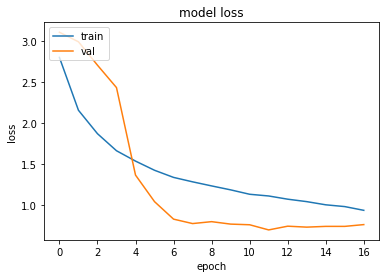

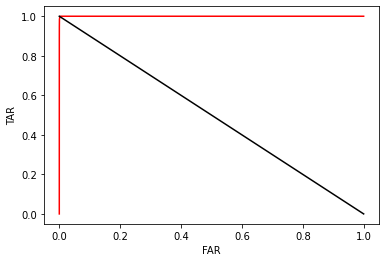

s037


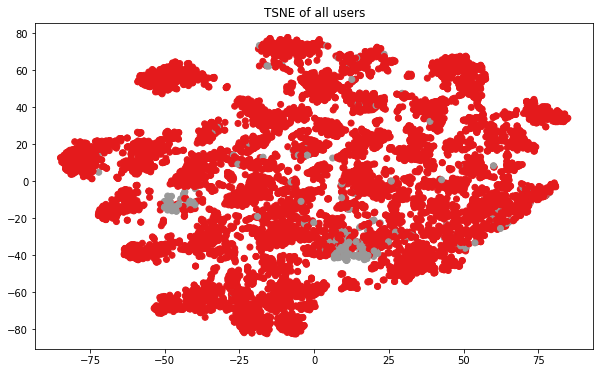

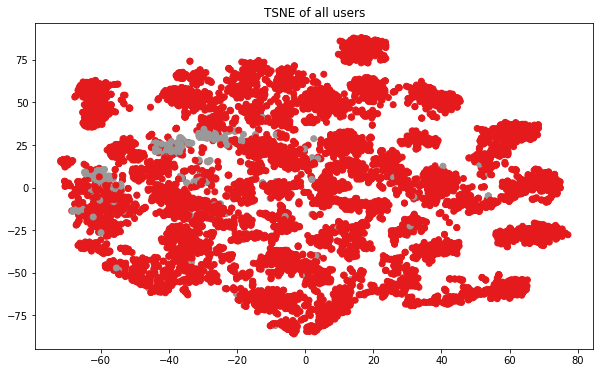

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


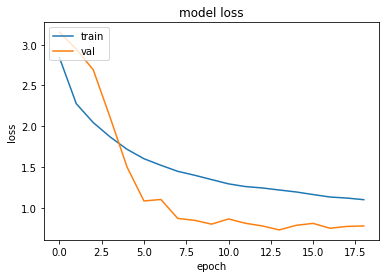

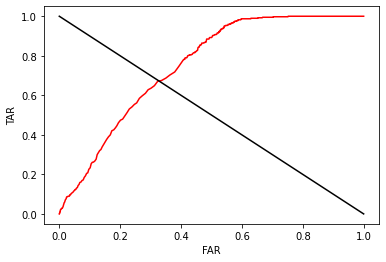

s038


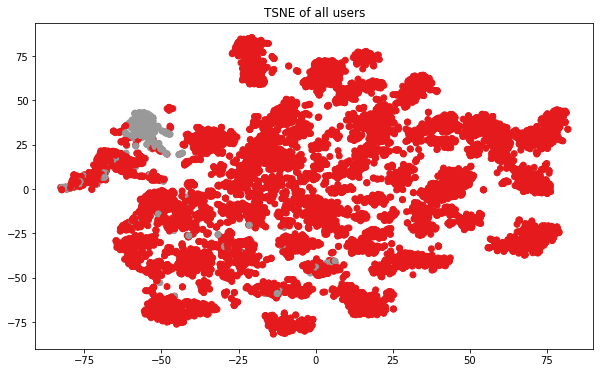

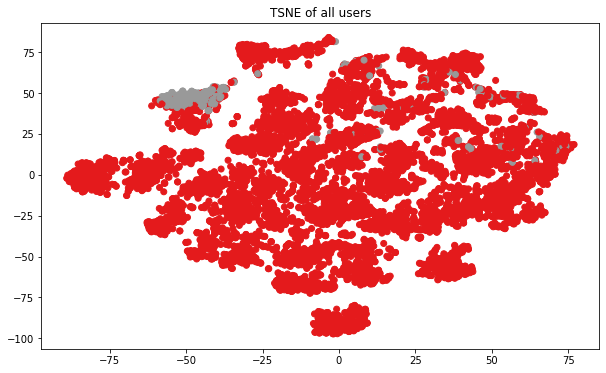

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


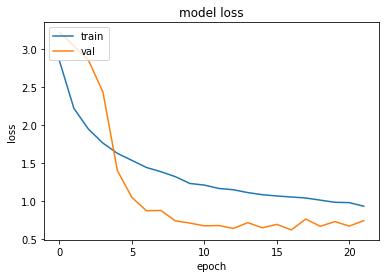

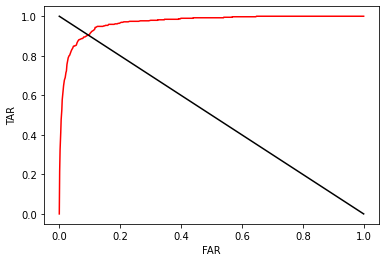

s039


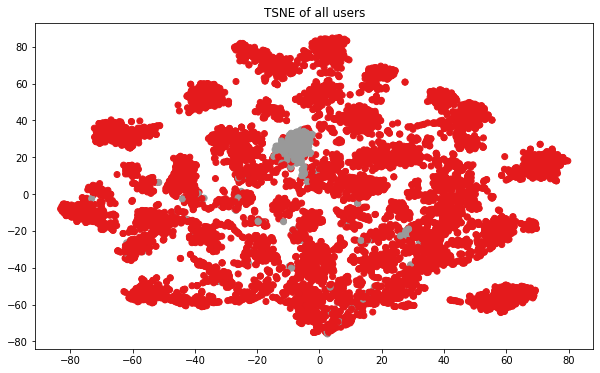

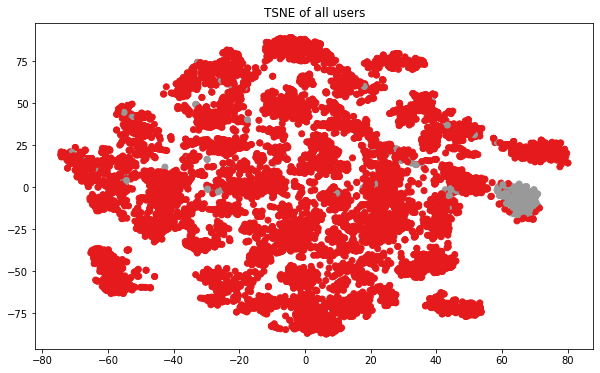

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


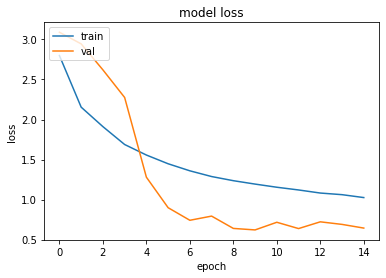

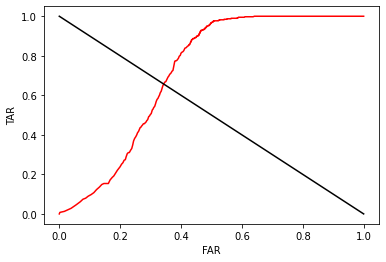

s040


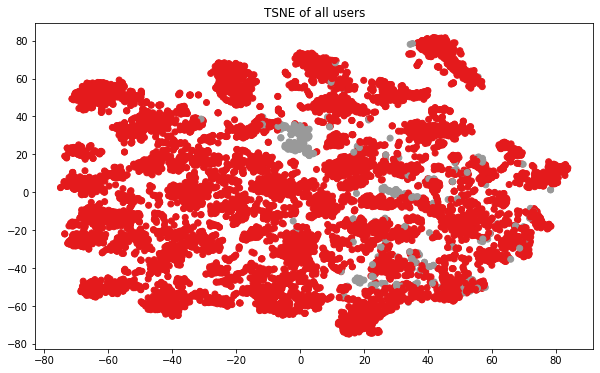

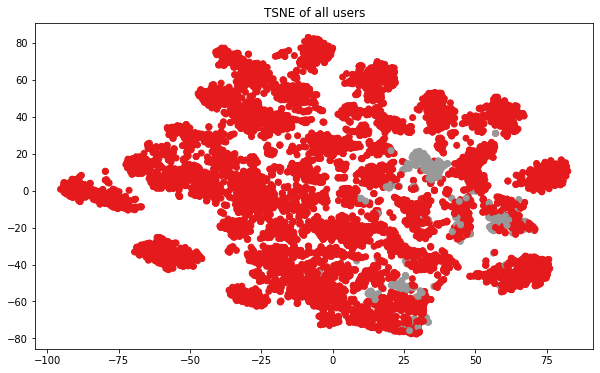

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


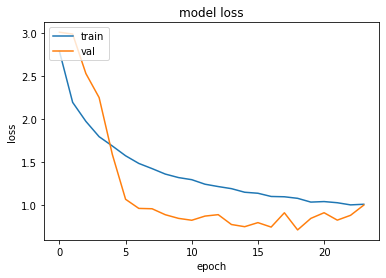

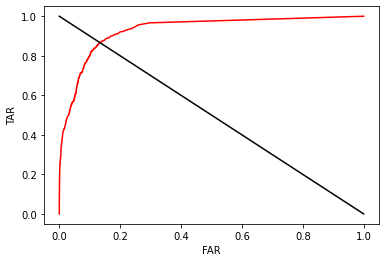

s041


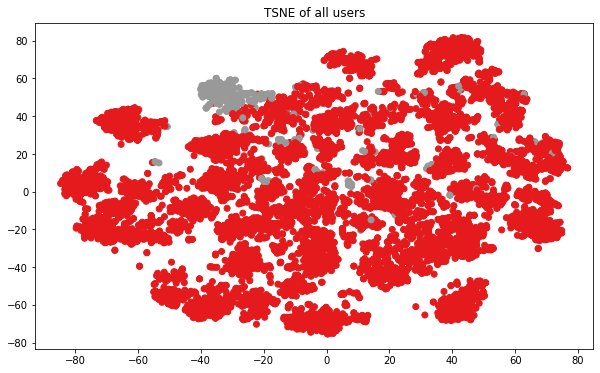

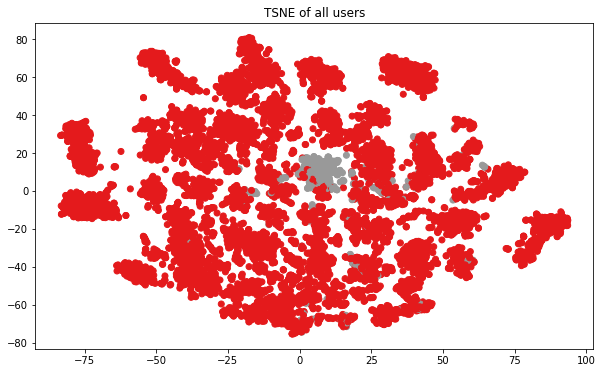

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


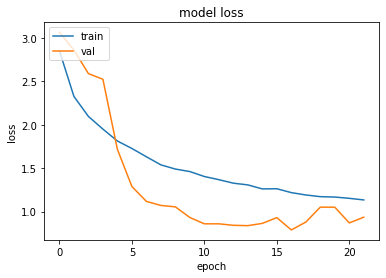

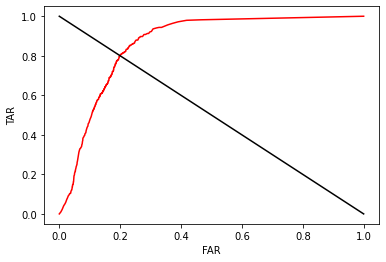

s042


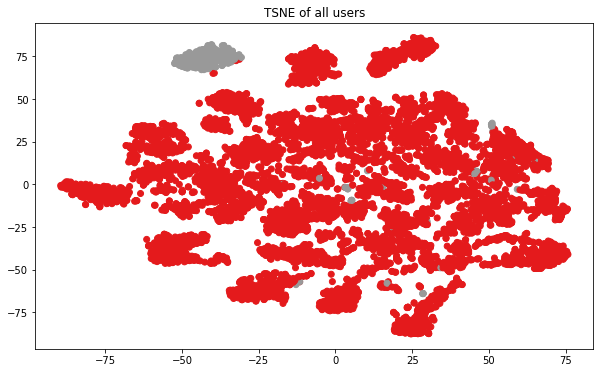

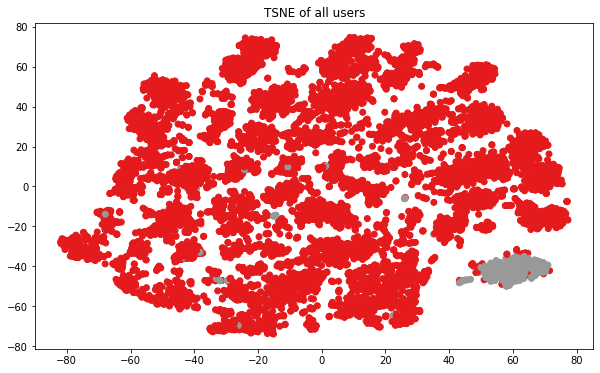

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


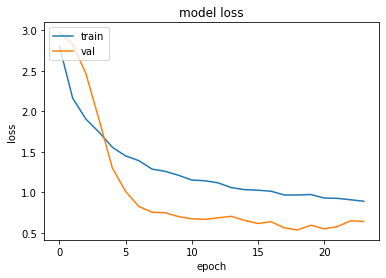

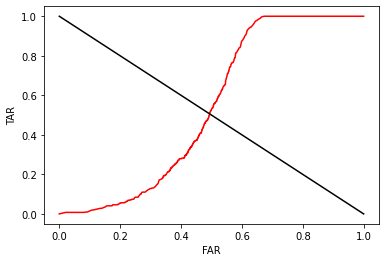

s043


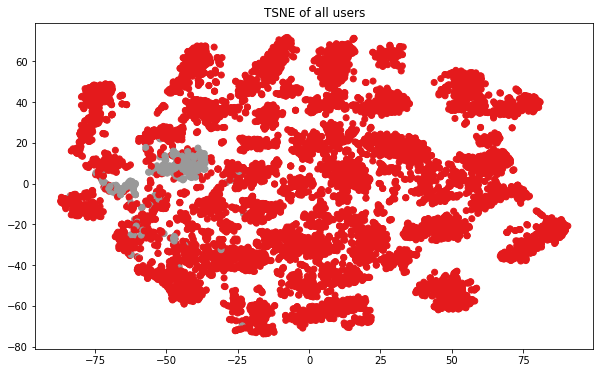

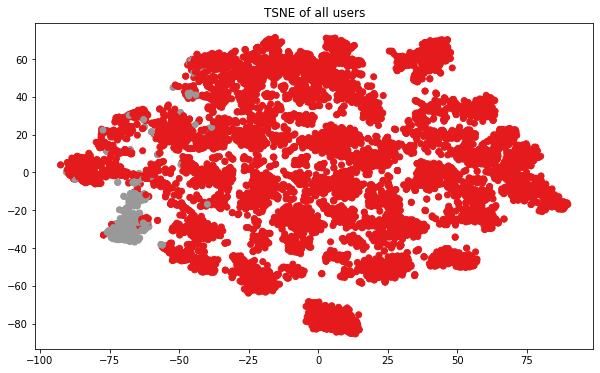

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


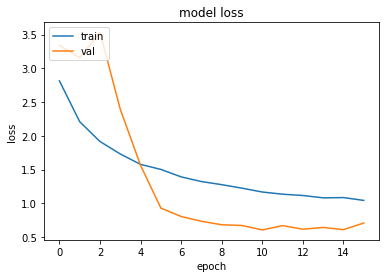

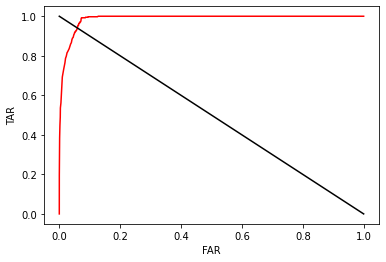

s044


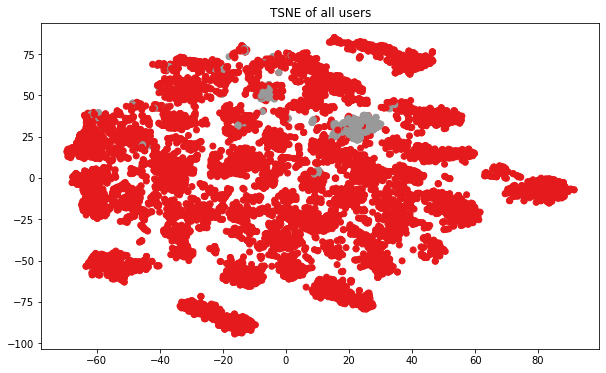

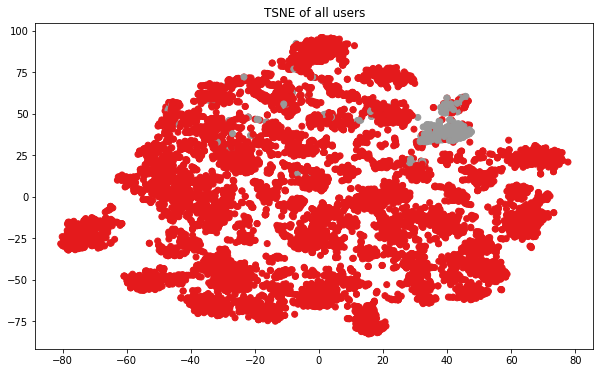

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


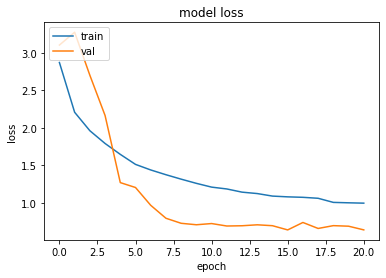

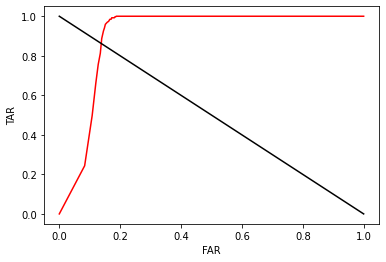

s046


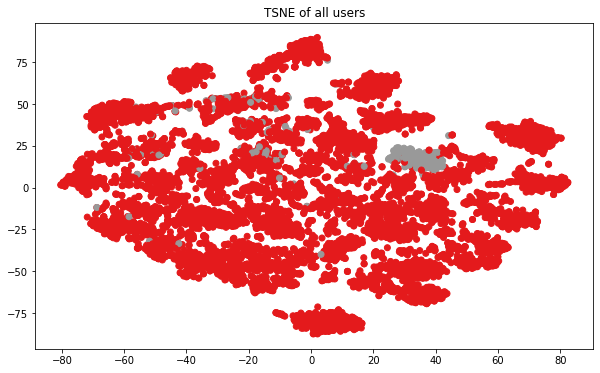

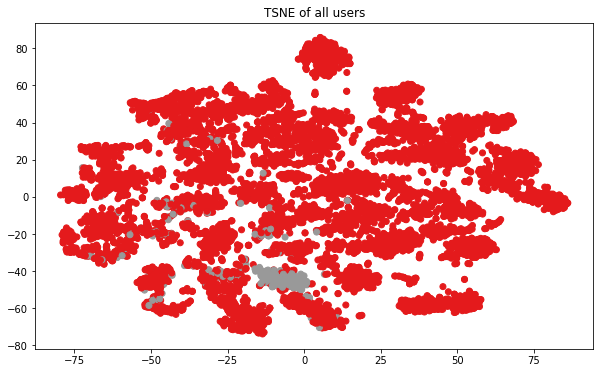

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


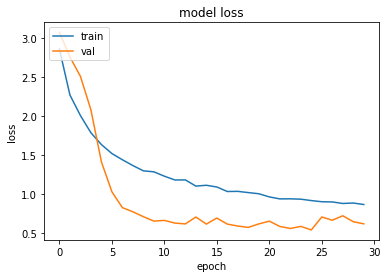

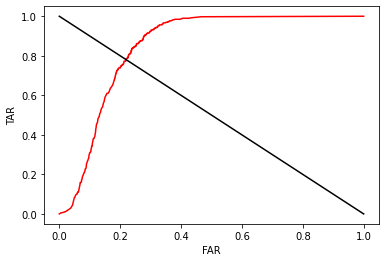

s047


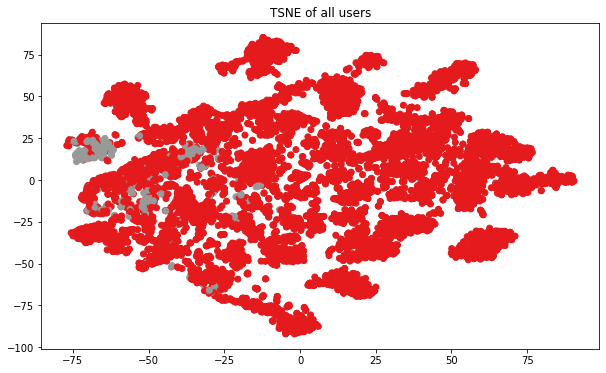

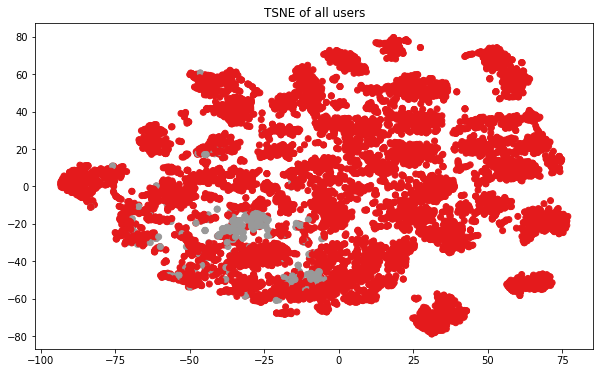

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


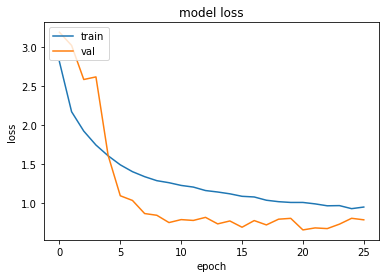

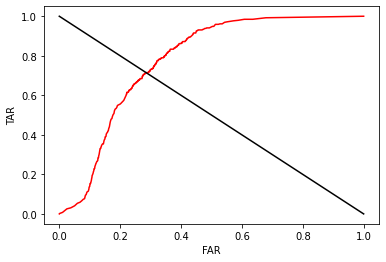

s048


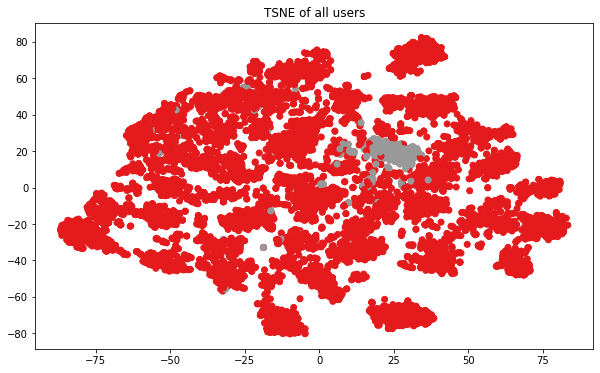

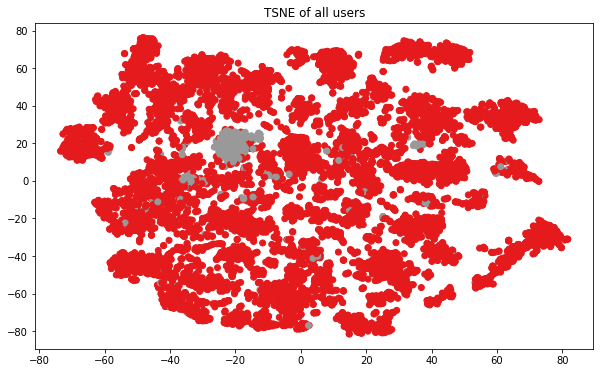

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


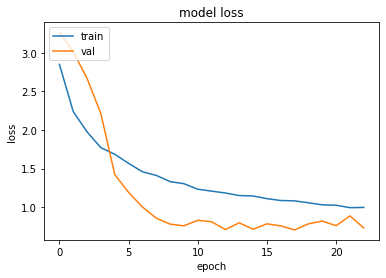

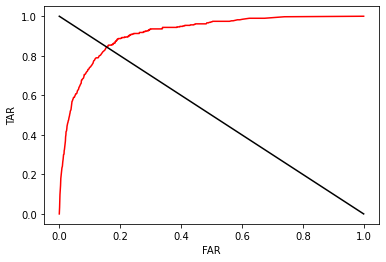

s049


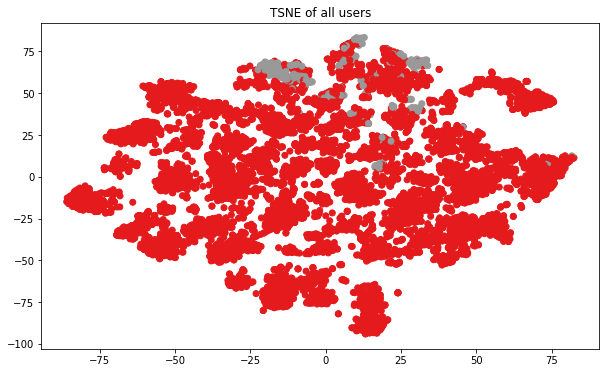

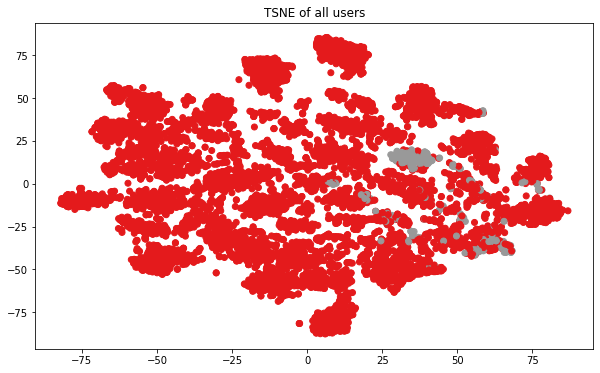

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


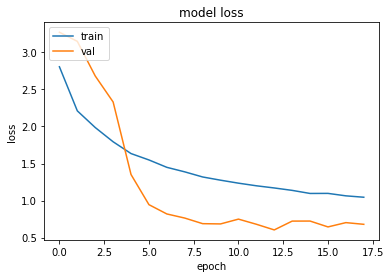

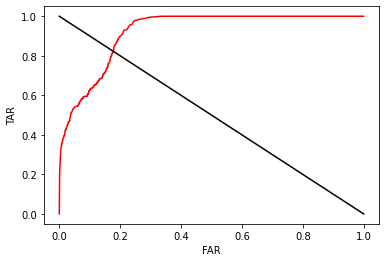

s050


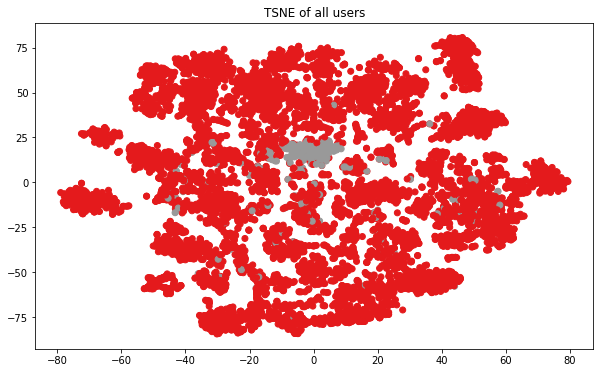

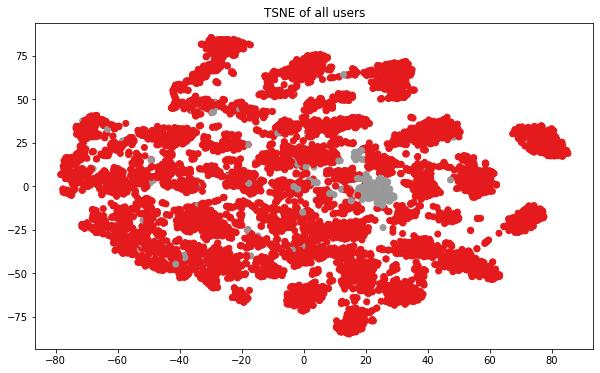

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


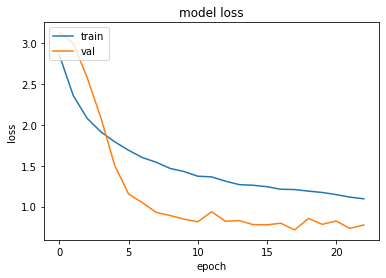

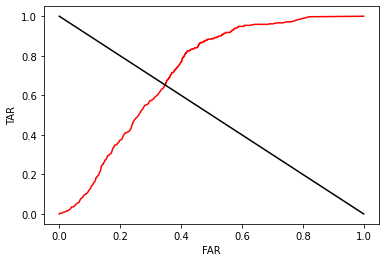

s051


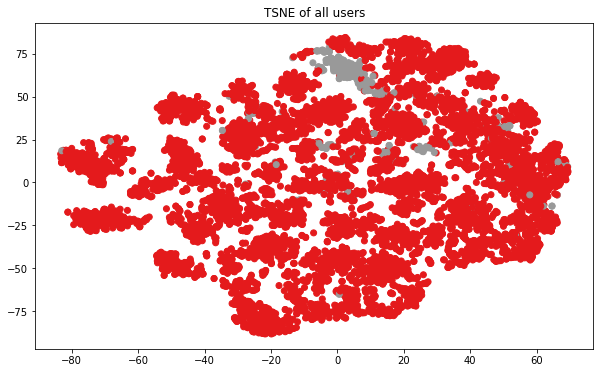

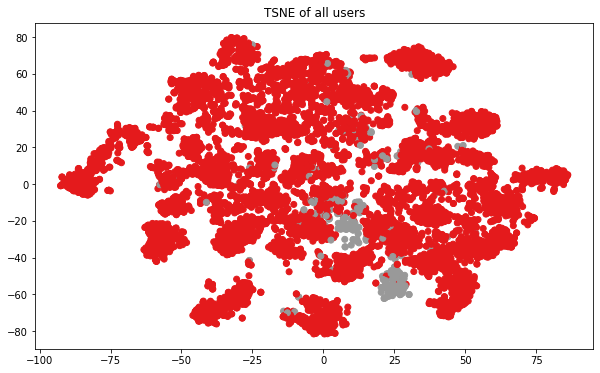

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


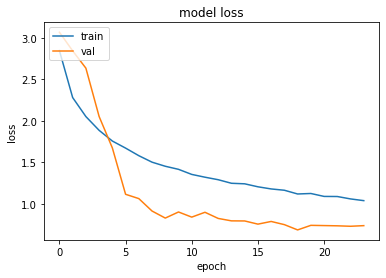

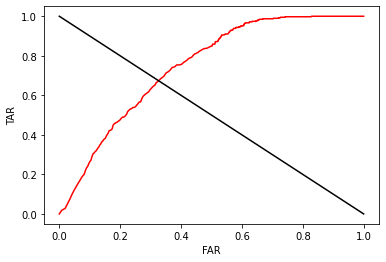

s052


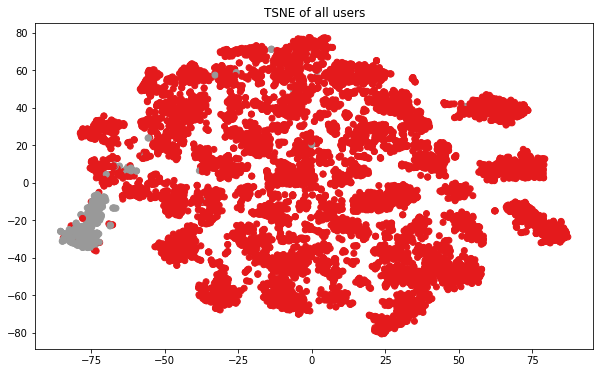

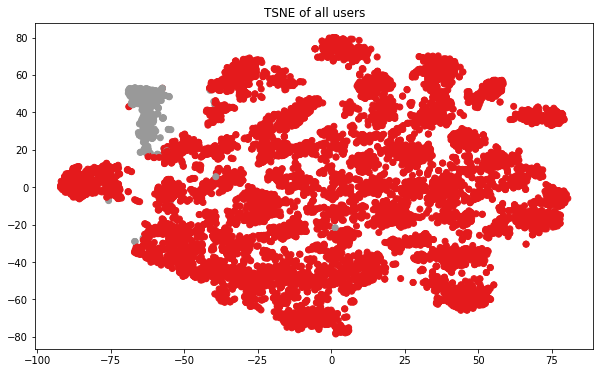

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


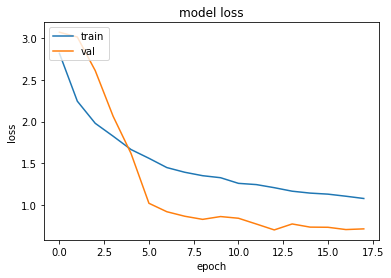

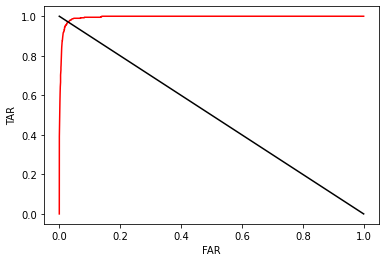

s053


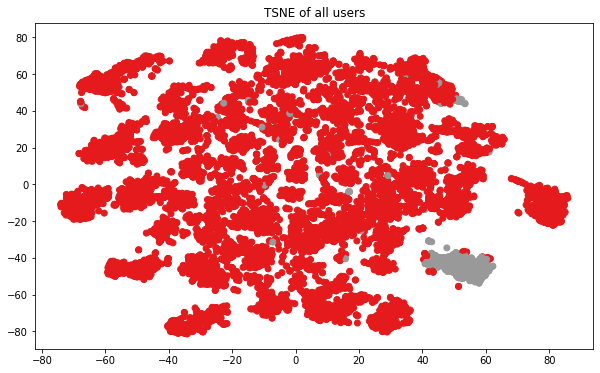

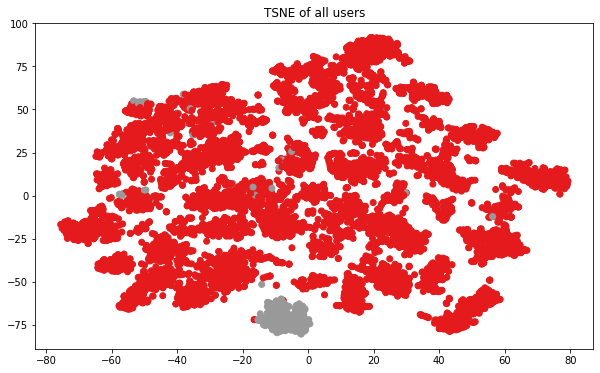

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


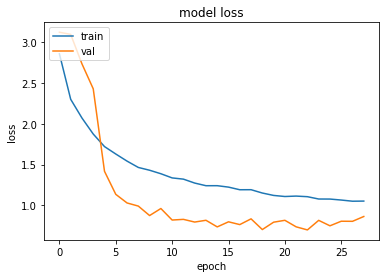

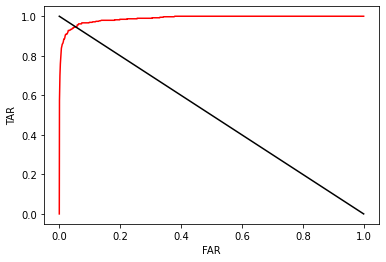

s054


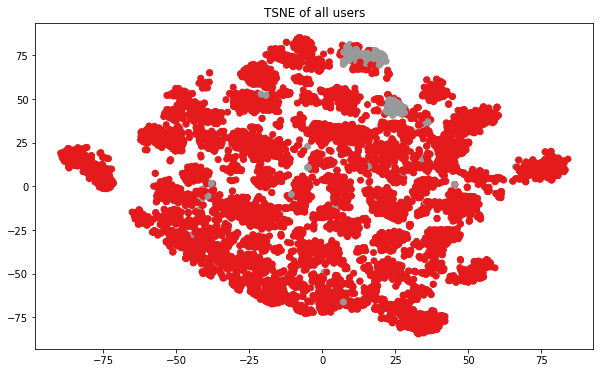

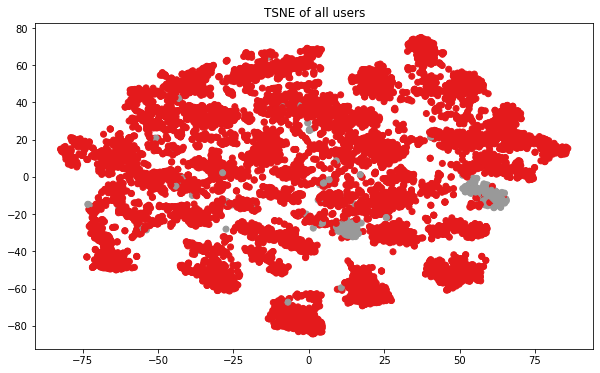

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


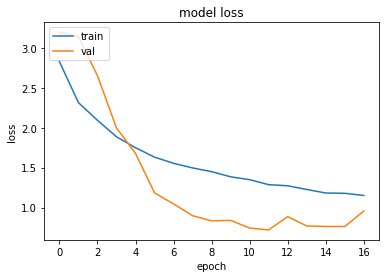

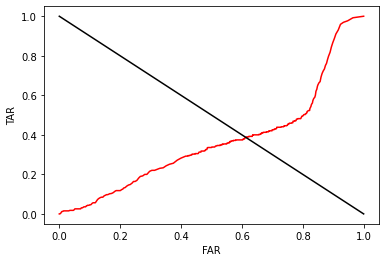

s055


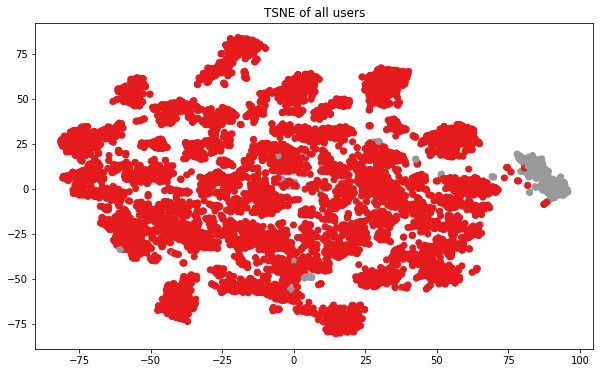

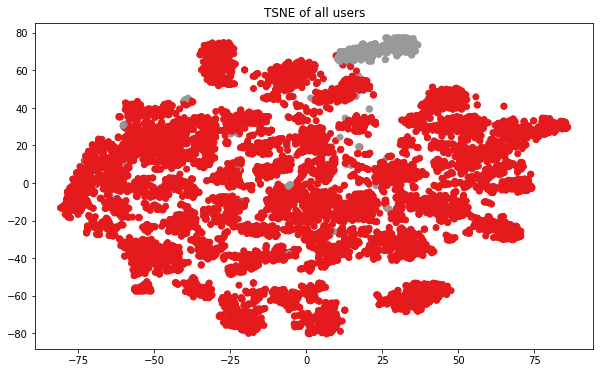

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


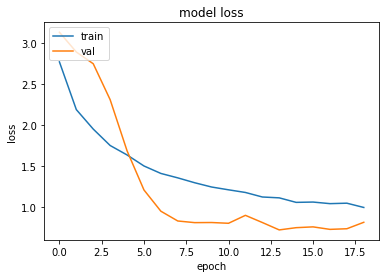

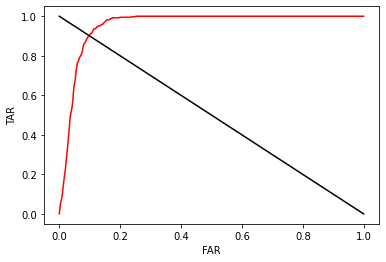

s056


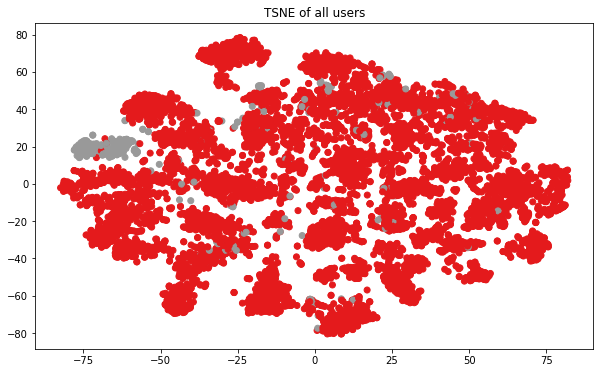

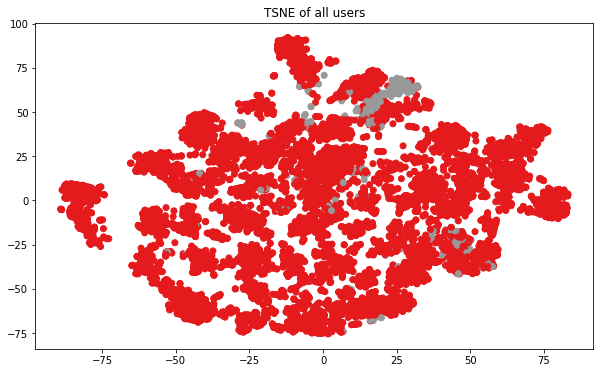

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


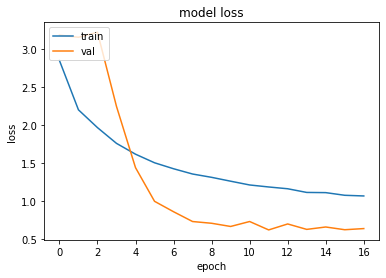

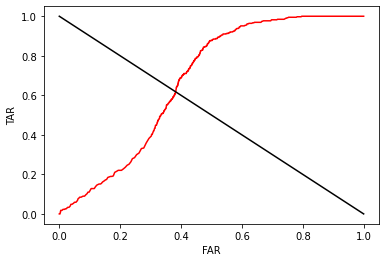

s057


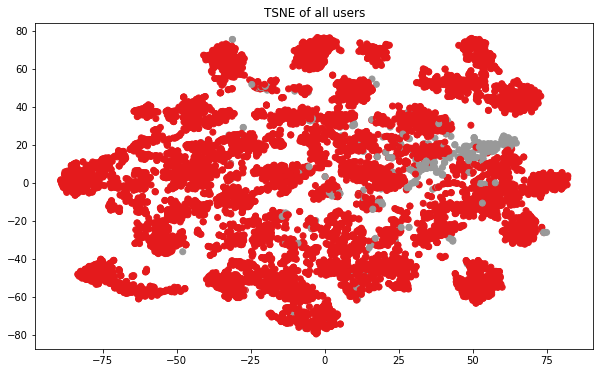

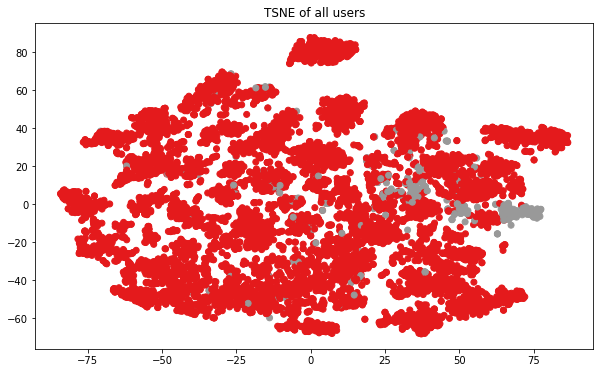

(10000, 21)
(20000, 21)
(10390, 21)
X_train.shape (10000, 9, 812)
Y_train_encoded.shape (10000, 25)


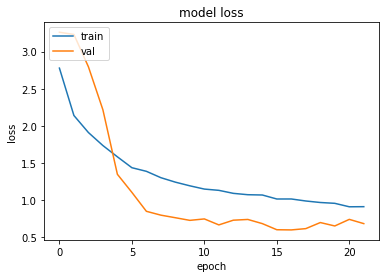

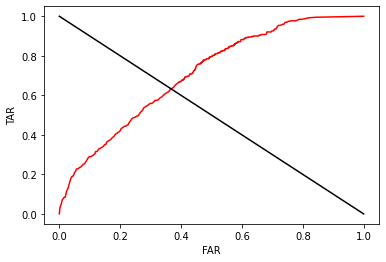

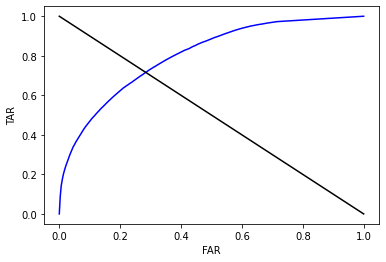

0.7161387631975868 TAR and 0.2840941176470589 FAR achieved at threshold: 0.0885


In [ ]:
thresholds = np.concatenate([np.linspace(0, 0.05, 1001), np.linspace(0.05, 0.1, 101), np.linspace(0.1, 1, 101)]) #np.linspace(0, 1, 1001)
TAR_progression, FAR_progression = np.zeros(len(thresholds)), np.zeros(len(thresholds))
for individual in individuals: # 51 individuals total
  print(individual)
  tmp_TAR_progression, tmp_FAR_progression = test_lstm_on_user(individual, thresholds, human_attacks=True, verbose=0)
  TAR_progression = TAR_progression + tmp_TAR_progression
  FAR_progression = FAR_progression + tmp_FAR_progression
  plt.plot(tmp_FAR_progression,
         tmp_TAR_progression,
         color="red")
  plt.xlabel("FAR")
  plt.ylabel("TAR")
  plt.plot(np.linspace(0, 1, 2), np.linspace(1, 0, 2), color = "black")
  plt.show()
TAR_progression = TAR_progression / len(individuals)
FAR_progression = FAR_progression / len(individuals)
plt.plot(FAR_progression,
         TAR_progression,
         color="blue")
plt.xlabel("FAR")
plt.ylabel("TAR")
plt.plot(np.linspace(0, 1, 2), np.linspace(1, 0, 2), color = "black")
plt.show()

best_index = np.argmin(abs(1 - (TAR_progression + FAR_progression)))
best_threshold = thresholds[best_index]
# Best Threshold(s): 0.0885
print("{} TAR and {} FAR achieved at threshold: {}".format(TAR_progression[best_index], FAR_progression[best_index], best_threshold))

# Train/Test on everyone's data

In [ ]:
from keras.layers import BatchNormalization

# fit and evaluate an LSTM model
def generate_lstm_model(trainX, trainy, verbose=0):
  epochs, batch_size = 100, 64
  n_outputs = trainy.shape[1]
  callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
  model = Sequential()
  model.add(BatchNormalization(name="normalization_layer")) # each input becomes relative to other inputs of given batch
  model.add(LSTM(75, input_shape=(9,812), dropout = 0.3, recurrent_dropout=0.3, name="lstm_layer"))
  model.add(Dropout(0.3))
  model.add(Dense(150, activation='relu', name="dense_intermediate"))
  model.add(Dropout(0.3))
  model.add(Dense(n_outputs, activation='softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  # fit network
  history = model.fit(trainX, trainy, epochs=epochs, validation_split=0.2, batch_size=batch_size, callbacks=[callback], verbose=verbose)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  if verbose == 1:
    model.summary()
  return model

In [ ]:
from sklearn.manifold import TSNE
import umap

def plot_embeddings(results, labels):
  # TSNE
  tsne = TSNE()
  tsne_results = tsne.fit_transform(results)

  tsne_1 = tsne_results[:,0]
  tsne_2 = tsne_results[:,1]
  plt.figure(figsize=(10,6))
  plt.scatter(tsne_1, tsne_2, c = labels, cmap = "Set1")
  plt.title("TSNE of all users")
  plt.show()

In [ ]:
def test_lstm_on_user(loo_user, threshold_progression, verbose=0):
  initial_train_data = []
  retrain_data = []
  test_data = []

  num_samples_to_train_on = 10
  non_loo_users = individuals[individuals != loo_user]
  # randomize non_loo_users order
  random.shuffle(non_loo_users)

  for user in individuals:
      data_randomized_user = data.loc[data["subject"] == user].sample(frac=1, random_state = random_seed)
      data_randomized_user.reset_index(inplace=True, drop=True)
      if user == loo_user:
        initial_train_data.append(data_randomized_user.loc[int(2*len(data_randomized_user)/3):])
        for i in range(1300):
          retrain_data.append(data_randomized_user.loc[:9])
        test_data.append(data_randomized_user.loc[10:int(2*len(data_randomized_user)/3)])
      else: 
        initial_train_data.append(data_randomized_user.loc[:int(2*len(data_randomized_user)/3)])
        retrain_data.append(data_randomized_user.loc[:int(2*len(data_randomized_user)/3)])
        test_data.append(data_randomized_user.loc[int(2*len(data_randomized_user)/3):])

  initial_train_data = concat_and_randomize_data(initial_train_data)
  print("initial_train.shape", initial_train_data.shape)

  retrain_data = concat_and_randomize_data(retrain_data)
  print("retrain.shape", retrain_data.shape)

  test_data = concat_and_randomize_data(test_data)
  print("test.shape", test_data.shape)

  # plotting true user vs others
  data_subset = data[(data["subject"].isin(non_loo_users)) | (data["subject"] == loo_user)].sample(frac=1, random_state = random_seed).copy()
  data_subset["subject"] = (data_subset["subject"] == loo_user) * 1
  data_subset.sort_values(by=['subject'], inplace=True)
  plot_embeddings(data_subset[data_subset.columns[3:]], data_subset["subject"])

  X_train = initial_train_data[initial_train_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train)
  Y_train_encoded = assign_names_to_numbers(initial_train_data["subject"].copy())
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  print("X_train.shape", X_train.shape)
  print("Y_train_encoded.shape", Y_train_encoded.shape)

  model = generate_lstm_model(X_train, Y_train_encoded, verbose)

  # At this point, we have a trained model for known users

  X_train = retrain_data[retrain_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train) 
  Y_train_encoded = binary_classification(retrain_data["subject"].copy(), loo_user)
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  new_model_layers = model.layers[:-1]
  for layer in new_model_layers:
    layer.trainable = False
  new_model = Sequential(new_model_layers)
  new_model.add(Dense(2, activation='softmax'))

  new_model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

  new_model.fit(X_train, Y_train_encoded, 
            batch_size=64, epochs=10, verbose=verbose)
  if verbose == 1:
    new_model.summary()

  # We have now retrained the model for the new user against fake attempts

  X_test = test_data[test_data.columns[3:]]
  X_test = convert_to_matrix_representation(X_test) 
  Y_test_encoded = binary_classification(test_data["subject"].copy(), loo_user)
  Y_test_encoded = Y_test_encoded.to_numpy()
  Y_test_encoded = to_categorical(Y_test_encoded)

  reals = np.argmax(Y_test_encoded, axis=1)
  predictions = new_model.predict(X_test)

  TAR_progression = []
  FAR_progression = []
  for threshold in threshold_progression:
    prediction_values = np.array([1 if predictions[i][1] > threshold else 0 for i in range(len(predictions))])

    # This is formatted as:
    # (true - rows, predicted - columns)
    # [[FR  FA]
    # [TR  TA]]
    
    conf_matrix = confusion_matrix(reals, prediction_values)
    TAR_progression.append(conf_matrix[1][1] / sum(conf_matrix[1]))
    FAR_progression.append(conf_matrix[0][1] / sum(conf_matrix[0]))
  return np.array(TAR_progression), np.array(FAR_progression)

s002
(13484, 21)
(26350, 21)
(6957, 21)


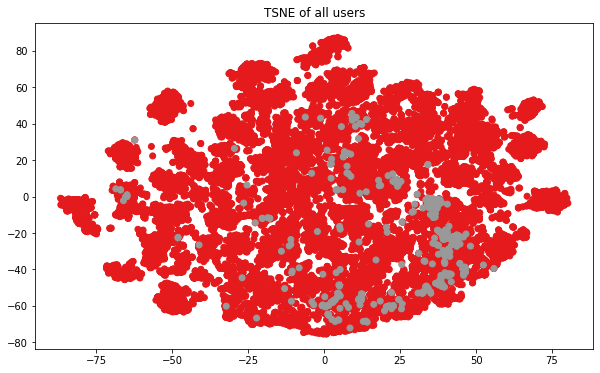

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


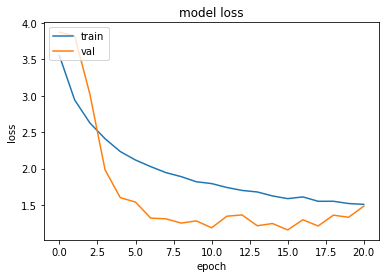

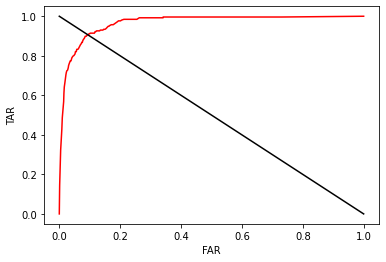

s003
(13484, 21)
(26350, 21)
(6957, 21)


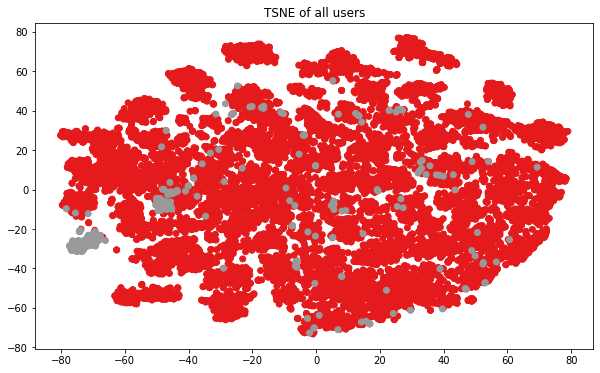

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


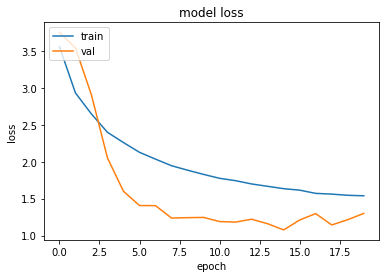

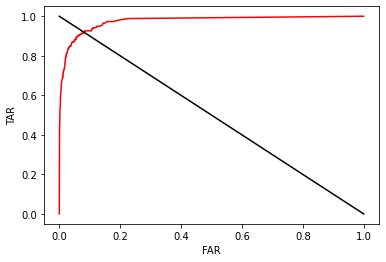

s004
(13484, 21)
(26350, 21)
(6957, 21)


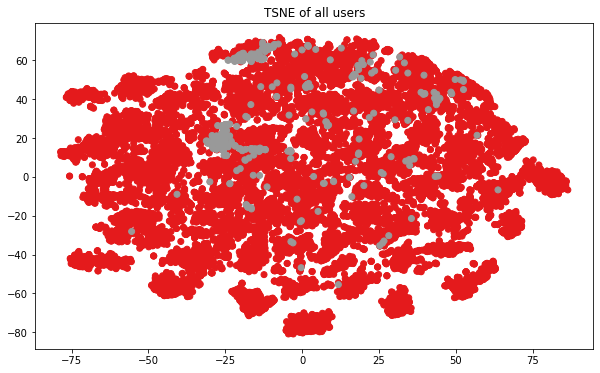

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


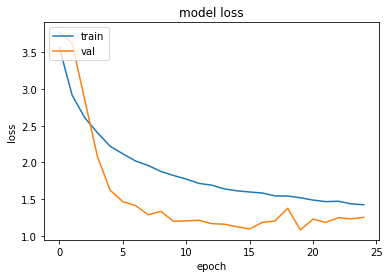

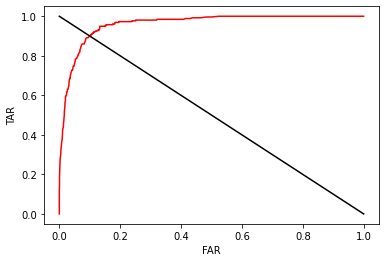

s005
(13484, 21)
(26350, 21)
(6957, 21)


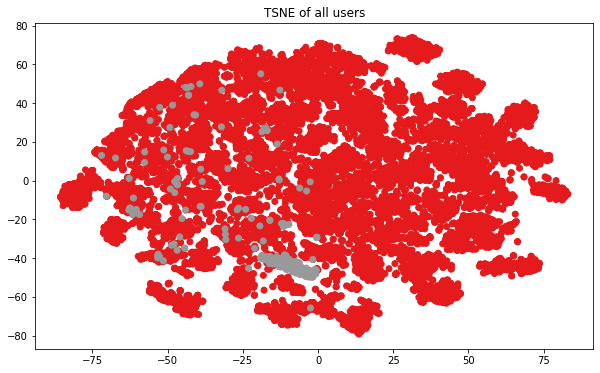

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


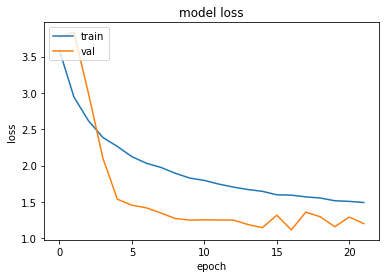

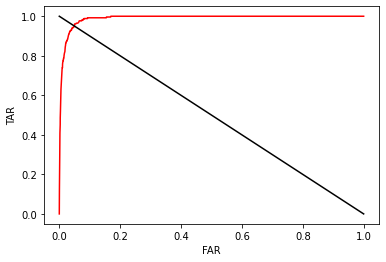

s007
(13484, 21)
(26350, 21)
(6957, 21)


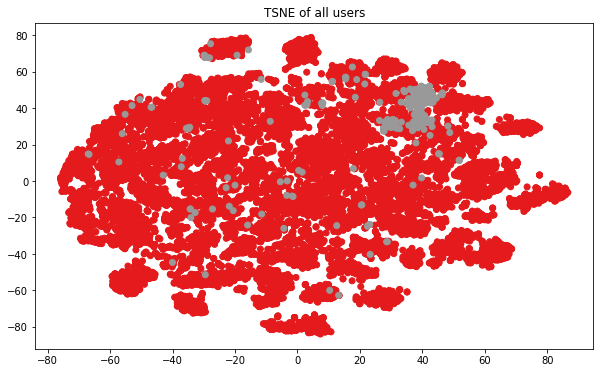

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


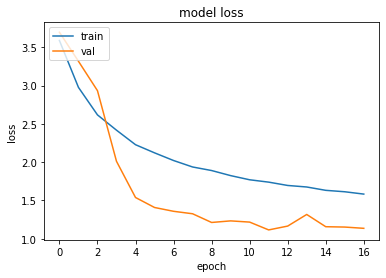

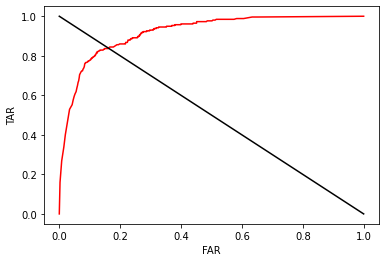

s008
(13484, 21)
(26350, 21)
(6957, 21)


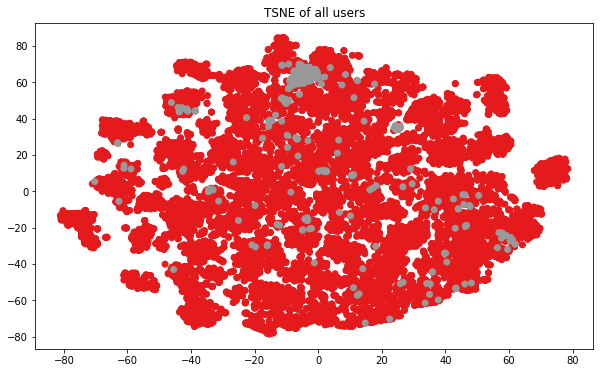

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


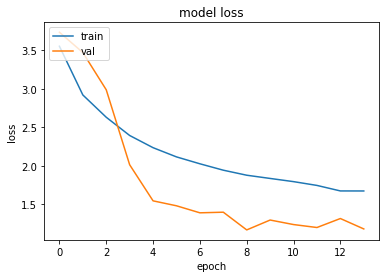

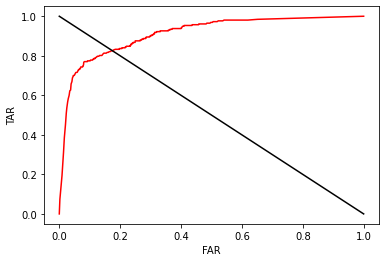

s010
(13484, 21)
(26350, 21)
(6957, 21)


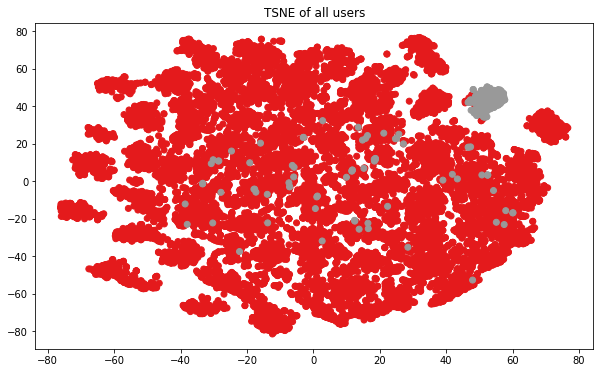

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


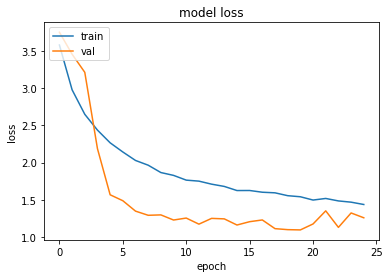

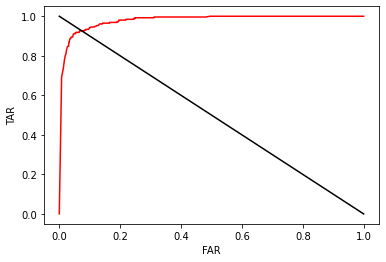

s011
(13484, 21)
(26350, 21)
(6957, 21)


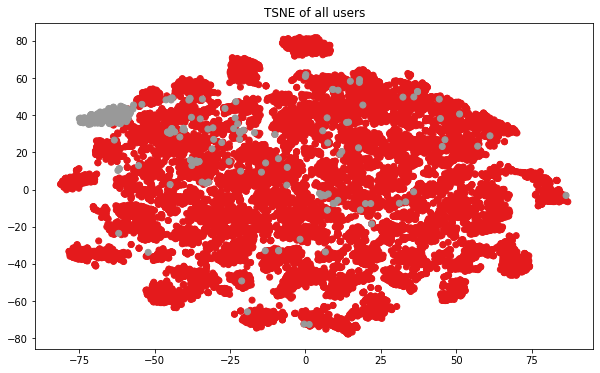

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


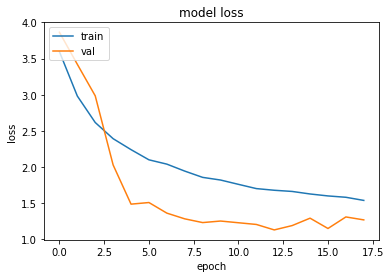

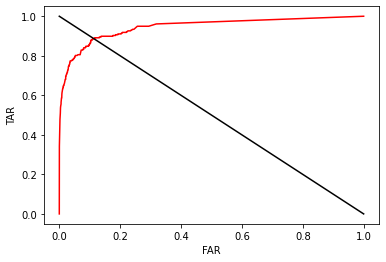

s012
(13484, 21)
(26350, 21)
(6957, 21)


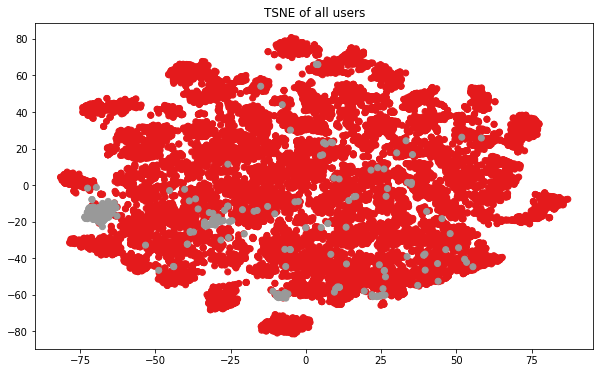

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


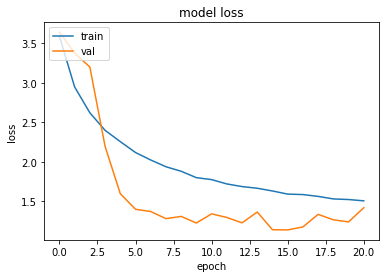

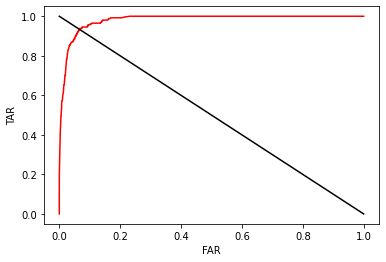

s013
(13484, 21)
(26350, 21)
(6957, 21)


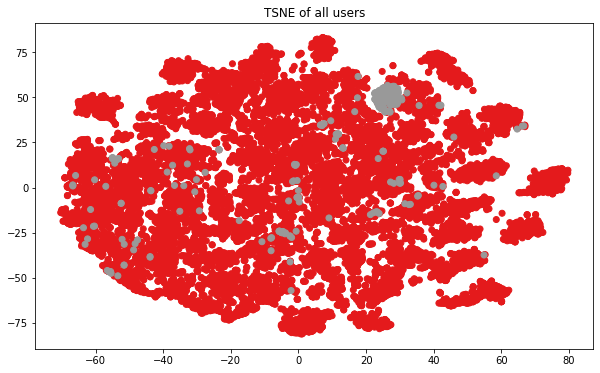

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


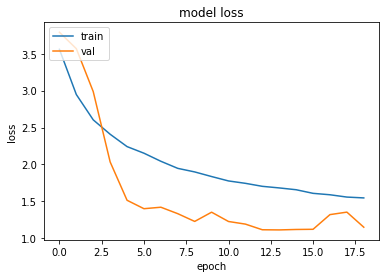

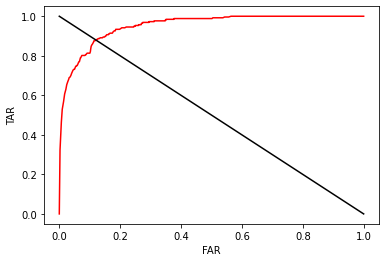

s015
(13484, 21)
(26350, 21)
(6957, 21)


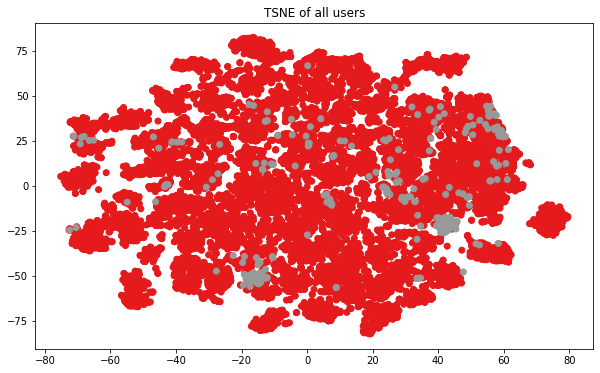

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


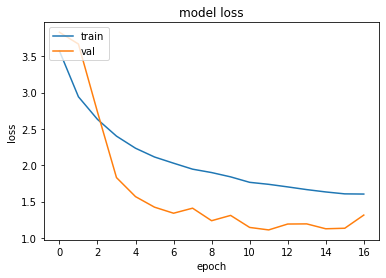

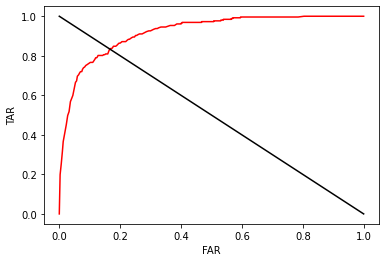

s016
(13484, 21)
(26350, 21)
(6957, 21)


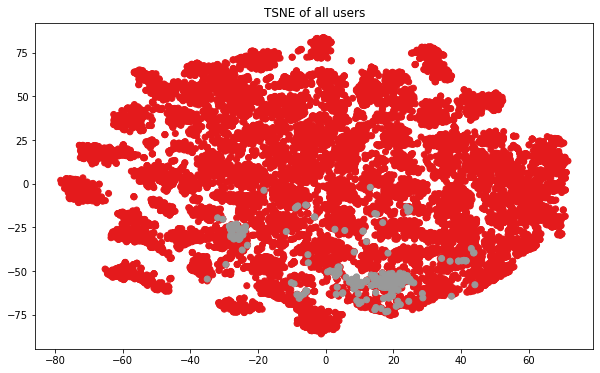

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


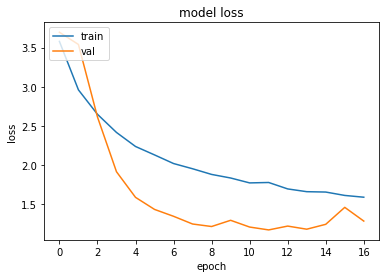

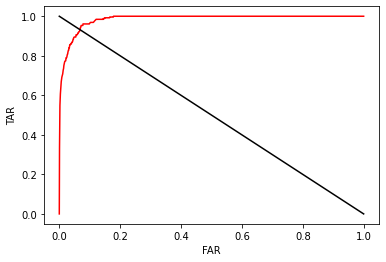

s017
(13484, 21)
(26350, 21)
(6957, 21)


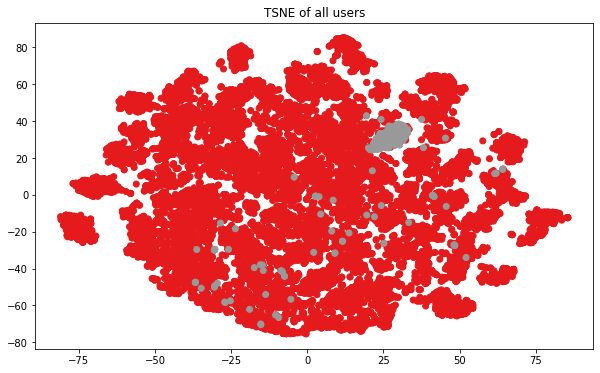

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


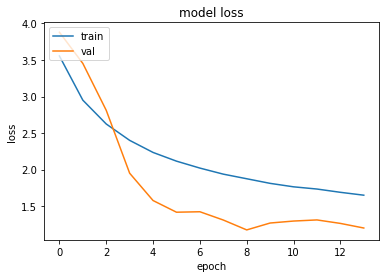

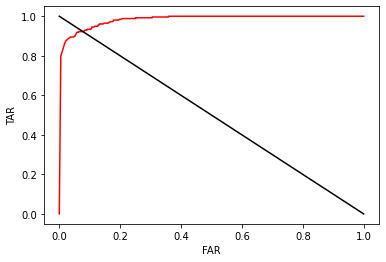

s018
(13484, 21)
(26350, 21)
(6957, 21)


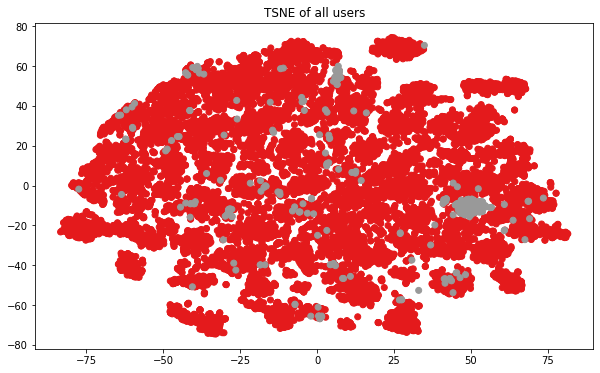

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


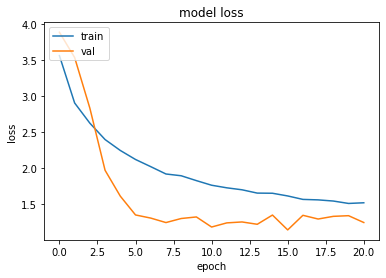

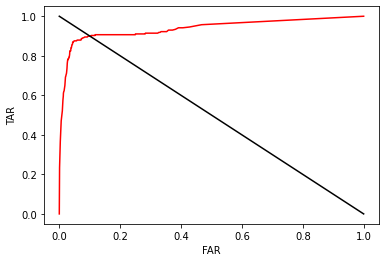

s019
(13484, 21)
(26350, 21)
(6957, 21)


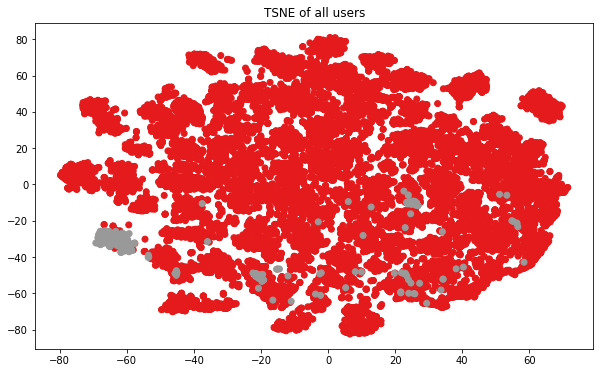

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


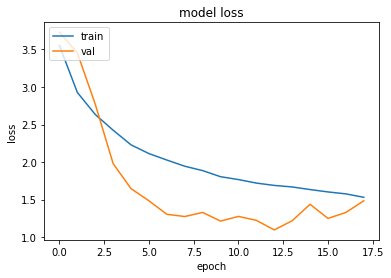

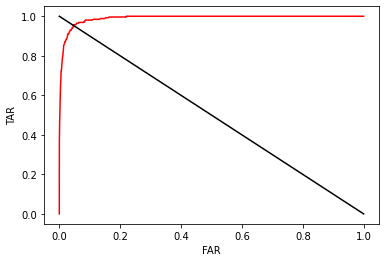

s020
(13484, 21)
(26350, 21)
(6957, 21)


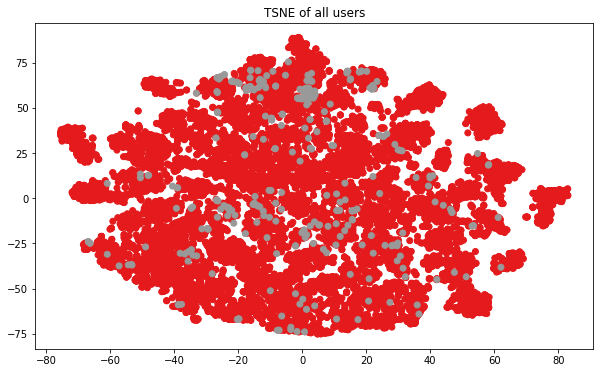

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


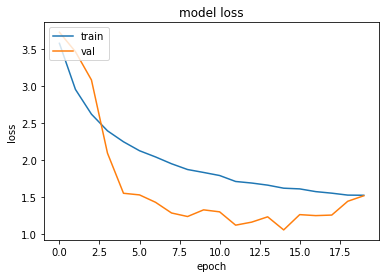

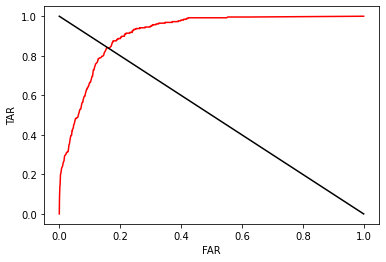

s021
(13484, 21)
(26350, 21)
(6957, 21)


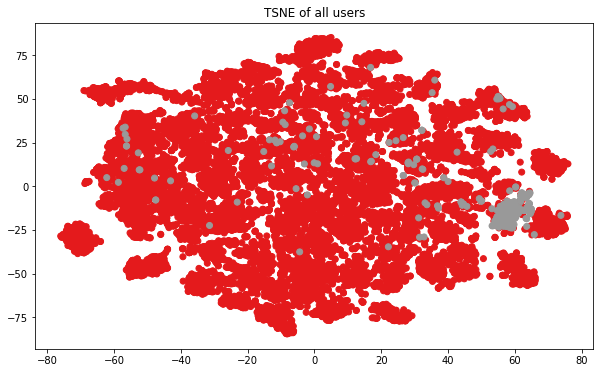

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


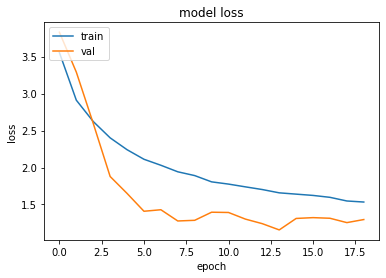

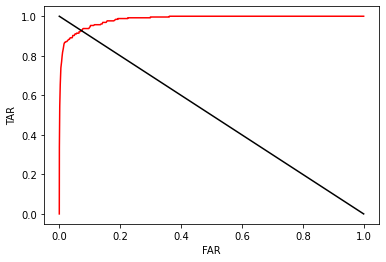

s022
(13484, 21)
(26350, 21)
(6957, 21)


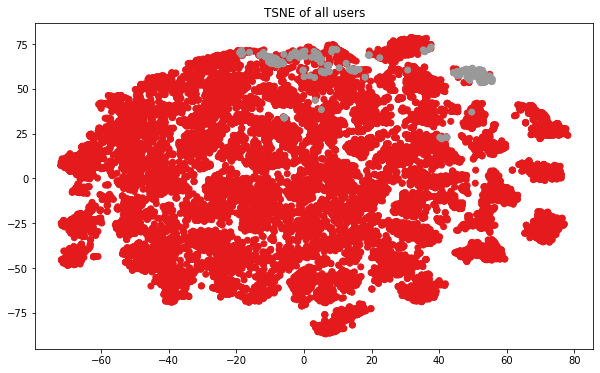

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


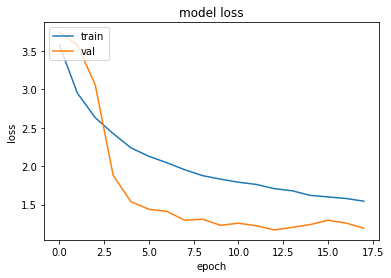

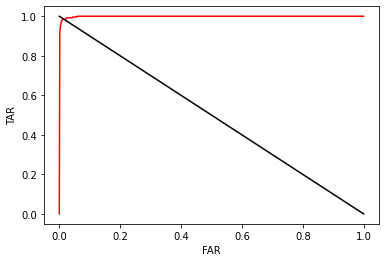

s024
(13484, 21)
(26350, 21)
(6957, 21)


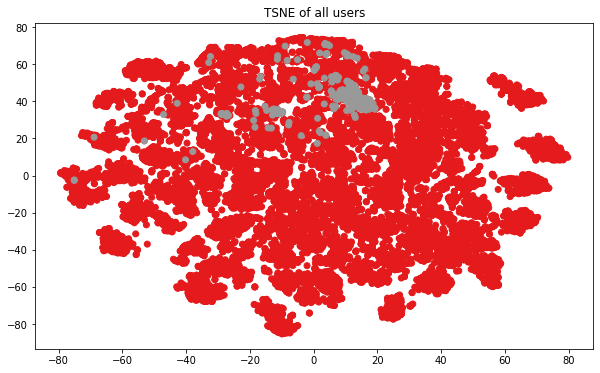

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


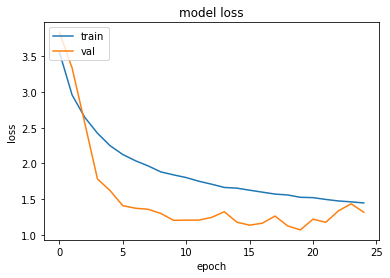

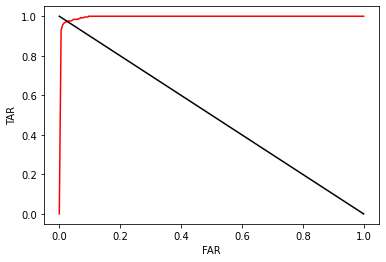

s025
(13484, 21)
(26350, 21)
(6957, 21)


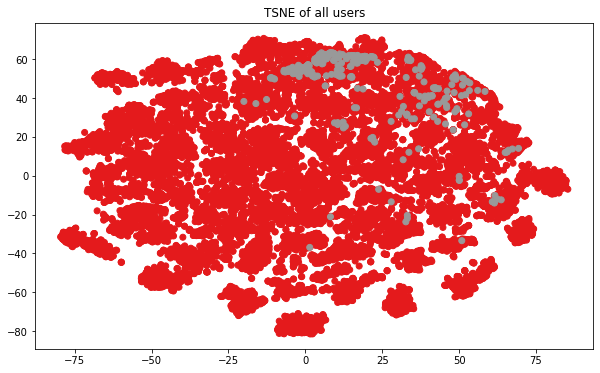

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


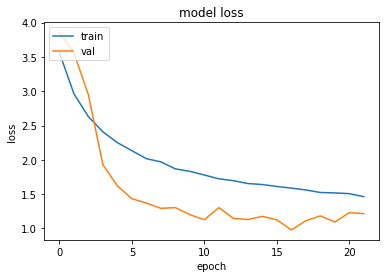

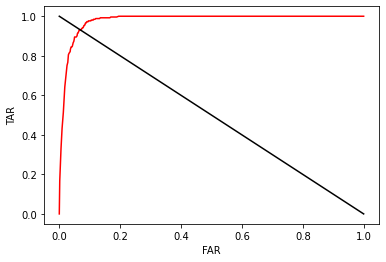

s026
(13484, 21)
(26350, 21)
(6957, 21)


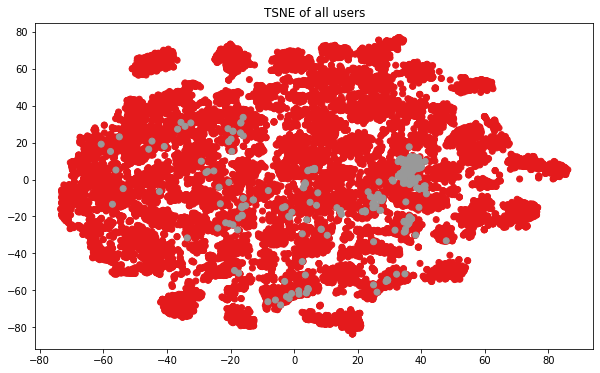

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


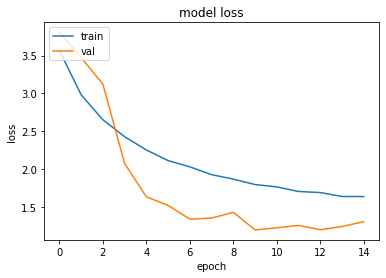

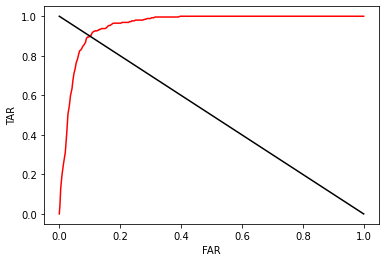

s027
(13484, 21)
(26350, 21)
(6957, 21)


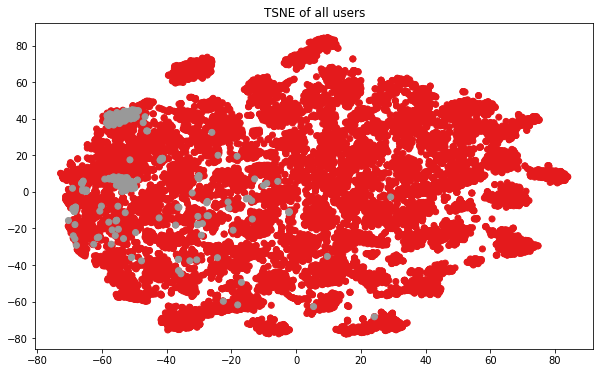

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


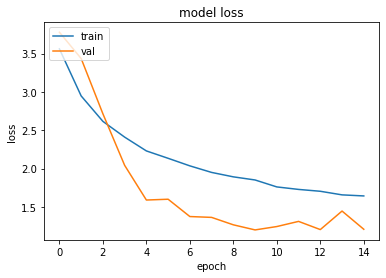

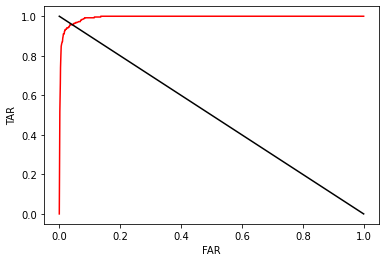

s028
(13484, 21)
(26350, 21)
(6957, 21)


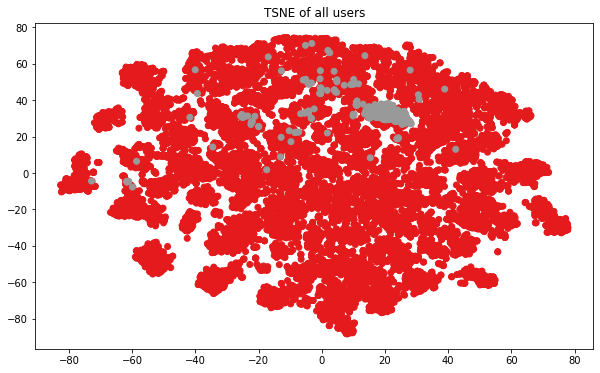

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


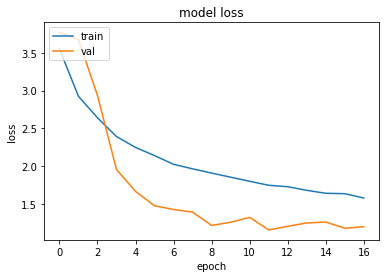

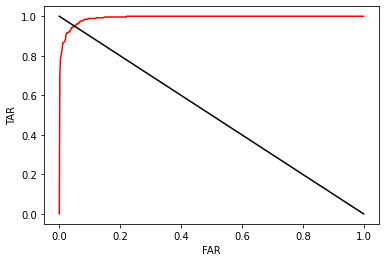

s029
(13484, 21)
(26350, 21)
(6957, 21)


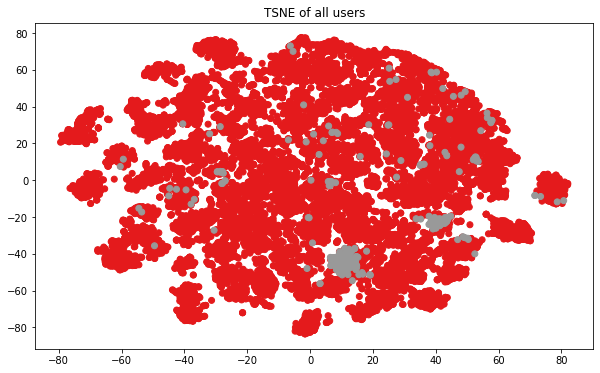

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


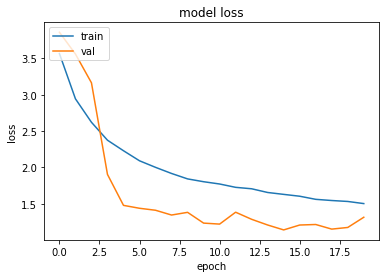

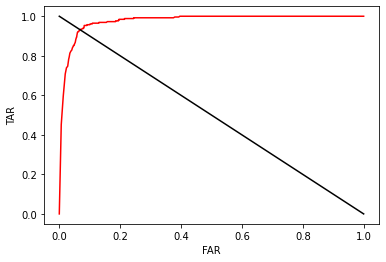

s030
(13484, 21)
(26350, 21)
(6957, 21)


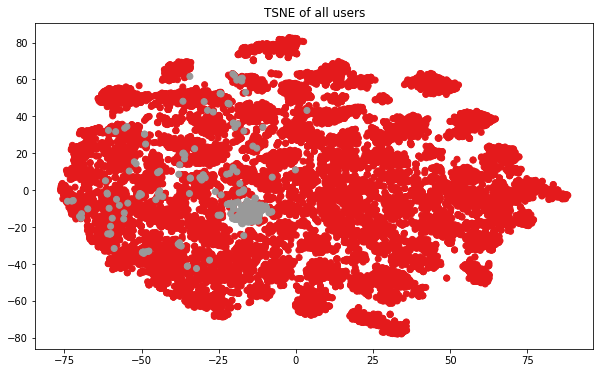

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


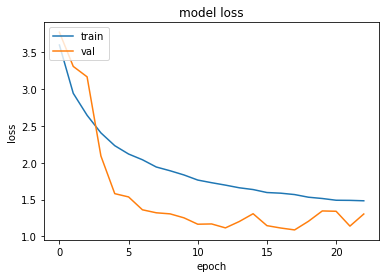

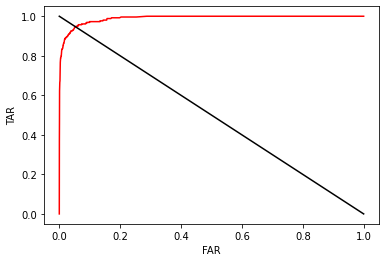

s031
(13484, 21)
(26350, 21)
(6957, 21)


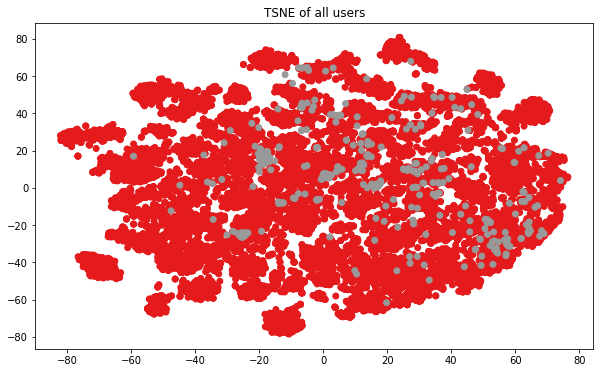

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


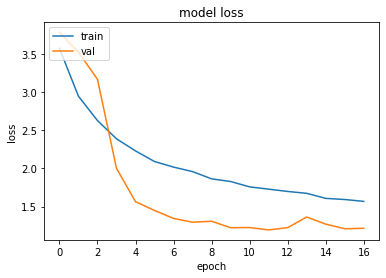

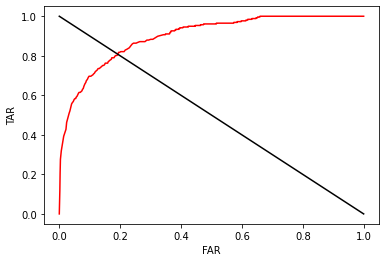

s032
(13484, 21)
(26350, 21)
(6957, 21)


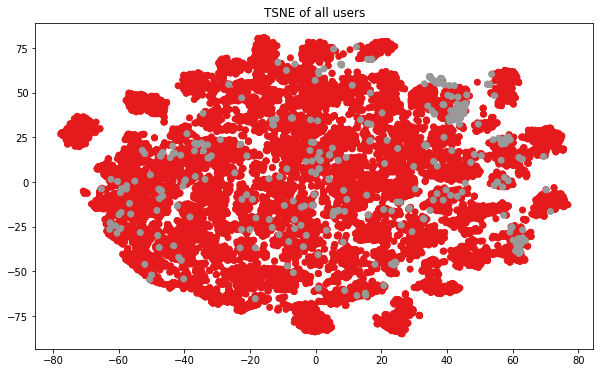

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


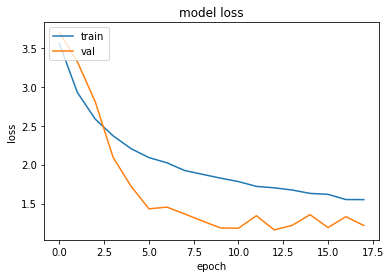

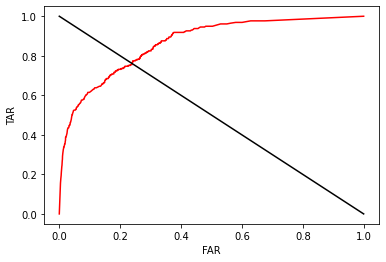

s033
(13484, 21)
(26350, 21)
(6957, 21)


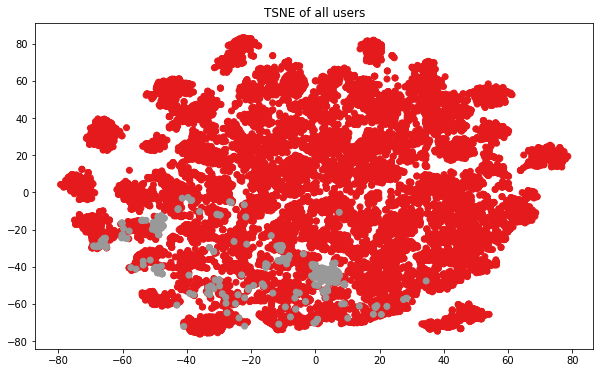

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


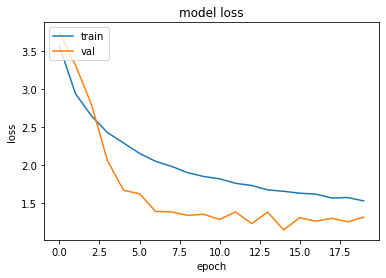

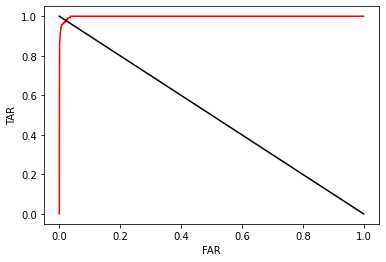

s034
(13484, 21)
(26350, 21)
(6957, 21)


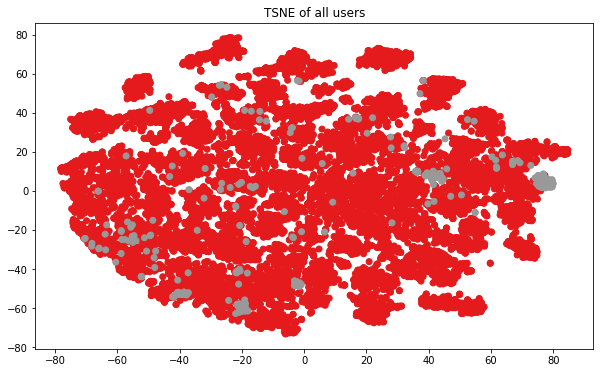

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


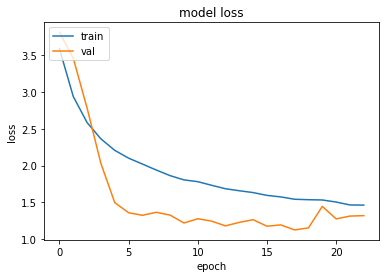

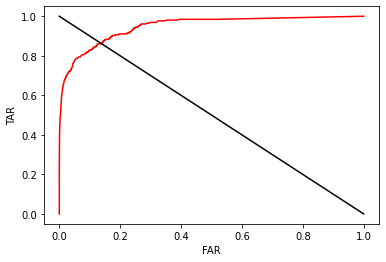

s035
(13484, 21)
(26350, 21)
(6957, 21)


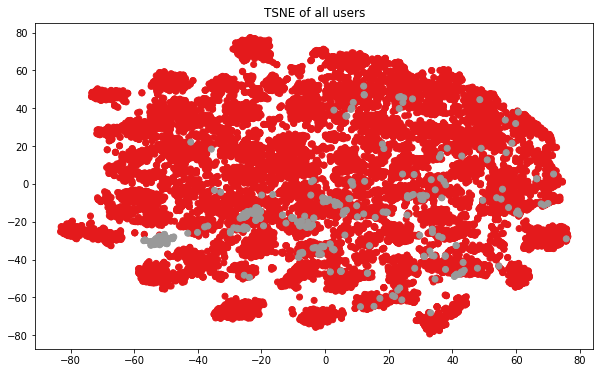

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


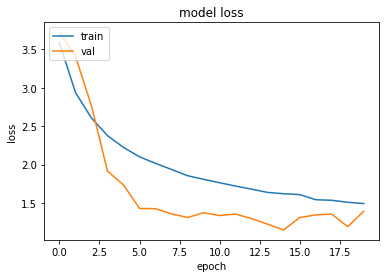

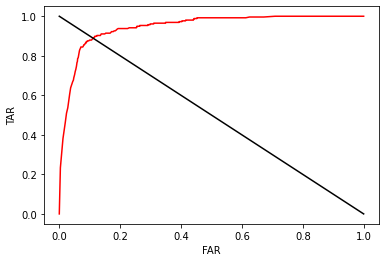

s036
(13484, 21)
(26350, 21)
(6957, 21)


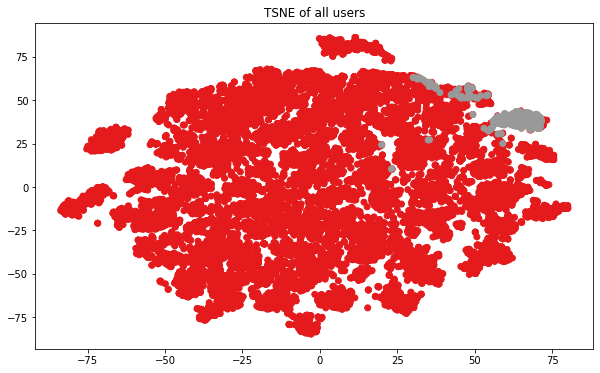

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


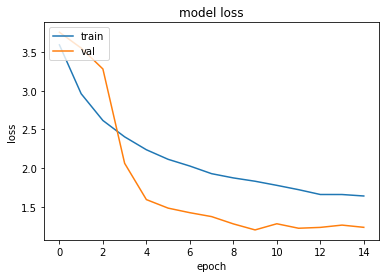

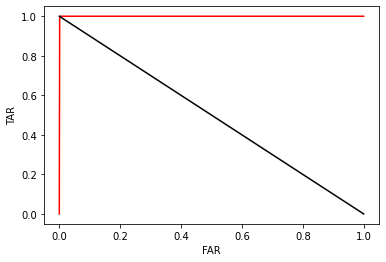

s037
(13484, 21)
(26350, 21)
(6957, 21)


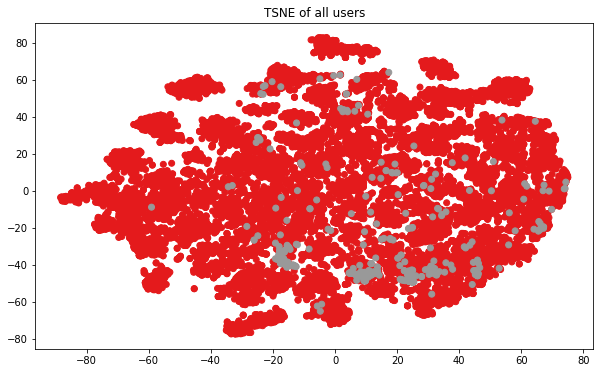

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


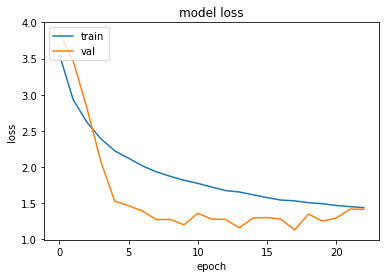

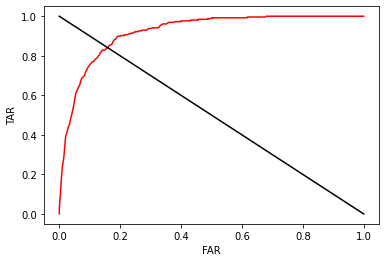

s038
(13484, 21)
(26350, 21)
(6957, 21)


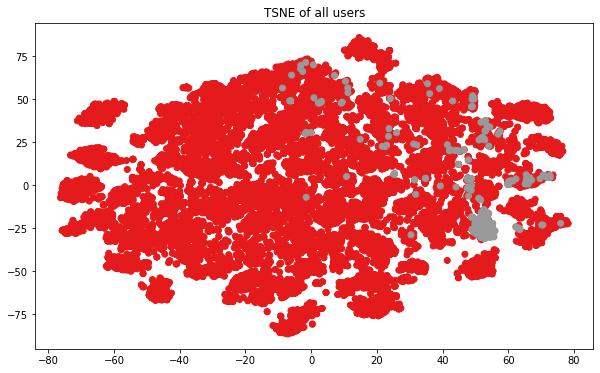

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


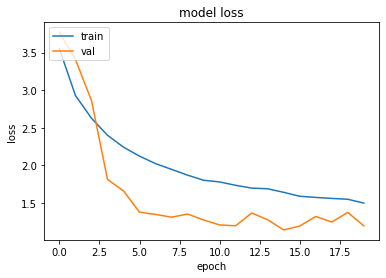

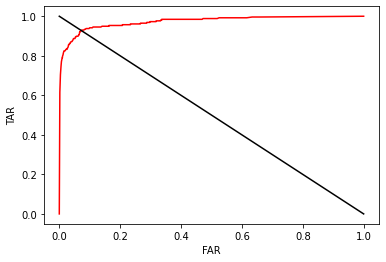

s039
(13484, 21)
(26350, 21)
(6957, 21)


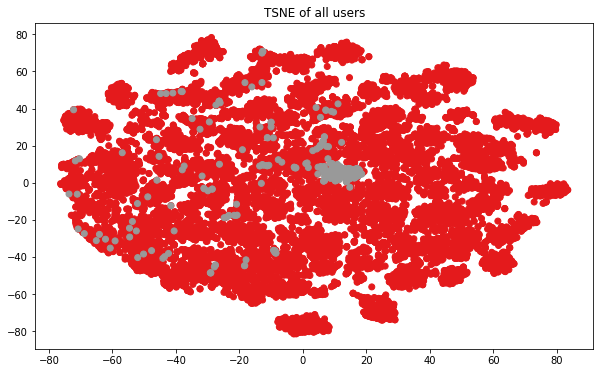

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


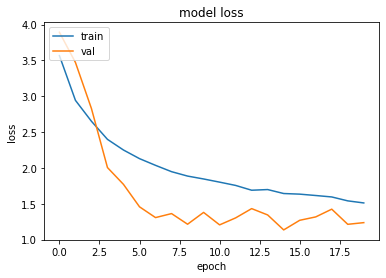

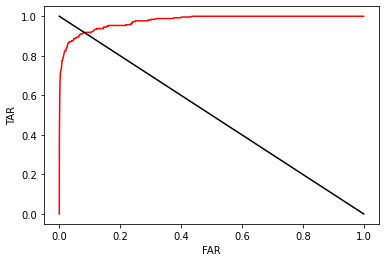

s040
(13484, 21)
(26350, 21)
(6957, 21)


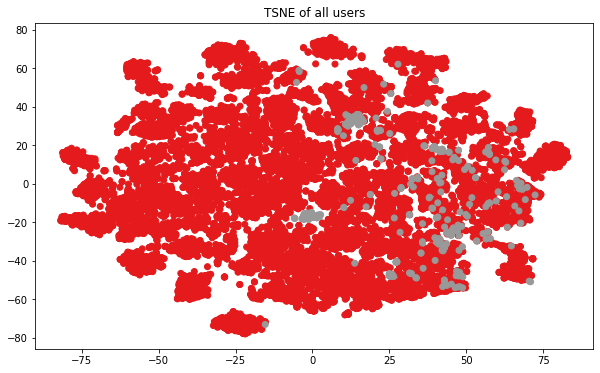

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


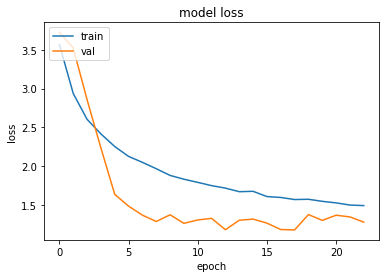

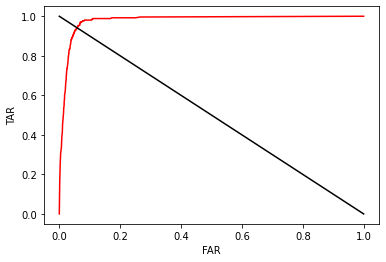

s041
(13484, 21)
(26350, 21)
(6957, 21)


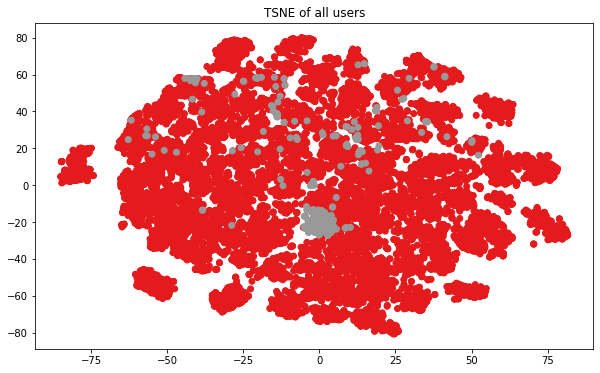

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


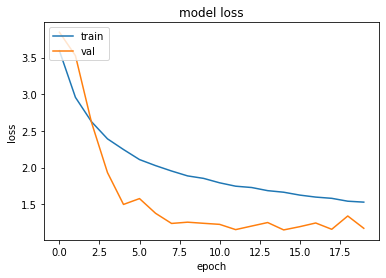

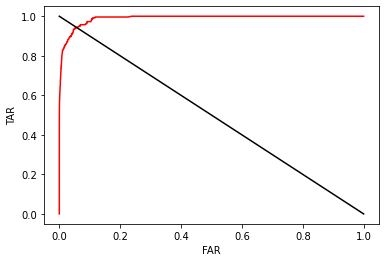

s042
(13484, 21)
(26350, 21)
(6957, 21)


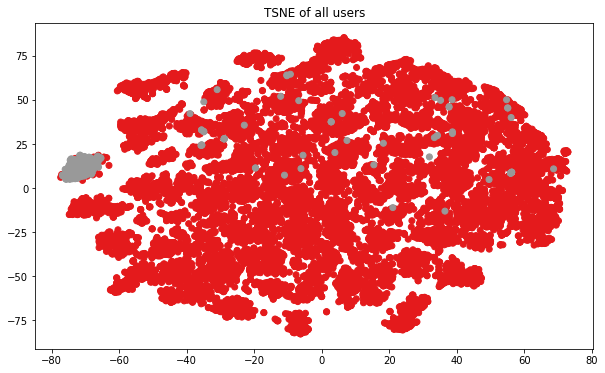

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


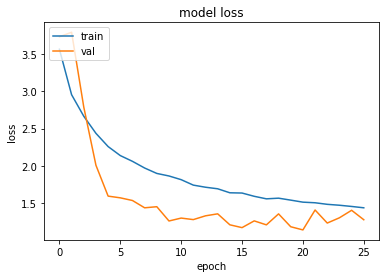

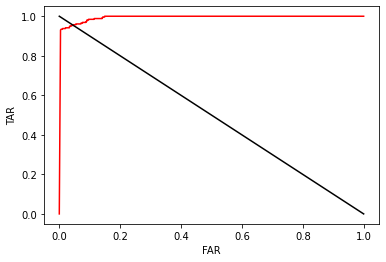

s043
(13484, 21)
(26350, 21)
(6957, 21)


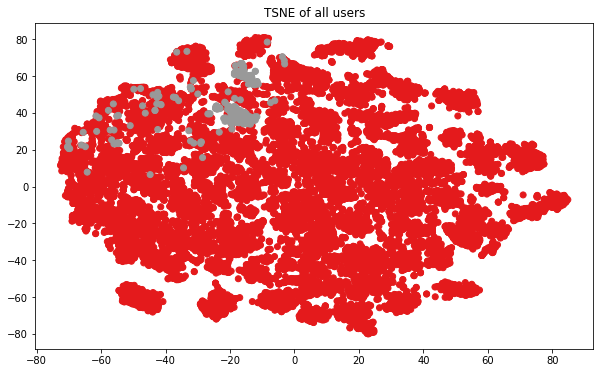

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


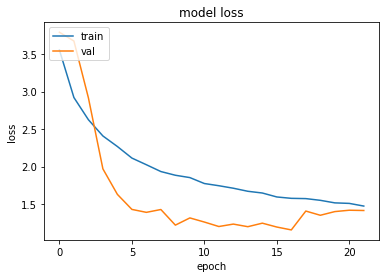

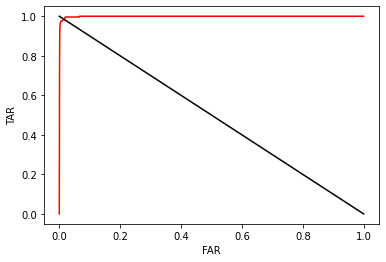

s044
(13484, 21)
(26350, 21)
(6957, 21)


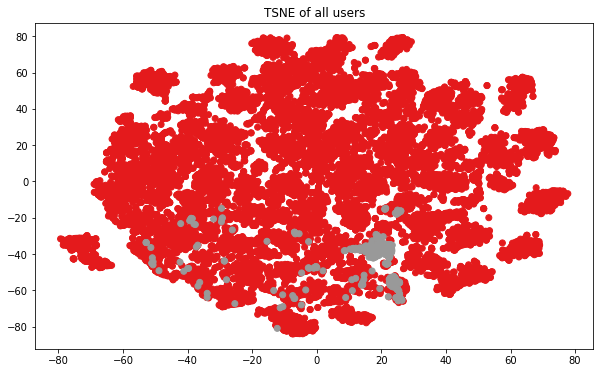

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


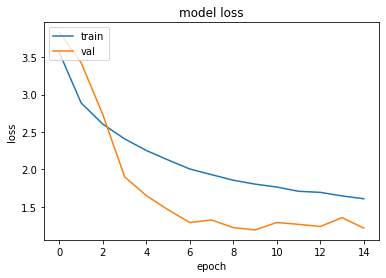

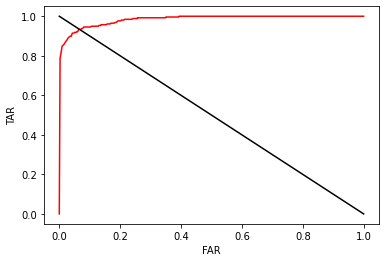

s046
(13484, 21)
(26350, 21)
(6957, 21)


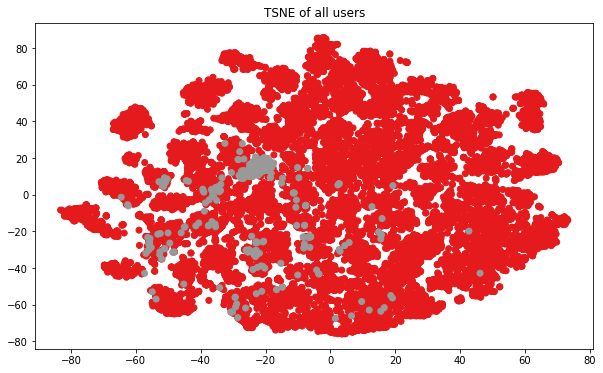

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


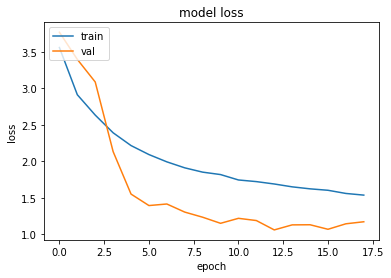

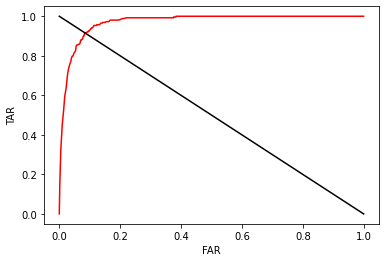

s047
(13484, 21)
(26350, 21)
(6957, 21)


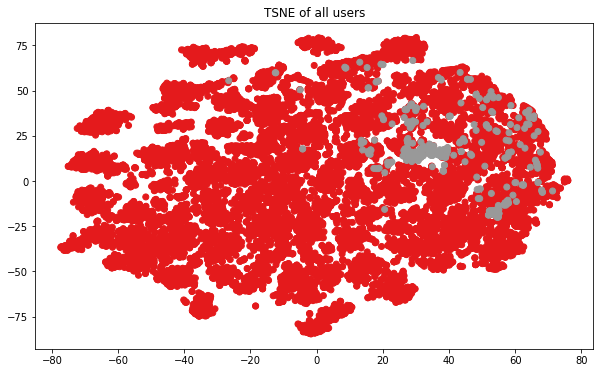

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


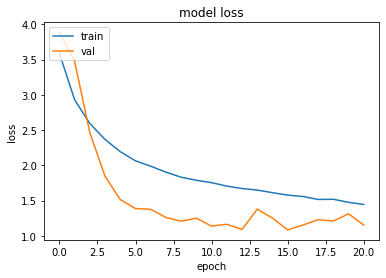

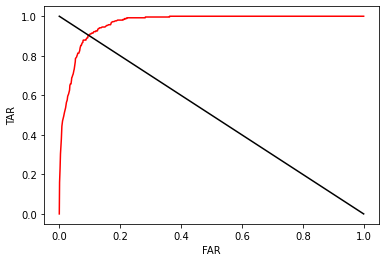

s048
(13484, 21)
(26350, 21)
(6957, 21)


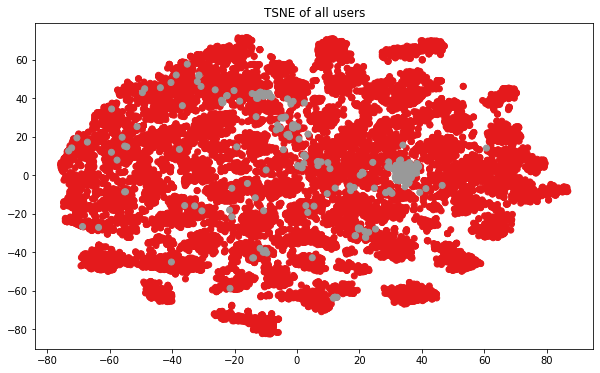

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


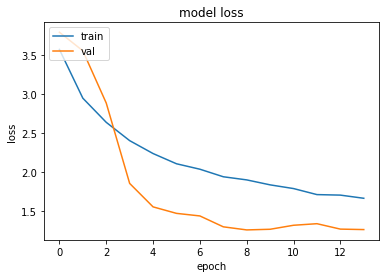

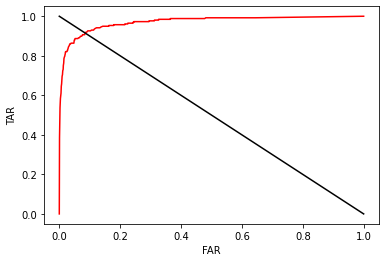

s049
(13484, 21)
(26350, 21)
(6957, 21)


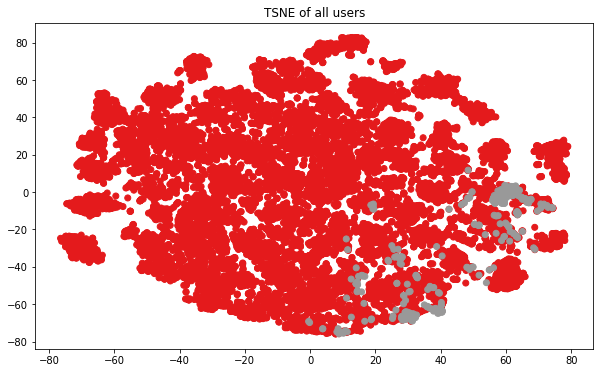

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


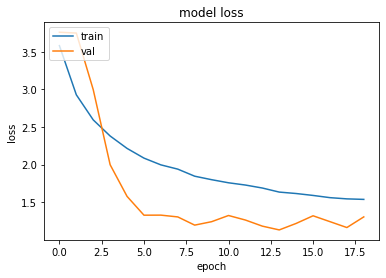

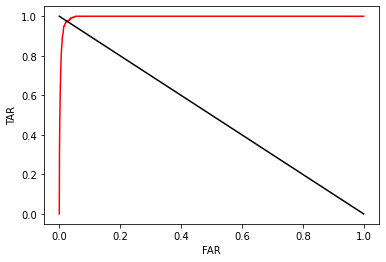

s050
(13484, 21)
(26350, 21)
(6957, 21)


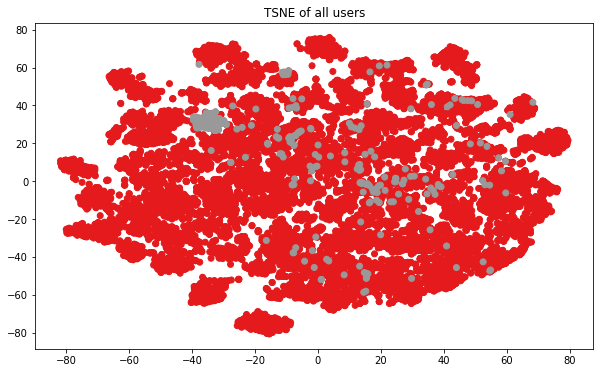

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


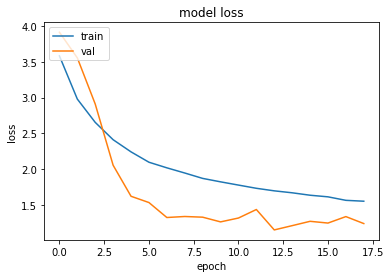

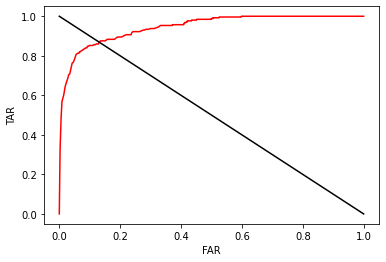

s051
(13484, 21)
(26350, 21)
(6957, 21)


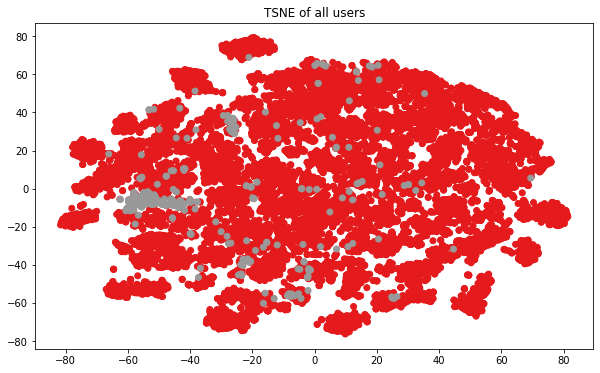

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


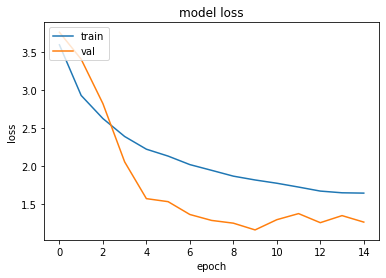

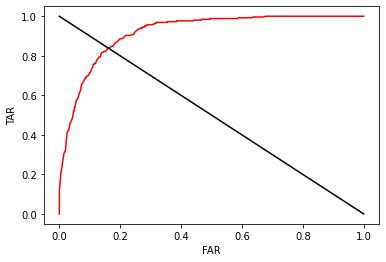

s052
(13484, 21)
(26350, 21)
(6957, 21)


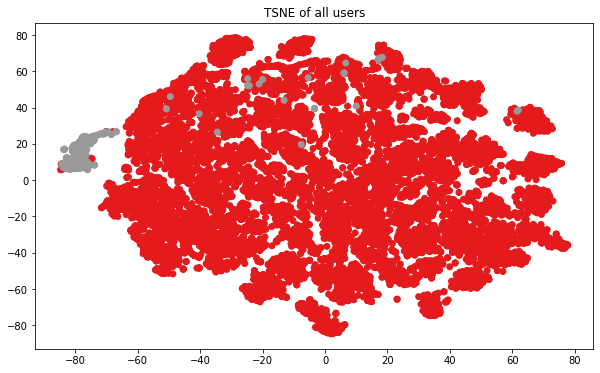

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


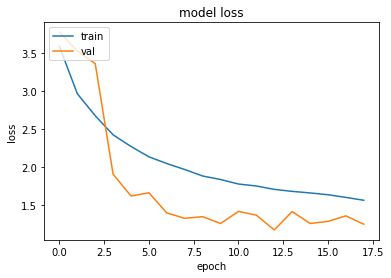

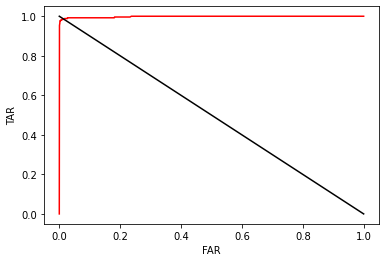

s053
(13484, 21)
(26350, 21)
(6957, 21)


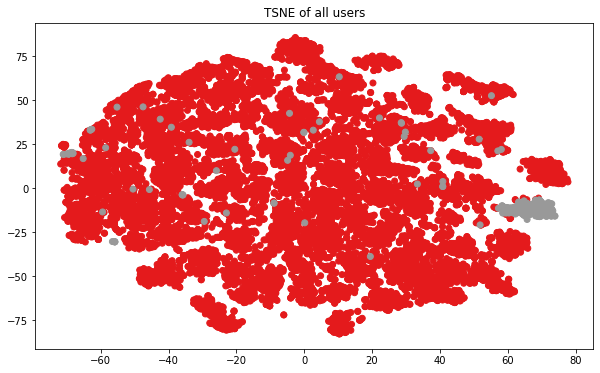

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


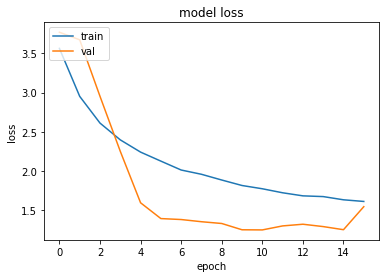

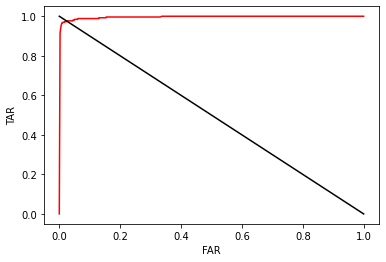

s054
(13484, 21)
(26350, 21)
(6957, 21)


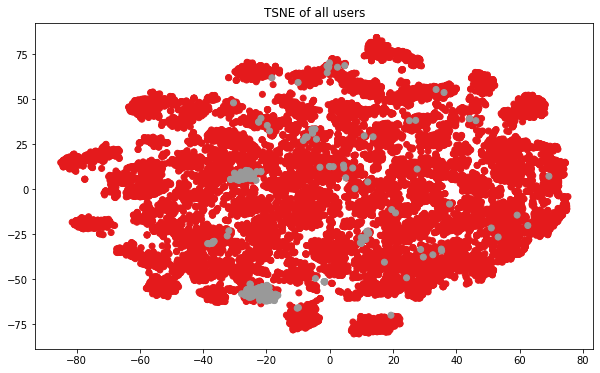

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


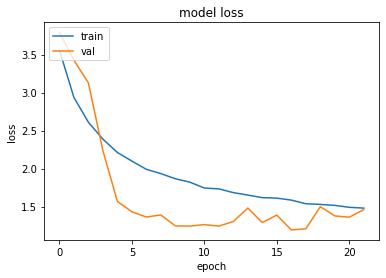

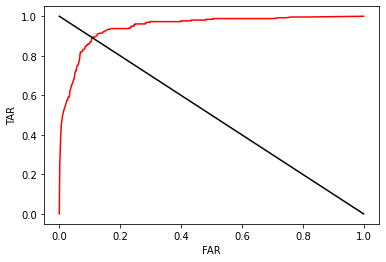

s055
(13484, 21)
(26350, 21)
(6957, 21)


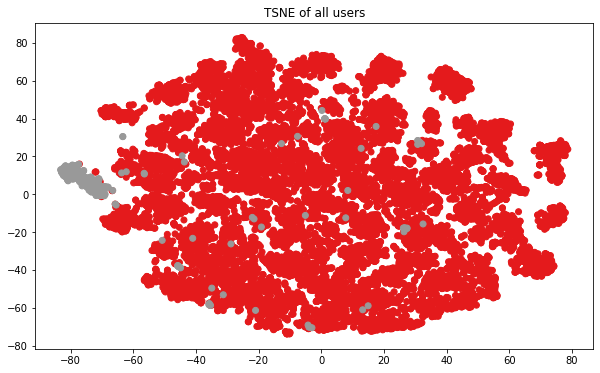

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


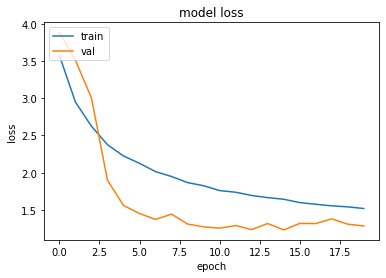

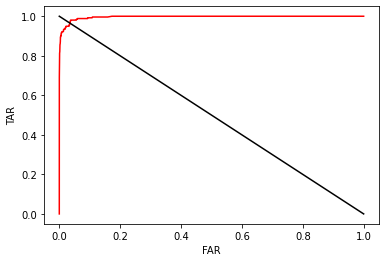

s056
(13484, 21)
(26350, 21)
(6957, 21)


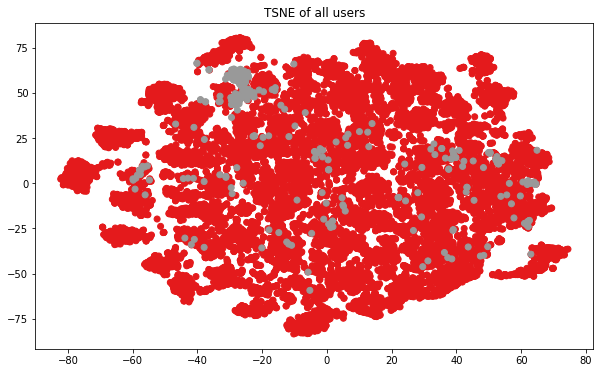

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


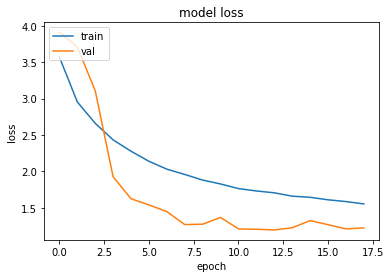

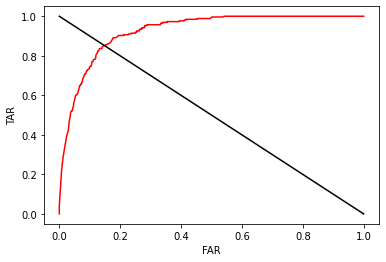

s057
(13484, 21)
(26350, 21)
(6957, 21)


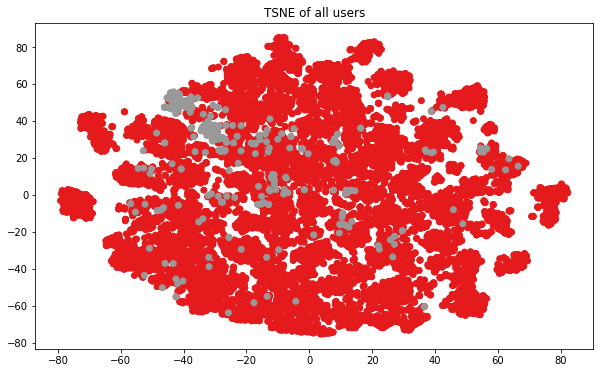

X_train.shape (13484, 9, 812)
Y_train_encoded.shape (13484, 51)


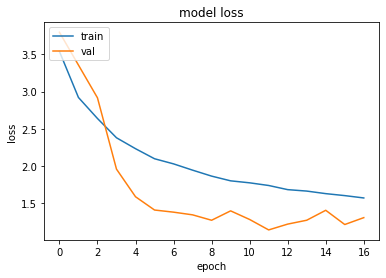

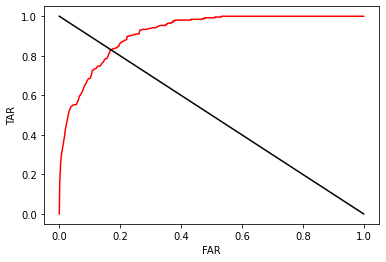

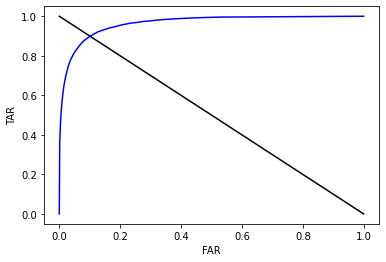

0.8993667505912868 TAR and 0.10212467076382793 FAR achieved at threshold: 0.3340000000000001


In [ ]:
thresholds = np.concatenate([np.linspace(0, 0.05, 1001), np.linspace(0.05, 0.1, 101), np.linspace(0.1, 1, 101)]) #np.linspace(0, 1, 1001)
TAR_progression, FAR_progression = np.zeros(len(thresholds)), np.zeros(len(thresholds))
for individual in individuals: # 51 individuals total
  print(individual)
  tmp_TAR_progression, tmp_FAR_progression = test_lstm_on_user(individual, thresholds, verbose=0)
  TAR_progression = TAR_progression + tmp_TAR_progression
  FAR_progression = FAR_progression + tmp_FAR_progression
  plt.plot(tmp_FAR_progression,
         tmp_TAR_progression,
         color="red")
  plt.xlabel("FAR")
  plt.ylabel("TAR")
  plt.plot(np.linspace(0, 1, 2), np.linspace(1, 0, 2), color = "black")
  plt.show()
TAR_progression = TAR_progression / len(individuals)
FAR_progression = FAR_progression / len(individuals)
plt.plot(FAR_progression,
         TAR_progression,
         color="blue")
plt.xlabel("FAR")
plt.ylabel("TAR")
plt.plot(np.linspace(0, 1, 2), np.linspace(1, 0, 2), color = "black")
plt.show()

best_index = np.argmin(abs(1 - (TAR_progression + FAR_progression)))
best_threshold = thresholds[best_index]
# Best Threshold(s): 0.334
print("{} TAR and {} FAR achieved at threshold: {}".format(TAR_progression[best_index], FAR_progression[best_index], best_threshold))

# Completely new models for individuals

# Designing model to take survey inputs
(this website explains the cuDNN warnings) https://www.tensorflow.org/api_docs/python/tf/keras/layers/GRU#used-in-the-notebooks_1

In [ ]:
from keras.layers import BatchNormalization

# fit and evaluate an LSTM model
def generate_lstm_model(trainX, trainy, verbose=0):
  epochs, batch_size = 100, 64
  n_outputs = trainy.shape[1]
  callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
  model = Sequential()
  model.add(BatchNormalization(name="normalization_layer")) # each input becomes relative to other inputs of given batch
  model.add(LSTM(75, input_shape=(9,812), dropout = 0.3, recurrent_dropout=0.3, name="lstm_layer"))
  model.add(Dropout(0.3))
  model.add(Dense(150, activation='relu', name="dense_intermediate"))
  model.add(Dropout(0.3))
  model.add(Dense(n_outputs, activation='softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  # fit network
  history = model.fit(trainX, trainy, epochs=epochs, validation_split=0.2, batch_size=batch_size, callbacks=[callback], verbose=verbose)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  if verbose == 1:
    model.summary()
  return model

In [ ]:
from sklearn.manifold import TSNE
import umap

def plot_embeddings(results, labels):
  # TSNE
  tsne = TSNE()
  tsne_results = tsne.fit_transform(results)

  tsne_1 = tsne_results[:,0]
  tsne_2 = tsne_results[:,1]
  plt.figure(figsize=(10,6))
  plt.scatter(tsne_1, tsne_2, c = labels, cmap = "Set1")
  plt.title("TSNE of all users")
  plt.show()

In [ ]:
def test_lstm_on_user(loo_user, threshold_progression, verbose):
  initial_train_data = []
  loo_retrain_data = []
  loo_test_data = []

  num_samples_to_train_on = 10
  non_loo_users = individuals[individuals != loo_user]
  # randomize non_loo_users order
  random.shuffle(non_loo_users)
  train_non_loo_users = non_loo_users[:int(2*len(non_loo_users)/3)]
  test_non_loo_users = non_loo_users[int(2*len(non_loo_users)/3):]

  for user in individuals:
    if user == loo_user:
      data_randomized_user = data.loc[data["subject"] == user]
      data_randomized_user.reset_index(inplace=True, drop=True)
      true_retrain_data = data_randomized_user.loc[:num_samples_to_train_on - 1]
      loo_retrain_data.append(true_retrain_data)
      for i in range(1300):
        loo_retrain_data.append(true_retrain_data)

      # Addding randomly generated data
      #loo_retrain_data.append(generate_lognormal_attacks(data[data.columns[3:]], true_retrain_data[true_retrain_data.columns[3:]], 1300*10))

      loo_test_data.append(data_randomized_user.loc[num_samples_to_train_on:].sample(frac=1, random_state = random_seed))
    if user in train_non_loo_users:
      data_randomized_user = data.loc[data["subject"] == user].sample(frac=1, random_state = random_seed)
      data_randomized_user.reset_index(inplace=True, drop=True)
      initial_train_data.append(data_randomized_user)
      loo_retrain_data.append(data_randomized_user)
    if user in test_non_loo_users:
      data_randomized_user = data.loc[data["subject"] == user].sample(frac=1, random_state = random_seed)
      data_randomized_user.reset_index(inplace=True, drop=True)
      loo_test_data.append(data_randomized_user)


  initial_train_data = concat_and_randomize_data(initial_train_data)
  print("initial_train_data.shape", initial_train_data.shape)
  loo_retrain_data = concat_and_randomize_data(loo_retrain_data)
  print("retrain_data.shape", loo_retrain_data.shape)
  loo_test_data = concat_and_randomize_data(loo_test_data)
  print("test_data.shape", loo_test_data.shape)

  X_train = initial_train_data[initial_train_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train)
  Y_train_encoded = assign_names_to_numbers(initial_train_data["subject"].copy())
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  print("X_train.shape", X_train.shape)
  print("Y_train_encoded.shape", Y_train_encoded.shape)

  model = generate_lstm_model(X_train, Y_train_encoded, verbose)

  # At this point, we have a trained model for known users

  X_train = loo_retrain_data[loo_retrain_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train) 
  Y_train_encoded = binary_classification(loo_retrain_data["subject"].copy(), loo_user)
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  new_model_layers = model.layers[:-1]
  for layer in new_model_layers:
    layer.trainable = False
  new_model = Sequential(new_model_layers)
  new_model.add(Dense(2, activation='softmax'))

  new_model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

  new_model.fit(X_train, Y_train_encoded, 
            batch_size=32, epochs=10, verbose=verbose, validation_split=0.2)
  if verbose == 1:
    new_model.summary()

  # We have now retrained the model for the new user against fake attempts

  X_test = loo_test_data[loo_test_data.columns[3:]]
  X_test = convert_to_matrix_representation(X_test) 
  Y_test_encoded = binary_classification(loo_test_data["subject"].copy(), loo_user)
  Y_test_encoded = Y_test_encoded.to_numpy()
  Y_test_encoded = to_categorical(Y_test_encoded)

  reals = np.argmax(Y_test_encoded, axis=1)
  predictions = new_model.predict(X_test)

  TAR_progression = []
  FAR_progression = []
  for threshold in threshold_progression:
    prediction_values = np.array([1 if predictions[i][1] > threshold else 0 for i in range(len(predictions))])
    
    conf_matrix = confusion_matrix(reals, prediction_values)
    TAR_progression.append(conf_matrix[1][1] / sum(conf_matrix[1]))
    FAR_progression.append(conf_matrix[0][1] / sum(conf_matrix[0]))
  return np.array(TAR_progression), np.array(FAR_progression)

s002
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


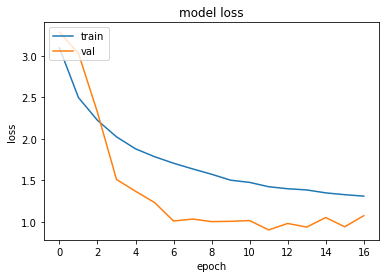

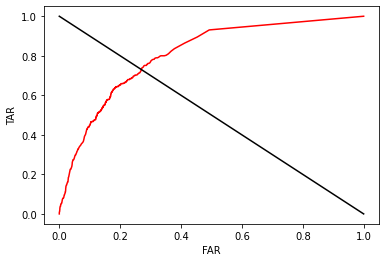

s003
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


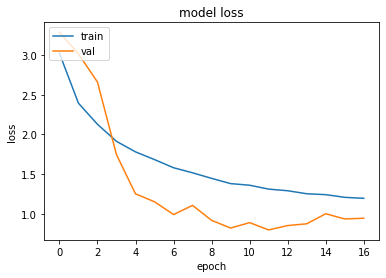

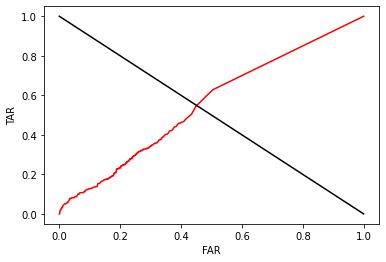

s004
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


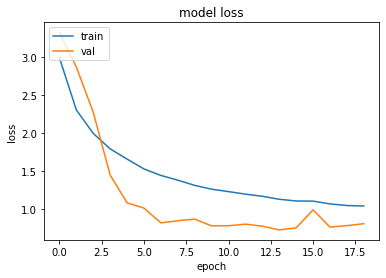

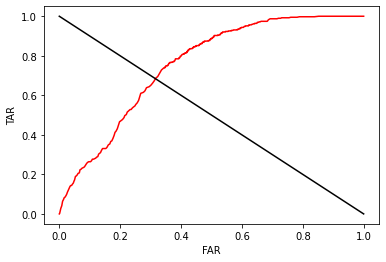

s005
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


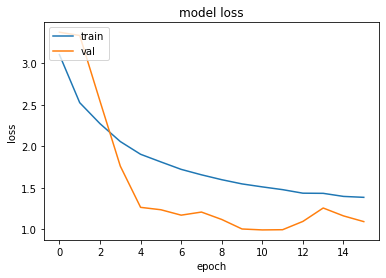

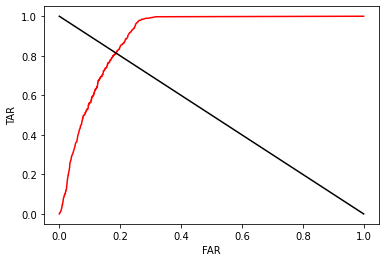

s007
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


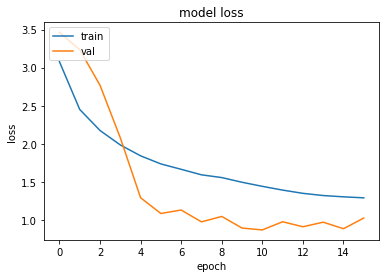

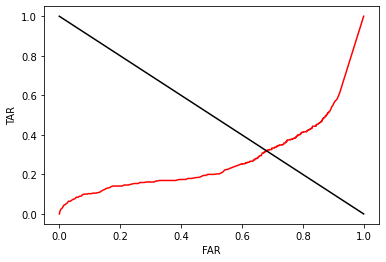

s008
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


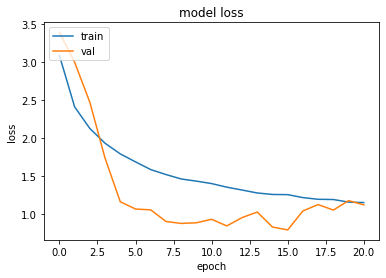

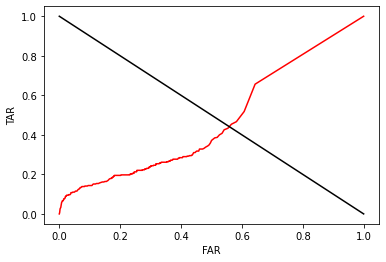

s010
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


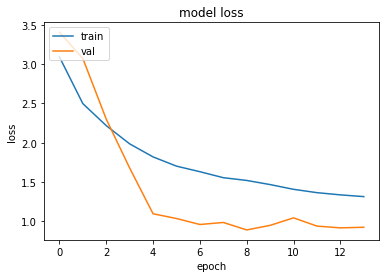

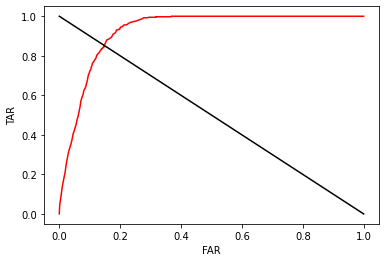

s011
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


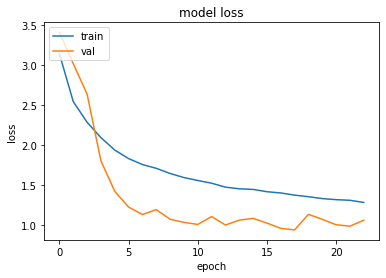

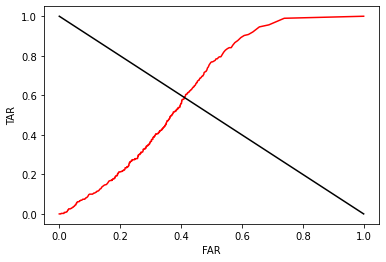

s012
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


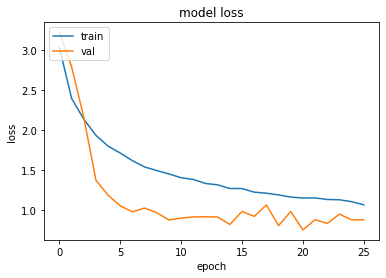

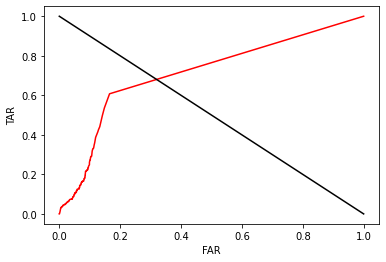

s013
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


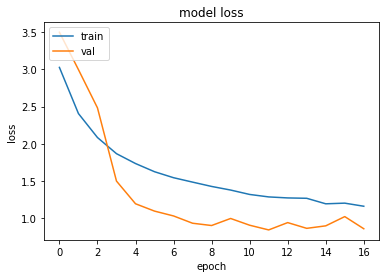

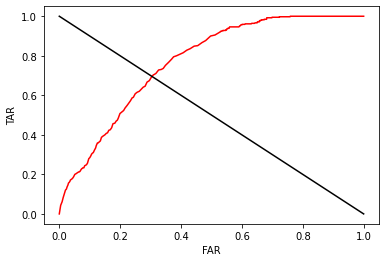

s015
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


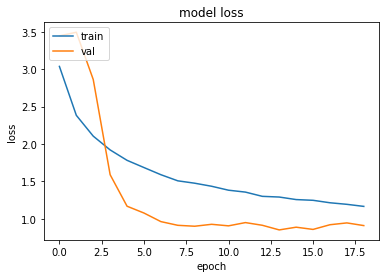

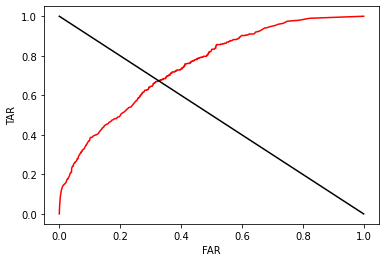

s016
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


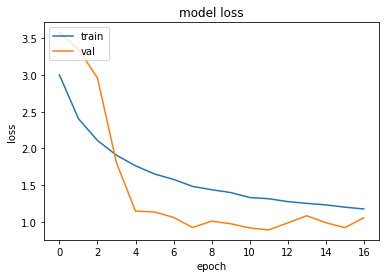

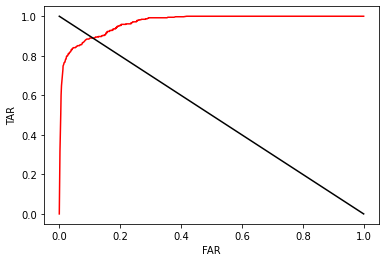

s017
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


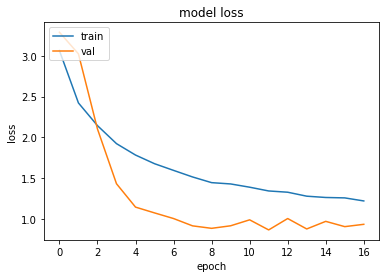

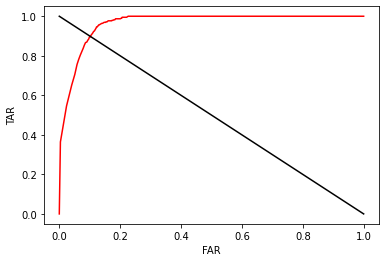

s018
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


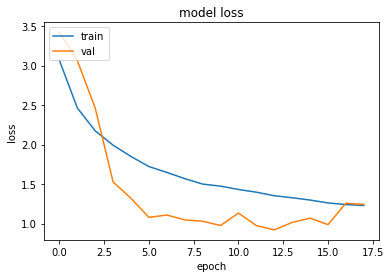

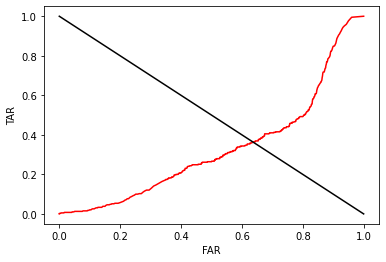

s019
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


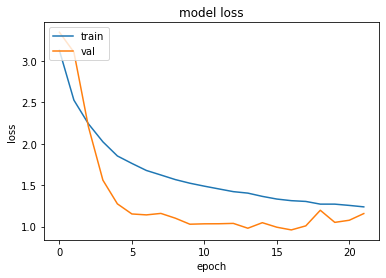

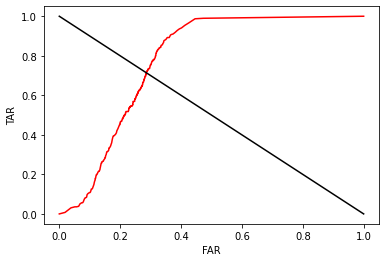

s020
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


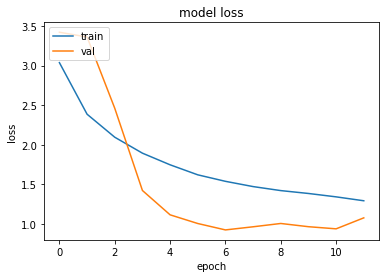

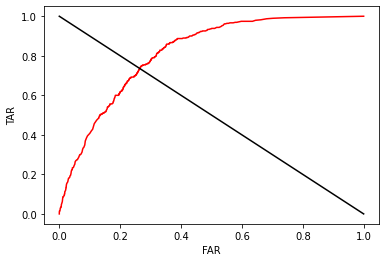

s021
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


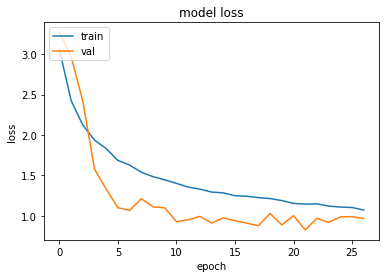

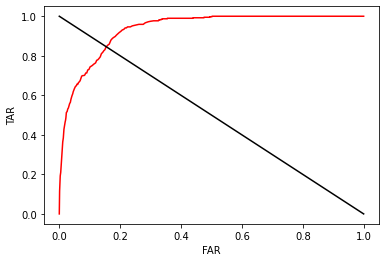

s022
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


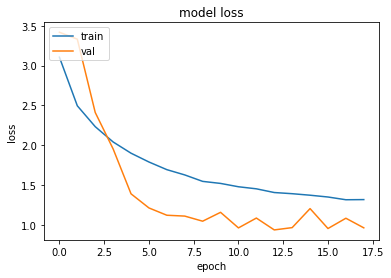

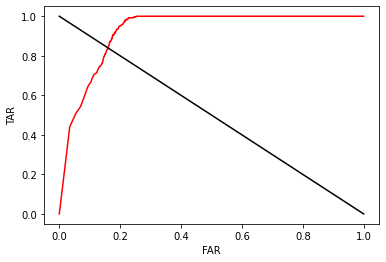

s024
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


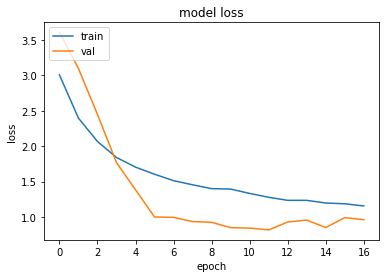

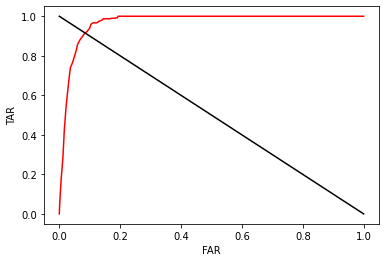

s025
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


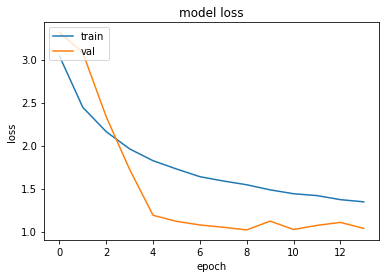

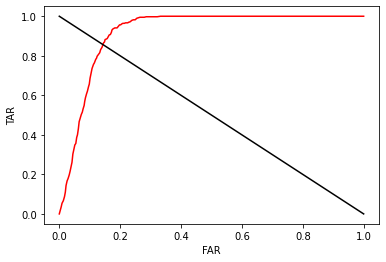

s026
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


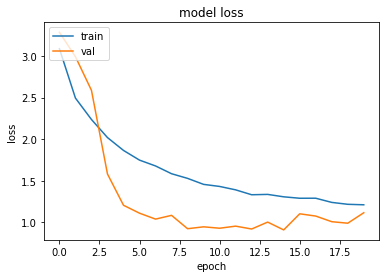

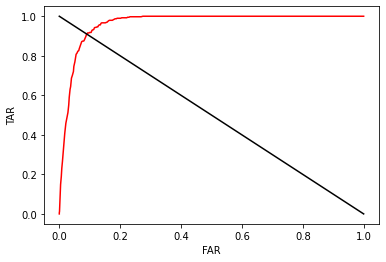

s027
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


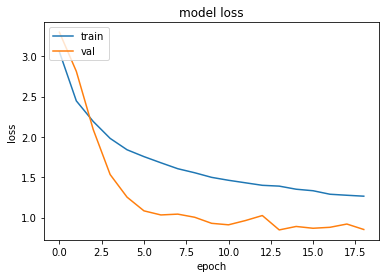

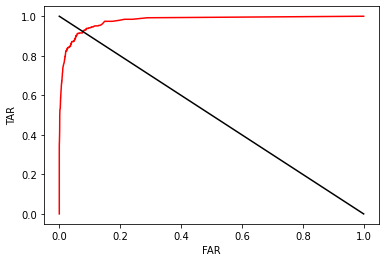

s028
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


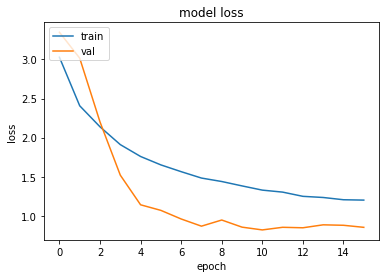

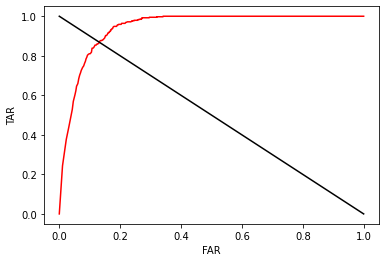

s029
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


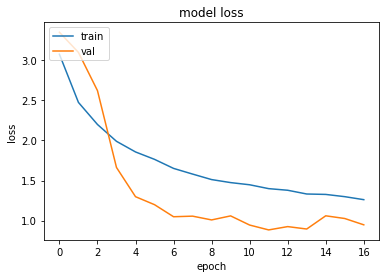

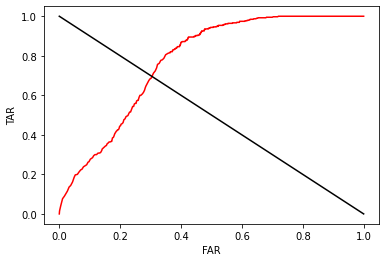

s030
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


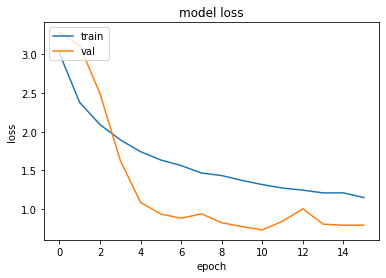

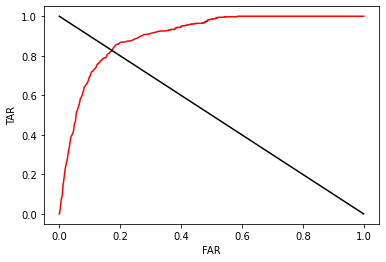

s031
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


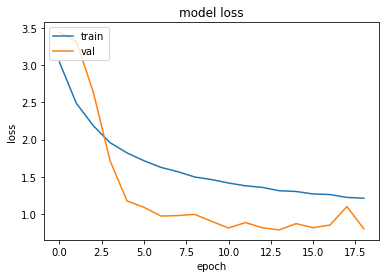

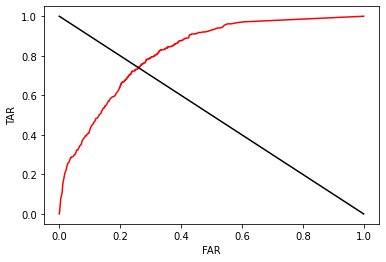

s032
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


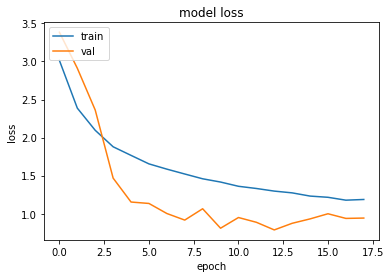

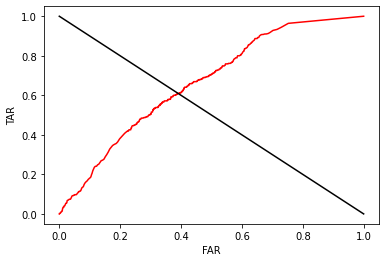

s033
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


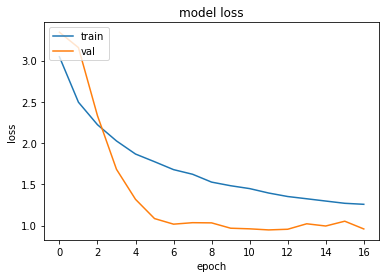

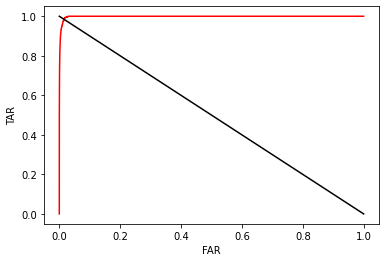

s034
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


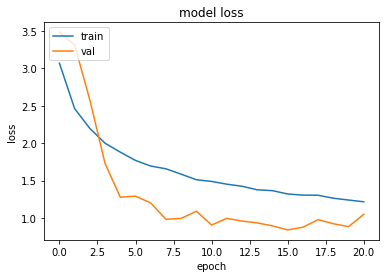

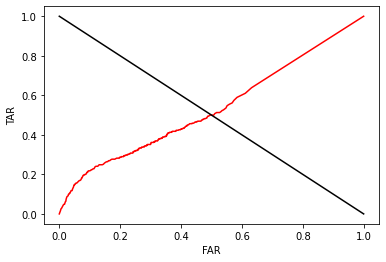

s035
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


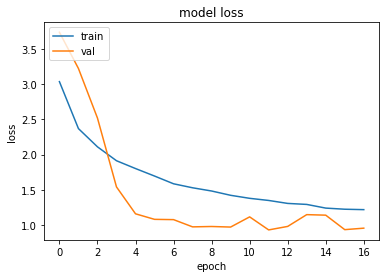

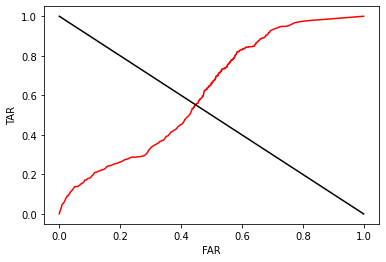

s036
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


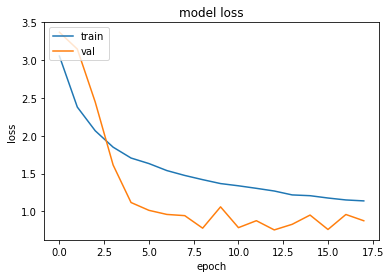

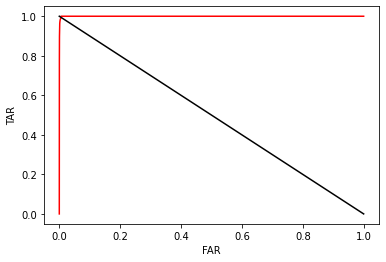

s037
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


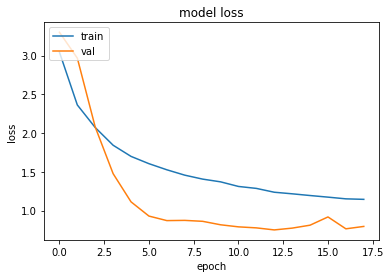

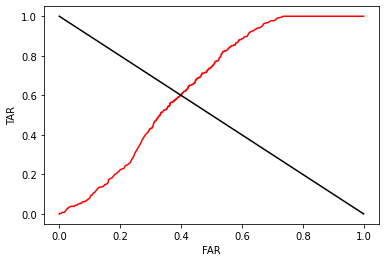

s038
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


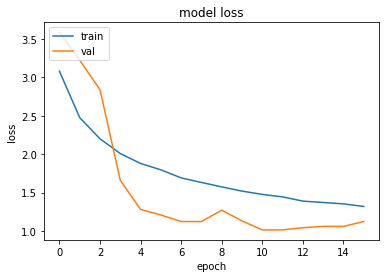

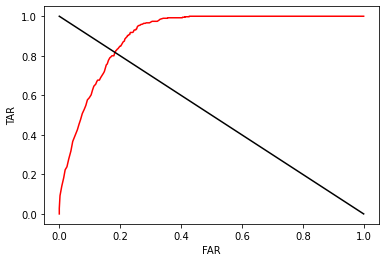

s039
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


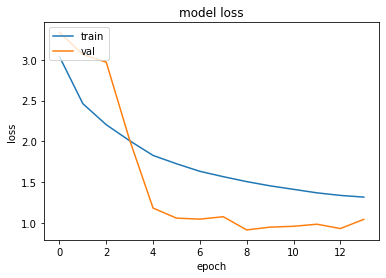

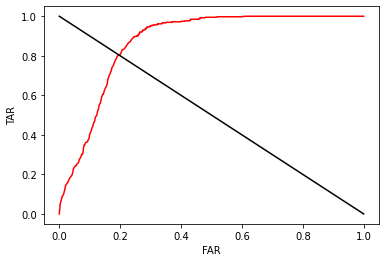

s040
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


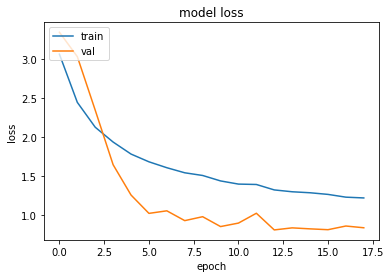

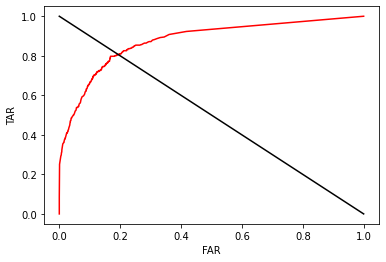

s041
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


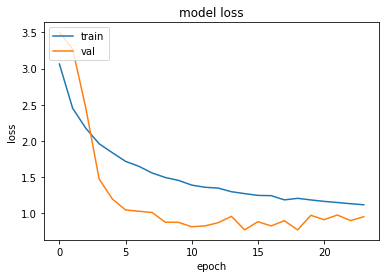

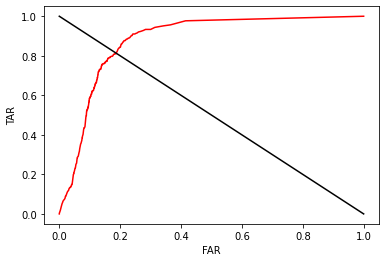

s042
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


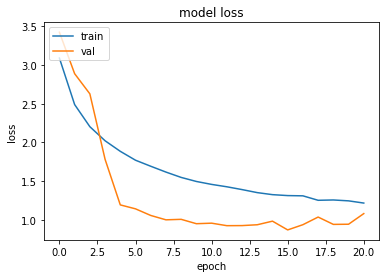

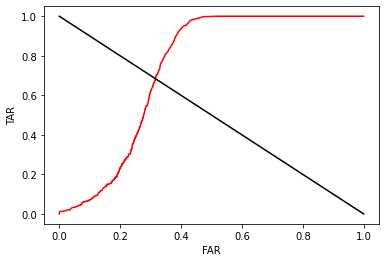

s043
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


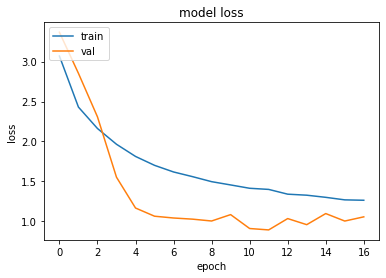

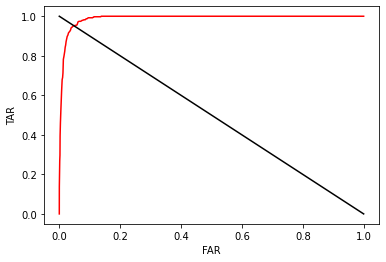

s044
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


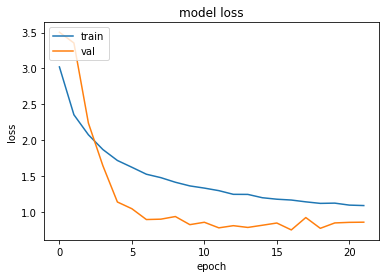

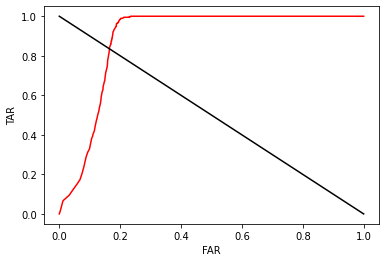

s046
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


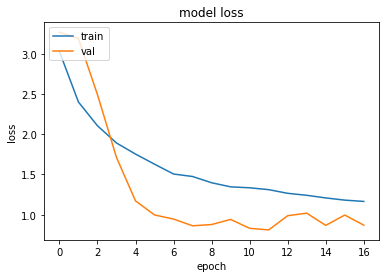

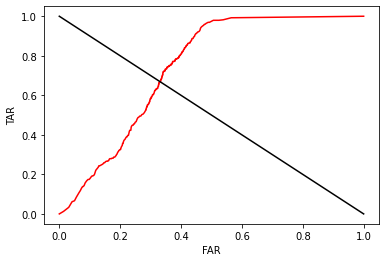

s047
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


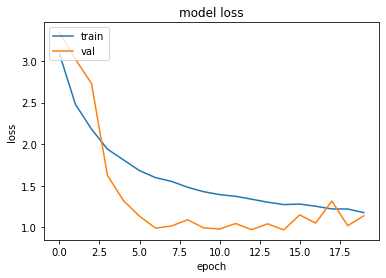

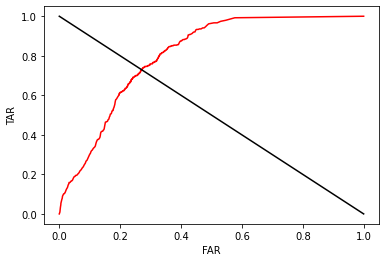

s048
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


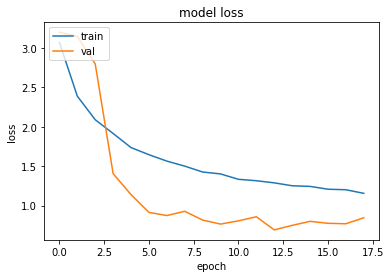

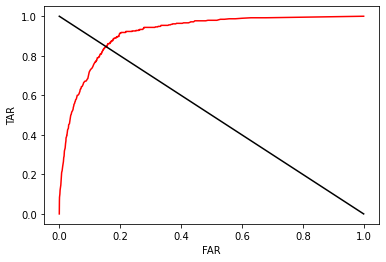

s049
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


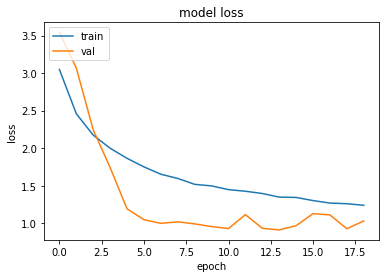

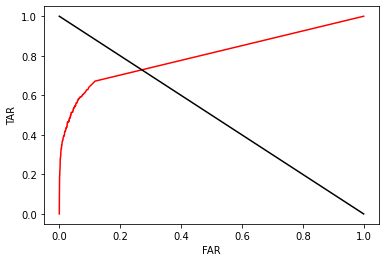

s050
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


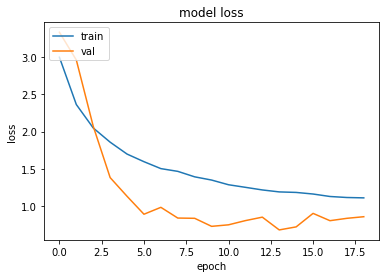

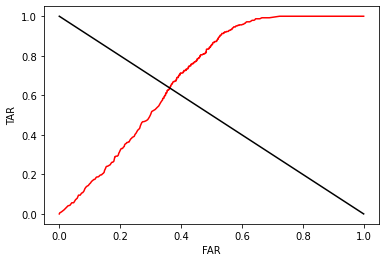

s051
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


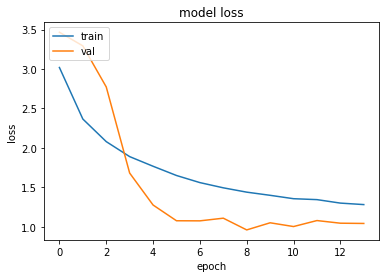

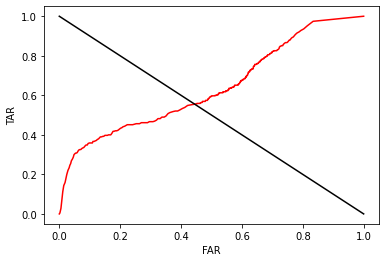

s052
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


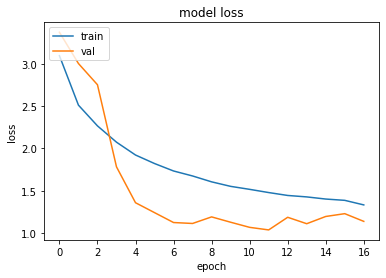

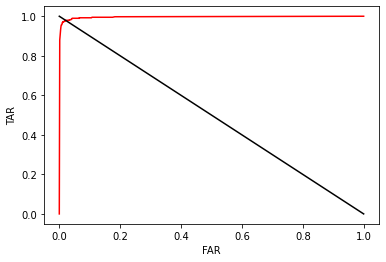

s053
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


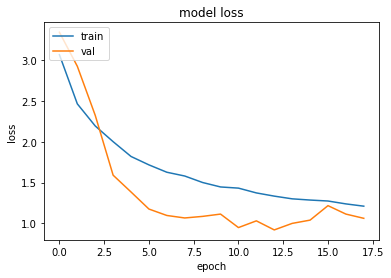

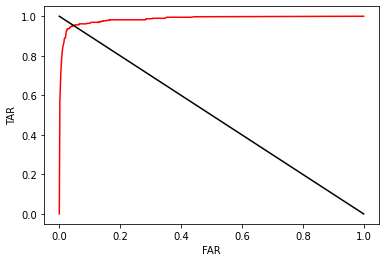

s054
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


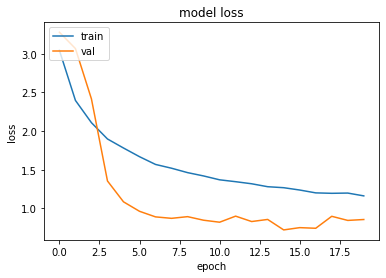

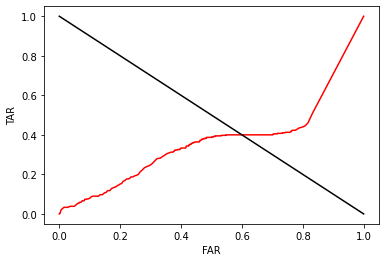

s055
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


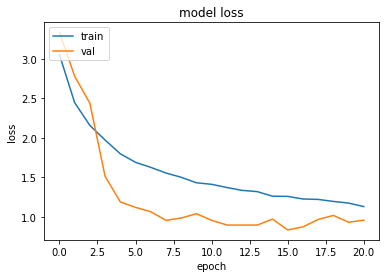

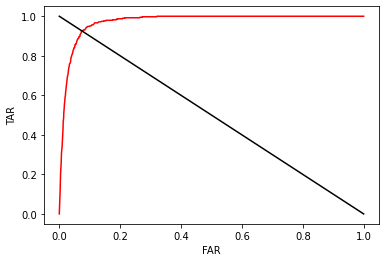

s056
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


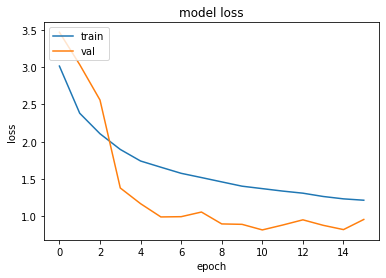

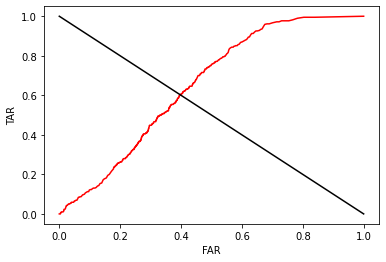

s057
initial_train_data.shape (13200, 21)
retrain_data.shape (26210, 21)
test_data.shape (7190, 21)
X_train.shape (13200, 9, 812)
Y_train_encoded.shape (13200, 33)


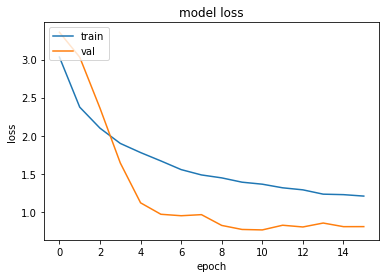

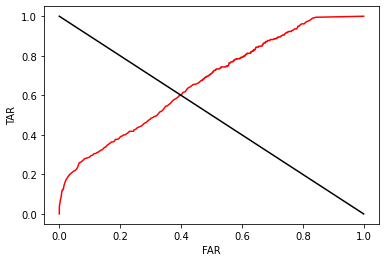

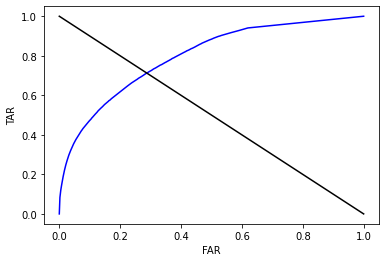

0.7125188536953243 TAR and 0.2874942329873126 FAR achieved at threshold: 0.0402


In [ ]:
# first figure out the optimal threshold

thresholds = np.concatenate([np.linspace(0, 0.01, 1001), np.linspace(0.01, 0.05, 101), np.linspace(0.05, 0.1, 101), np.linspace(0.1, 1, 101)]) #np.linspace(0, 1, 1001)
TAR_progression, FAR_progression = np.zeros(len(thresholds)), np.zeros(len(thresholds))
for individual in individuals: # 51 individuals total
  print(individual)
  tmp_TAR_progression, tmp_FAR_progression = test_lstm_on_user(individual, thresholds, verbose=0)
  TAR_progression = TAR_progression + tmp_TAR_progression
  FAR_progression = FAR_progression + tmp_FAR_progression
  plt.plot(tmp_FAR_progression,
         tmp_TAR_progression,
         color="red")
  plt.xlabel("FAR")
  plt.ylabel("TAR")
  plt.plot(np.linspace(0, 1, 2), np.linspace(1, 0, 2), color = "black")
  plt.show()
TAR_progression = TAR_progression / len(individuals)
FAR_progression = FAR_progression / len(individuals)
plt.plot(FAR_progression,
         TAR_progression,
         color="blue")
plt.xlabel("FAR")
plt.ylabel("TAR")
plt.plot(np.linspace(0, 1, 2), np.linspace(1, 0, 2), color = "black")
plt.show()


best_index = np.argmin(abs(1 - (TAR_progression + FAR_progression)))
best_threshold = thresholds[best_index]
# Best Threshold(s): 0.0402
print("{} TAR and {} FAR achieved at threshold: {}".format(TAR_progression[best_index], FAR_progression[best_index], best_threshold))

In [ ]:
from keras.layers import BatchNormalization

# fit and evaluate an LSTM model
def generate_lstm_model(trainX, trainy, verbose=0):
  epochs, batch_size = 100, 64
  n_outputs = trainy.shape[1]
  callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
  model = Sequential()
  model.add(BatchNormalization(name="normalization_layer")) # each input becomes relative to other inputs of given batch
  model.add(LSTM(75, input_shape=(9,812), dropout = 0.3, recurrent_dropout=0.3, name="lstm_layer"))
  model.add(Dropout(0.3))
  model.add(Dense(150, activation='relu', name="dense_intermediate"))
  model.add(Dropout(0.3))
  model.add(Dense(n_outputs, activation='softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  # fit network
  history = model.fit(trainX, trainy, epochs=epochs, validation_split=0.2, batch_size=batch_size, callbacks=[callback], verbose=verbose)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  if verbose == 1:
    model.summary()
  return model

In [ ]:
from sklearn.manifold import TSNE
import umap

def plot_embeddings(results, labels):
  # TSNE
  tsne = TSNE()
  tsne_results = tsne.fit_transform(results)

  tsne_1 = tsne_results[:,0]
  tsne_2 = tsne_results[:,1]
  plt.figure(figsize=(16,10))
  plt.scatter(tsne_1, tsne_2, c = labels, cmap = "Set1")
  plt.title("TSNE of all users")
  plt.show()

In [ ]:
from keras.models import Model

def train_lstm(data, verbose):
  initial_train_data = data.copy()
  initial_train_data = initial_train_data.sample(frac=1, random_state = random_seed)
  initial_train_data.reset_index(inplace=True, drop=True)
  print(initial_train_data.shape)

  X_train = initial_train_data[initial_train_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train)
  Y_train_encoded = assign_names_to_numbers(initial_train_data["subject"].copy())
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  print("X_train.shape", X_train.shape)
  print("Y_train_encoded.shape", Y_train_encoded.shape)

  model = generate_lstm_model(X_train, Y_train_encoded, verbose)

  layer_name = "dense_intermediate"
  intermediate_layer_model = Model(inputs=model.input,
                                 outputs=model.get_layer(layer_name).output)
  intermediate_output = intermediate_layer_model.predict(X_train)

  print(intermediate_output.shape)
  print(Y_train_encoded.argmax(axis=1).shape)

  if verbose:
    plot_embeddings(intermediate_output, Y_train_encoded.argmax(axis=1))

  # At this point, we have a trained model for known users

  return model

(20400, 21)
X_train.shape (20400, 9, 812)
Y_train_encoded.shape (20400, 51)


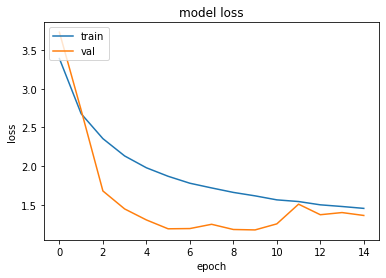

(20400, 150)
(20400,)


In [ ]:
# train model on all known data
model = train_lstm(data, verbose=0)

In [ ]:
# Learning better noise to add in each column
def find_column_stdvs(df, sigma_factor):
  sigma_dict = {}
  for column in df.columns[3:]:
    sigma_dict[column] = df[column].std() / sigma_factor
  return sigma_dict

In [ ]:
def retrain_lstm_on_user(data, real_user_df, attack_users_df, model, verbose):
  retrain_data = []
  test_data = []

  num_samples_to_train_on = 10
  true_user_name = real_user_df["subject"][0]

  true_retrain_data = real_user_df.loc[:num_samples_to_train_on - 1]
  retrain_data.append(true_retrain_data)
  sigma_factor = 10
  sigma_dict = find_column_stdvs(true_retrain_data, sigma_factor)
  for i in range(1999):
    # Adding noise when upsampling
    # creating a noise with the same dimension as the dataset (2,2) 
    for column in true_retrain_data.columns[3:]:
      upsampled = true_retrain_data.copy()
      noise = np.random.normal(0, sigma_dict[column], [len(upsampled)]) 
      upsampled[column] = upsampled[column] + noise
    retrain_data.append(upsampled)

  # Adding negative data to retrain set
  retrain_data.append(data.copy())

  # adding instances to test set
  test_data.append(real_user_df.loc[num_samples_to_train_on:].sample(frac=1, random_state = random_seed))
  test_data.append(attack_users_df)

  retrain_data = concat_and_randomize_data(retrain_data)
  print(retrain_data.shape)
  test_data = concat_and_randomize_data(test_data)
  print(test_data.shape)

  X_train = retrain_data[retrain_data.columns[3:]]
  X_train = convert_to_matrix_representation(X_train) 
  Y_train_encoded = binary_classification(retrain_data["subject"].copy(), true_user_name)
  Y_train_encoded = Y_train_encoded.to_numpy()
  Y_train_encoded = to_categorical(Y_train_encoded)

  new_model_layers = model.layers[:-1]
  for layer in new_model_layers:
    layer.trainable = False
  new_model = Sequential(new_model_layers)
  new_model.add(Dense(2, activation='softmax'))

  new_model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

  new_model.fit(X_train, Y_train_encoded, 
            batch_size=32, epochs=10, verbose=verbose, validation_split=0.2)
  if verbose == 1:
    new_model.summary()

  if verbose:
    # We have now retrained the model for the new user against fake attempts
    input_layer_name = "normalization_layer"
    output_layer_name = "dense_intermediate"
    intermediate_layer_model = Model(inputs=new_model.get_layer(input_layer_name).input,
                                  outputs=new_model.get_layer(output_layer_name).output)
    intermediate_output = intermediate_layer_model.predict(X_train)

    print(intermediate_output.shape)
    print(Y_train_encoded.argmax(axis=1).shape)

    plot_embeddings(intermediate_output, Y_train_encoded.argmax(axis=1))

  return new_model, test_data, true_user_name

In [ ]:
def test_model(test_data, true_user_name, new_model, opt_threshold, verbose=0):
  X_test = test_data[test_data.columns[3:]]
  X_test = convert_to_matrix_representation(X_test) 
  Y_test_encoded = binary_classification(test_data["subject"].copy(), true_user_name)
  Y_test_encoded = Y_test_encoded.to_numpy()
  Y_test_encoded = to_categorical(Y_test_encoded)

  reals = np.argmax(Y_test_encoded, axis=1)
  predictions = new_model.predict(X_test)

  if verbose:
    input_layer_name = "normalization_layer"
    output_layer_name = "dense_intermediate"
    intermediate_layer_model = Model(inputs=new_model.get_layer(input_layer_name).input,
                                  outputs=new_model.get_layer(output_layer_name).output)
    intermediate_output = intermediate_layer_model.predict(X_test)

    print(intermediate_output.shape)
    print(Y_test_encoded.argmax(axis=1).shape)

    plot_embeddings(intermediate_output, Y_test_encoded.argmax(axis=1))

  prediction_values = np.array([1 if predictions[i][1] > opt_threshold else 0 for i in range(len(predictions))])
  conf_matrix = confusion_matrix(reals, prediction_values)
  TAR = (conf_matrix[1][1] / sum(conf_matrix[1]))
  FAR = (conf_matrix[0][1] / sum(conf_matrix[0]))
  return TAR, FAR

In [ ]:
all_TAR = []
all_FAR = []

opt_threshold = 0.0402

for user in survey_data["subject"].unique():
  if (survey_data["subject"] == user).sum() != 30:
    print("user did not have enough data. Only {} password instances".format((survey_data["subject"] == user).sum()))
    continue
  print(user)
  retrain_true_df = survey_data.copy()
  retrain_true_df = retrain_true_df[retrain_true_df["subject"] == user]
  retrain_true_df.reset_index(inplace=True, drop=True)

  retrain_attacks_df = survey_data.copy()
  retrain_attacks_df = retrain_attacks_df[retrain_attacks_df["subject"] != user]
  retrain_attacks_df.reset_index(inplace=True, drop=True)

  # add/retrain new layers to model
  new_model, test_data, true_user_name = retrain_lstm_on_user(data, retrain_true_df, retrain_attacks_df, model, verbose=0)
  print("Done training. Now testing...")
  TAR, FAR = test_model(test_data, true_user_name, new_model, opt_threshold, verbose=0)
  print("{} TAR and {} FAR achieved at threshold: {}".format(TAR, FAR, opt_threshold))
  all_TAR.append(TAR)
  all_FAR.append(FAR)

print("Overall TAR: ", np.array(all_TAR).mean())
print("Overall FAR: ", np.array(all_FAR).mean())

02tnxibyzlsiq0jmrji2buf
(40400, 21)
(1375, 21)
Done training. Now testing...
1.0 TAR and 0.18892988929889298 FAR achieved at threshold: 0.0402
1cn637ga0f42y2fsupseta
(40400, 21)
(1375, 21)
Done training. Now testing...
1.0 TAR and 0.053136531365313655 FAR achieved at threshold: 0.0402
1n8y63yjauucp8tj8y5xii
(40400, 21)
(1375, 21)
Done training. Now testing...
1.0 TAR and 0.41254612546125463 FAR achieved at threshold: 0.0402
2we683nw7htwre7a1p7yyj
(40400, 21)
(1375, 21)
Done training. Now testing...
0.95 TAR and 0.12767527675276752 FAR achieved at threshold: 0.0402
30x30oghf4t1oy454p3t3x
(40400, 21)
(1375, 21)
Done training. Now testing...
1.0 TAR and 0.2959409594095941 FAR achieved at threshold: 0.0402
3ehmgitoqtspykpvximl5i
(40400, 21)
(1375, 21)
Done training. Now testing...
1.0 TAR and 0.3202952029520295 FAR achieved at threshold: 0.0402
4g0rjj7gw27cnkage5k4sf
(40400, 21)
(1375, 21)
Done training. Now testing...
1.0 TAR and 0.23321033210332104 FAR achieved at threshold: 0.0402
4ob7t